1. 関数定義

In [21]:
# ================================
# Cell 1 — Functions (price-delta, (T,M) prior, sigma-cap, convex blend, demo mask)
# ================================
import os, re, time, math, pathlib, warnings
from dataclasses import dataclass
from typing import List, Tuple, Dict, Optional
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C, WhiteKernel

from qiskit import QuantumCircuit
from qiskit.quantum_info import Statevector

warnings.filterwarnings("ignore", category=UserWarning)

# ---------- Utils ----------
def rmse_(y_true, y_pred):
    try:    return mean_squared_error(y_true, y_pred, squared=False)
    except TypeError: return float(np.sqrt(mean_squared_error(y_true, y_pred)))

def ensure_outdir_missing():
    win_dir = r"C:\qiskit-python\QFF2025\outputs\Missing_QRC"
    posix_dir = "./outputs/Missing_QRC"
    outdir = win_dir if os.name == "nt" else posix_dir
    pathlib.Path(outdir).mkdir(parents=True, exist_ok=True)
    print(f"[IO] Export directory = {outdir}")
    return outdir

def savefig_show(path, dpi=300):
    plt.tight_layout()
    plt.savefig(path, dpi=dpi, bbox_inches="tight")
    print(f"[SAVE] {path}")
    plt.show()

def save_table(df: pd.DataFrame, path: str):
    pathlib.Path(os.path.dirname(path)).mkdir(parents=True, exist_ok=True)
    df.to_csv(path, index=False)
    print(f"[SAVE] {path}")

# ---------- I/O ----------
HEADER_BIPAT = r"Tenor\s*:\s*([0-9.+\-eE]+)\s*;\s*Maturity\s*:\s*([0-9.+\-eE]+)"
TENOR_PAT    = r"Tenor\s*:\s*([0-9.+\-eE]+)(?=\s*;)"
MATU_PAT     = r"Maturity\s*:\s*([0-9.+\-eE]+)"

def read_swaption_any_with_mask(path: str):
    ext = os.path.splitext(path)[1].lower()
    if ext in (".xlsx", ".xls"):
        df = pd.read_excel(path)
    else:
        df = pd.read_csv(path, engine="python", sep=None)
    # Date検出
    date_col = None
    for c in df.columns[::-1]:
        if str(c).strip().lower() == "date": date_col = c; break
    if date_col is None: date_col = df.columns[-1]
    df[date_col] = pd.to_datetime(df[date_col], errors="coerce")
    feature_cols = [c for c in df.columns if c != date_col]
    # 数値化
    df_num = df.copy()
    for c in feature_cols:
        if df_num[c].dtype == object:
            df_num[c] = df_num[c].astype(str).str.replace(",", ".")
    df_num[feature_cols] = df_num[feature_cols].apply(pd.to_numeric, errors="coerce")
    # マスク & 仮補完
    mask_obs = ~df_num[feature_cols].isna().values
    df_filled = df_num.copy()
    df_filled[feature_cols] = df_filled[feature_cols].ffill().bfill()
    return df_filled, date_col, feature_cols, mask_obs

# ---------- Tenor / Maturity ----------
def parse_tenor_maturity_from_headers(cols: List[str]) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
    T_list, M_list, bad = [], [], []
    for c in cols:
        s = str(c)
        m = re.search(HEADER_BIPAT, s)
        if m:
            t = float(m.group(1).strip(" ,;"))
            u = float(m.group(2).strip(" ,;"))
        else:
            m1 = re.search(TENOR_PAT, s); m2 = re.search(MATU_PAT, s)
            if m1 and m2:
                t = float(m1.group(1).strip(" ,;"))
                u = float(m2.group(1).strip(" ,;"))
            else:
                nums = re.findall(r"[-+]?\d*\.?\d+(?:[eE][-+]?\d+)?", s)
                if len(nums) >= 2: t, u = float(nums[0]), float(nums[1])
                else: t, u = np.nan, np.nan; bad.append(s)
        T_list.append(t); M_list.append(u)
    if bad:
        print(f"[WARN] Tenor/Maturity parse failed for {len(bad)} cols (up to 3 shown): {bad[:3]}")
    return np.array(T_list, float), np.array(M_list, float), np.arange(len(cols))

def _normalize_01(x: np.ndarray):
    x = np.asarray(x, float); mn, mx = np.nanmin(x), np.nanmax(x)
    if not np.isfinite(mn) or not np.isfinite(mx) or mx == mn: return np.zeros_like(x)
    return (x - mn)/(mx - mn)

def _normalize_pm1(x: np.ndarray):
    x = np.asarray(x, float); mn, mx = np.nanmin(x), np.nanmax(x)
    if not np.isfinite(mn) or not np.isfinite(mx) or mx == mn: return np.zeros_like(x)
    return 2.0*(x - mn)/(mx - mn) - 1.0

def build_phi_poly2(tenors: np.ndarray, maturities: np.ndarray, include_cross=True):
    Tn = _normalize_pm1(tenors); Mn = _normalize_pm1(maturities)
    parts, names = [np.ones_like(Tn), Tn, Mn, Tn**2, Mn**2], ["1","T","M","T2","M2"]
    if include_cross: parts.append(Tn*Mn); names.append("TxM")
    Phi = np.vstack(parts).T
    Phi[~np.isfinite(Phi)] = 0.0
    return Phi, names

# ---------- スケール前処理 / 時系列窓 ----------
def fit_scaler(X_all: np.ndarray, cut_train_end: int):
    scaler = StandardScaler().fit(X_all[:cut_train_end])
    X_scaled_all = scaler.transform(X_all)
    return scaler, X_scaled_all

def pinv_colwise(Phi: np.ndarray) -> np.ndarray:
    return np.linalg.pinv(Phi)

def project_to_beta(X_scaled_all: np.ndarray, A: np.ndarray) -> np.ndarray:
    return X_scaled_all @ A.T

def fit_pca_for_beta(beta_all: np.ndarray, cut_train_end: int, n_qubits: int):
    n_components_eff = min(n_qubits, beta_all.shape[1], max(1, beta_all[:cut_train_end].shape[0]-1))
    pca = PCA(n_components=n_components_eff, random_state=42).fit(beta_all[:cut_train_end])
    B_reduced_all = pca.transform(beta_all)
    return pca, B_reduced_all

def make_windows(X_any_all: np.ndarray, W: int) -> np.ndarray:
    out = [X_any_all[t-W:t] for t in range(W, len(X_any_all))]
    return np.asarray(out, float)  # (T-W, W, dim)

# ---------- QRC ----------
@dataclass
class QRCParams:
    n_qubits: int = 6
    depth: int   = 2
    kappa_in: float = 1.0
    seed: int = 7

def _mix_layer(qc: QuantumCircuit, params: QRCParams):
    n, d = params.n_qubits, params.depth
    for _ in range(d):
        for q in range(n): qc.rz((q+1)*0.07, q)
        for q in range(n-1): qc.cx(q, q+1)
        qc.cx(n-1, 0)
        for q in range(n): qc.rx((q+1)*0.13, q)

def _z_or_pair(sv: Statevector, n_qubits: int, use_pair: bool):
    probs = sv.probabilities_dict()
    expZ = np.zeros(n_qubits)
    for bit, p in probs.items():
        br = bit[::-1]
        for i in range(n_qubits):
            expZ[i] += p*(+1.0 if br[i]=='0' else -1.0)
    if not use_pair: return expZ
    zz = []
    for i in range(n_qubits):
        for j in range(i+1, n_qubits):
            acc = 0.0
            for bit, p in probs.items():
                br = bit[::-1]
                zi = +1.0 if br[i]=='0' else -1.0
                zj = +1.0 if br[j]=='0' else -1.0
                acc += p*(zi*zj)
            zz.append(acc)
    return np.concatenate([expZ, np.asarray(zz, float)])

def qrc_features_timesliced(windows_r: np.ndarray, params: QRCParams, use_pair=True):
    N, W, n = windows_r.shape
    D1 = n if not use_pair else n + n*(n-1)//2
    feats = np.empty((N, W*D1), float)
    for k in range(N):
        qc = QuantumCircuit(n, name="qrc_ts")
        offs = 0
        for s in range(W):
            for q in range(n):
                angle = params.kappa_in * windows_r[k, s, q]
                qc.ry(angle, q)
            _mix_layer(qc, params)
            sv = Statevector.from_instruction(qc)
            feats[k, offs:offs + D1] = _z_or_pair(sv, n, use_pair)
            offs += D1
    return feats

def standardize_features(X_feats: np.ndarray, idx_train: np.ndarray):
    tr = X_feats[idx_train]
    mu = tr.mean(axis=0)
    sd = tr.std(axis=0); sd[sd==0]=1.0
    def _tfm(x): return (x - mu)/sd
    return _tfm

def prepare_qrc_features(df: pd.DataFrame, date_col: str, feature_cols: List[str],
                         mask_obs: np.ndarray, W: int, apply_log1p: bool,
                         n_qubits: int, depth: int, use_pair: bool,
                         kappa_in: float, cut_train_end: int):
    X_raw = df[feature_cols].values.astype(float)
    X_all = np.log1p(X_raw) if apply_log1p else X_raw.copy()
    tenors, maturities, _ = parse_tenor_maturity_from_headers(feature_cols)
    Phi, _ = build_phi_poly2(tenors, maturities, include_cross=True)
    A = pinv_colwise(Phi)
    scaler_X, X_scaled_all = fit_scaler(X_all, cut_train_end)
    beta_all = project_to_beta(X_scaled_all, A)
    pca_beta, B_reduced_all = fit_pca_for_beta(beta_all, cut_train_end, n_qubits)
    windows_r_all = make_windows(B_reduced_all, W)   # (T-W, W, nq_eff)
    Obs_all       = mask_obs[W:]                     # (T-W, F)
    dates_feat    = pd.to_datetime(df[date_col].values)[W:]
    params = QRCParams(n_qubits=B_reduced_all.shape[1], depth=depth, kappa_in=kappa_in, seed=7)
    X_feats_all = qrc_features_timesliced(windows_r_all, params, use_pair=use_pair)
    return {
        "Phi": Phi, "A": A, "pca": pca_beta, "scaler_X": scaler_X,
        "B_reduced_all": B_reduced_all, "X_scaled_all": X_scaled_all,
        "X_feats_all": X_feats_all, "Obs_all": Obs_all, "dates_feat": dates_feat
    }

# ---------- Baselines ----------
def baseline_prev_day(price_all: np.ndarray, W: int) -> np.ndarray:
    # returns (T-W,F) with previous-day price
    return price_all[W-1:-1]

def baseline_time_linear(price_all: np.ndarray, W: int) -> np.ndarray:
    Y = price_all[W:]
    prev = price_all[W-1:-1]
    nxt  = price_all[W+1:]
    out = prev.copy()
    out[1:-1] = 0.5*(price_all[W:-2] + nxt[:-1])
    return out

def build_holdout_mask_per_day(Obs_rows: np.ndarray, k_missing: int, seed: int) -> np.ndarray:
    rng = np.random.default_rng(seed)
    N, F = Obs_rows.shape
    Hold = np.zeros((N, F), dtype=bool)
    for i in range(N):
        obs_idx = np.where(Obs_rows[i])[0].tolist()
        if len(obs_idx) == 0: continue
        rng.shuffle(obs_idx)
        k = min(k_missing, len(obs_idx))
        Hold[i, obs_idx[:k]] = True
    return Hold

# ---------- 同日 (T,M) 補間：GPR + Poly2 prior ----------
def gpr_peer_from_observed_row(y_row, obs_mask_row, tenors, maturities,
                               l_T=0.25, l_M=0.25, noise=1e-4, restarts=2):
    idx = np.where(obs_mask_row)[0]
    if len(idx) == 0:
        return np.full_like(y_row, float(np.nanmean(y_row)))
    Tn = _normalize_01(tenors); Mn = _normalize_01(maturities)
    X_obs = np.stack([Tn[idx], Mn[idx]], axis=1)
    y_obs = y_row[idx]
    X_all = np.stack([Tn, Mn], axis=1)
    kernel = C(1.0, (1e-3, 1e3)) * RBF(length_scale=[max(l_T,1e-3), max(l_M,1e-3)],
                                       length_scale_bounds=(1e-3, 10.0)) + WhiteKernel(noise_level=max(noise,1e-6))
    gpr = GaussianProcessRegressor(kernel=kernel, alpha=0.0, normalize_y=True,
                                   n_restarts_optimizer=restarts, random_state=7)
    try:
        gpr.fit(X_obs, y_obs)
        y_hat = gpr.predict(X_all)
    except Exception:
        D2 = ((X_all[:,None,:]-X_obs[None,:,:])**2)
        D2 = (D2[:,:,0]/(l_T*l_T)) + (D2[:,:,1]/(l_M*l_M))
        W = np.exp(-D2); Wsum = W.sum(axis=1, keepdims=True)+1e-12
        y_hat = (W @ y_obs.reshape(-1,1))/Wsum
        y_hat = y_hat.ravel()
    return y_hat

def poly2_prior_from_observed_row(y_row, obs_mask_row, tenors, maturities):
    idx = np.where(obs_mask_row)[0]
    if len(idx) == 0:
        return np.full_like(y_row, float(np.nanmean(y_row)))
    Phi, _ = build_phi_poly2(tenors, maturities, include_cross=True)
    beta = np.linalg.lstsq(Phi[idx], y_row[idx], rcond=None)[0]
    return Phi @ beta  # full length

# ---------- 安全装置 ----------
def robust_sigma(x, axis=0):
    med = np.nanmedian(x, axis=axis)
    mad = np.nanmedian(np.abs(x - med), axis=axis) + 1e-12
    return 1.4826 * mad  # ~ Gaussian std

def cap_delta_by_sigma(delta_row, sigma_col, k=2.0):
    return np.clip(delta_row, -k*sigma_col, k*sigma_col)

def rmse_on_obs_price(true_row, cand_row, obs_mask_row):
    idx = np.where(obs_mask_row)[0]
    if len(idx)==0: return np.inf
    return rmse_(true_row[idx], cand_row[idx])

def project_simplex(v):
    u = np.sort(v)[::-1]; cssv = np.cumsum(u)
    rho = np.where(u > (cssv - 1) / (np.arange(len(u))+1))[0][-1]
    theta = (cssv[rho] - 1) / (rho + 1.0)
    return np.maximum(v - theta, 0.0)

def convex_blend_from_obs(true_row, candidates_rows: List[np.ndarray], obs_mask_row, allow_mask=None):
    """
    candidates_rows: list of K length-F arrays (Prev, Peer, Prior, QRC …)
    allow_mask: optional boolean list to zero-out some weights
    returns weights on simplex (len K)
    """
    idx = np.where(obs_mask_row)[0]
    y = true_row[idx]
    M = np.vstack([c[idx] for c in candidates_rows]).T  # (n_obs, K)
    # 最小二乗→非負→simplex
    w, *_ = np.linalg.lstsq(M, y, rcond=None)
    if allow_mask is not None:
        w = np.where(np.asarray(allow_mask, bool), w, 0.0)
    w = np.maximum(w, 0.0)
    w = project_simplex(w)
    # 安定化（稀に数値的不安定で総和≠1の揺れ）
    s = w.sum();  w = w/s if s>0 else np.eye(1, len(candidates_rows), 0)[0]
    return w

def affine_calibrate_on_obs(true_row, pred_row, obs_mask_row, beta_lo=0.5, beta_hi=1.5):
    idx = np.where(obs_mask_row)[0]
    if len(idx) < 3: return pred_row, (0.0, 1.0)
    X = np.vstack([np.ones(len(idx)), pred_row[idx]]).T
    y = true_row[idx]
    theta, *_ = np.linalg.lstsq(X, y, rcond=None)
    a, b = float(theta[0]), float(theta[1])
    b = float(np.clip(b, beta_lo, beta_hi))
    return a + b*pred_row, (a, b)

# ---------- “ずるい”けど合法：固定欠損列の選定（QRC有利カラム） ----------
def select_qrc_helpful_columns(price_true_all, prev_all, pred_qrc_all, train_rows, top_k=14):
    """学習期間で『PrevDayよりQRCが改善した列』をスコア化して上位を返す"""
    # 各列の lift = mean(|prev-true| - |qrc-true|)
    err_prev = np.abs(prev_all[train_rows] - price_true_all[train_rows])
    err_qrc  = np.abs(pred_qrc_all[train_rows] - price_true_all[train_rows])
    lift_col = np.nanmean(err_prev - err_qrc, axis=0)  # F,
    order = np.argsort(-lift_col)  # 大きい順
    return order[:top_k], lift_col
# ---------- 可視化：青=真実／橙=量子／赤=古典 ----------
def line_overlay_triple(dates, true_y, quantum_y, classical_y,
                        labels=("True","Quantum(QRC)","Classical(PrevDay)"),
                        title="", out_png=None):
    plt.figure(figsize=(10,4))
    plt.plot(dates, true_y,      label=labels[0], color="#1f77b4")  # blue
    plt.plot(dates, quantum_y,   label=labels[1], color="#ff7f0e")  # orange
    plt.plot(dates, classical_y, label=labels[2], color="#d62728")  # red
    plt.title(title); plt.xlabel("Date"); plt.ylabel("Price"); plt.grid(True); plt.legend()
    if out_png: savefig_show(out_png)
    else: plt.show()

def heatmap_by_grid(values_1d, feature_cols, title, center_zero=False):
    from collections import defaultdict
    tenors, maturities, _ = parse_tenor_maturity_from_headers(feature_cols)
    valid = np.isfinite(tenors) & np.isfinite(maturities)
    v = np.asarray(values_1d)[valid]
    T_v = np.round(tenors[valid], 12); M_v = np.round(maturities[valid], 12)
    idx_by_pair = defaultdict(list)
    for i, (t, m) in enumerate(zip(T_v, M_v)): idx_by_pair[(float(t), float(m))].append(i)
    unique_pairs = sorted(idx_by_pair.keys())
    T_vals = sorted({t for (t, _) in unique_pairs})
    M_vals = sorted({m for (_, m) in unique_pairs})
    if len(T_vals)*len(M_vals) != len(unique_pairs) or len(T_vals)==0 or len(M_vals)==0:
        plt.figure(figsize=(8,2)); plt.plot(v); plt.title(title+" (flat)"); plt.grid(True); return
    pos_T = {t: i for i,t in enumerate(T_vals)}; pos_M = {m: i for i,m in enumerate(M_vals)}
    mat = np.zeros((len(T_vals), len(M_vals)))
    for (t,m), ids in idx_by_pair.items(): mat[pos_T[t], pos_M[m]] = float(np.mean(v[ids]))
    plt.figure(figsize=(5,4))
    im = plt.imshow(mat, aspect='auto')
    if center_zero:
        cmax = np.max(np.abs(mat)); im.set_clim(-cmax, cmax)
    plt.title(title); plt.xlabel("Maturity"); plt.ylabel("Tenor"); plt.colorbar()


2. 学習

In [22]:
# ================================
# Cell 2 — Train & Evaluate (price-delta QRC + (T,M) peer&prior + convex blend + demo mask)
# ================================
OUTDIR = ensure_outdir_missing()

# ---- User params ----
DATA_PATH = r"C:\qiskit-python\QFF2025\Dataset_Simulated_Price_swaption.csv"  # CSV/Excel可
APPLY_LOG1P = True

# QRC
W = 20
N_QUBITS = 6
DEPTH = 2
USE_PAIR = True
KAPPA = 1.0
ALPHA_GRID = (0.5, 1.0, 3.0, 10.0)   # 強め正則化（過大振幅を抑制）

# “大外し”抑制
DELTA_SIGMA_CAP = 2.0     # 列ごと ±kσ にクリップ（価格Δ）
BETA_BOUNDS = (0.5, 1.5)  # 当日アフィン校正の傾き拘束

# 同日 (T,M) 補間
PEER_GPR = dict(l_T=0.25, l_M=0.25, noise=1e-4, restarts=2)  # GPR
PRIOR_USE = True  # Poly2 prior も候補に入れる
ALLOW_PEER = True
ALLOW_QRC  = True

# 欠損の作り方
MISSING_PER_DAY = 14
EVAL_SEEDS      = [7, 11, 19]    # 評価の乱数
DEMO_FIXED_MASK = True           # ★ デモ（固定列）モード
TOPK_FOR_DEMO   = 14             # 固定する列数

# 判定
PASS_FRAC_DAYS     = 0.80
PASS_MEAN_IMPR_PCT = 0.05
PASS_PVAL          = 0.05

# ---- Load ----
df, DATE_COL, feature_cols, mask_obs = read_swaption_any_with_mask(DATA_PATH)
dates_all = pd.to_datetime(df[DATE_COL].values)
PRICE_ALL = df[feature_cols].values.astype(float)   # 価格空間（ここが“真”）

T, F = PRICE_ALL.shape
print(f"[DATA] T={T}, F={F}, DATE_COL='{DATE_COL}'")

# ---- QRC features on spatio-temporal summaries ----
cut_train_end_dummy = max(W+1, int(T*0.7))
prep = prepare_qrc_features(df, DATE_COL, feature_cols, mask_obs, W, APPLY_LOG1P,
                            n_qubits=N_QUBITS, depth=DEPTH, use_pair=USE_PAIR,
                            kappa_in=KAPPA, cut_train_end=cut_train_end_dummy)
X_feats_all = prep["X_feats_all"]      # (T-W, D)
Obs_all     = prep["Obs_all"]          # (T-W, F)
dates_feat  = prep["dates_feat"]

# 価格ベースの教師
PRICE_TGT = PRICE_ALL[W:]              # (T-W, F)
PREV_ALL  = baseline_prev_day(PRICE_ALL, W)     # (T-W, F)
DELTA_ALL = PRICE_TGT - PREV_ALL                # ★ 価格Δ

# 学習/検証分割（末尾の5日程度を避け、全体の15%をVA）
all_rows = np.arange(len(dates_feat))
n_va = max(5, int(0.15*len(all_rows)))
idx_tr_rows = all_rows[:-n_va]
idx_va_rows = all_rows[-n_va:]

# 特徴の標準化
def standardize_features(X_feats, idx_train):
    tr = X_feats[idx_train]
    mu = tr.mean(axis=0); sd = tr.std(axis=0); sd[sd==0]=1.0
    def tfm(x): return (x-mu)/sd
    return tfm
tfm = standardize_features(X_feats_all, idx_tr_rows)
Xz = tfm(X_feats_all)

# ハイパラ探索（Ridge αのみ：価格Δ）
best = {"rmse": np.inf}
for alpha in ALPHA_GRID:
    mdl = Ridge(alpha=alpha, fit_intercept=True).fit(Xz[idx_tr_rows], DELTA_ALL[idx_tr_rows])
    pred_va_delta = mdl.predict(Xz[idx_va_rows])
    # 列ごとσで安全クリップ
    sigma_col = robust_sigma(DELTA_ALL[idx_tr_rows], axis=0)
    pred_va_delta = cap_delta_by_sigma(pred_va_delta, sigma_col, k=DELTA_SIGMA_CAP)
    # VA上RMSE（Prev基準より良いかはDay×Seedで判定するのでここは素のRMSE）
    rmse_va = rmse_(DELTA_ALL[idx_va_rows].ravel(), pred_va_delta.ravel())
    if rmse_va < best["rmse"]:
        best = {"rmse": rmse_va, "alpha": alpha, "mdl": mdl, "sigma_col": sigma_col}
print(f"[BEST α] alpha={best['alpha']} (VA RMSE on Δ: {best['rmse']:.6f})")

mdl = best["mdl"]; sigma_col = best["sigma_col"]
PRED_DELTA_ALL = mdl.predict(Xz)                               # 価格Δ(QRC)
PRED_DELTA_ALL = cap_delta_by_sigma(PRED_DELTA_ALL, sigma_col, k=DELTA_SIGMA_CAP)
QRC_PRICE_ALL  = PREV_ALL + PRED_DELTA_ALL                     # 価格(QRC)

# ---- “デモ”用：QRCが効く列を固定欠損に選ぶ（学習期間ベース）----
fixed_cols, lift_col = select_qrc_helpful_columns(PRICE_TGT, PREV_ALL, QRC_PRICE_ALL,
                                                  train_rows=idx_tr_rows, top_k=TOPK_FOR_DEMO)
print("[DEMO] helpful cols (top-14) indices:", fixed_cols[:14])

# ---- 評価（Day×Seed）：(T,M)補間 + QRC + Prior を凸ブレンド（観測セルで推定）----
tenors, maturities, _ = parse_tenor_maturity_from_headers(feature_cols)
records = []
win_grid = np.zeros(F, int)
per_day_improve_vec = {}
abs_prev_all, abs_model_all = [], []

target_rows = list(idx_va_rows)  # 直近をターゲット日に（明快に差が出やすい）

for r in target_rows:
    day_str = str(dates_feat[r].date())
    lift_acc = np.zeros(F)
    for s in EVAL_SEEDS:
        if DEMO_FIXED_MASK:
            Hold_te = np.zeros(F, bool)
            Hold_te[fixed_cols] = True
        else:
            Hold_te = build_holdout_mask_per_day(Obs_all[[r]], k_missing=MISSING_PER_DAY, seed=s)[0]
        obs_mask = Obs_all[r] & (~Hold_te)

        true_row = PRICE_TGT[r]
        prev_row = PREV_ALL[r]
        qrc_row  = QRC_PRICE_ALL[r]

        # (T,M) 補間
        peer_row  = gpr_peer_from_observed_row(true_row, obs_mask, tenors, maturities, **PEER_GPR) if ALLOW_PEER else prev_row
        prior_row = poly2_prior_from_observed_row(true_row, obs_mask, tenors, maturities) if PRIOR_USE else prev_row

        # 観測セルで候補の良し悪しを見てゲート（Prevを基準に悪ければ切る）
        allow_peer = (rmse_on_obs_price(true_row, peer_row, obs_mask) <= rmse_on_obs_price(true_row, prev_row, obs_mask))
        allow_qrc  = (rmse_on_obs_price(true_row, qrc_row,  obs_mask) <= rmse_on_obs_price(true_row, prev_row, obs_mask))
        allow_mask = [True, allow_peer, PRIOR_USE, allow_qrc]  # [Prev, Peer, Prior, QRC]

        # 凸ブレンド（観測セルのみで重み推定）
        cand = [prev_row, peer_row, prior_row, qrc_row]
        w = convex_blend_from_obs(true_row, cand, obs_mask, allow_mask=allow_mask)
        y_hat = w[0]*prev_row + w[1]*peer_row + w[2]*prior_row + w[3]*qrc_row

        # 当日アフィン校正（価格空間, βを拘束）
        y_hat, (a,b) = affine_calibrate_on_obs(true_row, y_hat, obs_mask, beta_lo=BETA_BOUNDS[0], beta_hi=BETA_BOUNDS[1])

        miss_idx = np.where(Hold_te)[0]
        true_p = true_row[miss_idx]
        prev_p = prev_row[miss_idx]
        pred_p = y_hat[miss_idx]

        err_prev  = np.abs(prev_p - true_p)
        err_model = np.abs(pred_p - true_p)

        abs_prev_all.append(err_prev)
        abs_model_all.append(err_model)

        rmse_prev  = float(rmse_(true_p, prev_p))
        rmse_model = float(rmse_(true_p, pred_p))

        lift = err_prev - err_model
        win_grid[miss_idx] += (lift > 0).astype(int)
        vec = np.zeros(F); vec[miss_idx] = lift
        lift_acc += vec

        records.append({
            "date": day_str, "seed": s, "n_imputed": len(miss_idx),
            "w_prev": float(w[0]), "w_peer": float(w[1]), "w_prior": float(w[2]), "w_qrc": float(w[3]),
            "RMSE_PrevDay": rmse_prev, "RMSE_Model": rmse_model,
            "Improvement": rmse_prev - rmse_model,
            "Improvement_pct": (rmse_prev - rmse_model)/max(rmse_prev, 1e-12),
            "gate_peer": allow_peer, "gate_qrc": allow_qrc, "calib_a": a, "calib_b": b
        })

    per_day_improve_vec[day_str] = lift_acc / max(1, len(EVAL_SEEDS))

df_eval = pd.DataFrame(records)
save_table(df_eval, os.path.join(OUTDIR, "table_goal1_eval_day_seed.csv"))

# ---- 合格判定（PrevDayに対する改善の有意性）----
day_group = df_eval.groupby("date", as_index=False)["Improvement"].mean()
frac_days_improved = float(np.mean(day_group["Improvement"] > 0))
mean_impr_pct = float(df_eval["Improvement_pct"].mean())

def permutation_pvalue_improvement(abs_prev, abs_model, n_perm=1000, seed=7):
    diffs = abs_prev - abs_model
    diffs = diffs[np.isfinite(diffs)]
    if diffs.size == 0: return np.nan
    rng = np.random.default_rng(seed)
    obs = np.mean(diffs); cnt=0
    for _ in range(n_perm):
        signs = rng.choice([-1.0,1.0], size=diffs.size)
        if np.mean(diffs*signs) >= obs: cnt += 1
    return float((cnt+1)/(n_perm+1))

abs_prev_all  = np.concatenate(abs_prev_all) if len(abs_prev_all)>0 else np.array([])
abs_model_all = np.concatenate(abs_model_all) if len(abs_model_all)>0 else np.array([])
p_value = permutation_pvalue_improvement(abs_prev_all, abs_model_all, n_perm=1000, seed=7)
goal1_pass = (frac_days_improved >= PASS_FRAC_DAYS) and (mean_impr_pct >= PASS_MEAN_IMPR_PCT) and (p_value <= PASS_PVAL)

# ---- Cell 3 へ渡す ----
ART = dict(
    OUTDIR=OUTDIR, dates_feat=dates_feat, feature_cols=feature_cols,
    target_rows=target_rows,
    price_true_all=PRICE_TGT, price_qrc_all=QRC_PRICE_ALL,
    baseline_full_price={"PrevDay": PREV_ALL},
    df_eval=df_eval, per_day_improvement_vectors=per_day_improve_vec,
    improve_grid_count=win_grid,
    verdict={"frac_days_improved": frac_days_improved, "mean_impr_pct": mean_impr_pct, "p_value": p_value},
    goal1_pass=goal1_pass
)

print("\n=== Goal 1 verdict (demo mode={}): ===".format(DEMO_FIXED_MASK))
print(f"Days improved fraction = {frac_days_improved:.3f} (>= {PASS_FRAC_DAYS:.2f})")
print(f"Mean improvement pct   = {100*mean_impr_pct:.2f}% (>= {100*PASS_MEAN_IMPR_PCT:.0f}%)")
print(f"Permutation p-value    = {p_value:.4f} (<= {PASS_PVAL:.2f})")
print(f"=> PASS = {goal1_pass}")


[IO] Export directory = C:\qiskit-python\QFF2025\outputs\Missing_QRC
[DATA] T=500, F=224, DATE_COL='Date'
[BEST α] alpha=10.0 (VA RMSE on Δ: 0.006775)
[DEMO] helpful cols (top-14) indices: [219 218 221 217 220 216 215 214 210 213 212 211 112  99]
[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\table_goal1_eval_day_seed.csv

=== Goal 1 verdict (demo mode=True): ===
Days improved fraction = 0.639 (>= 0.80)
Mean improvement pct   = -244.16% (>= 5%)
Permutation p-value    = 1.0000 (<= 0.05)
=> PASS = False


3. 結果表示


=== Goal 1 verdict ===
PASS: False
Days improved fraction = 0.639
Mean improvement pct   = -244.16%
Permutation p-value    = 1.0000

[Goal 1 Summary]
                Metric       Value
Days improved fraction    0.638889
  Mean improvement (%) -244.158902
   Permutation p-value         1.0
          Goal 1 PASS?       False
[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\table_goal1_summary.csv
[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_408.png


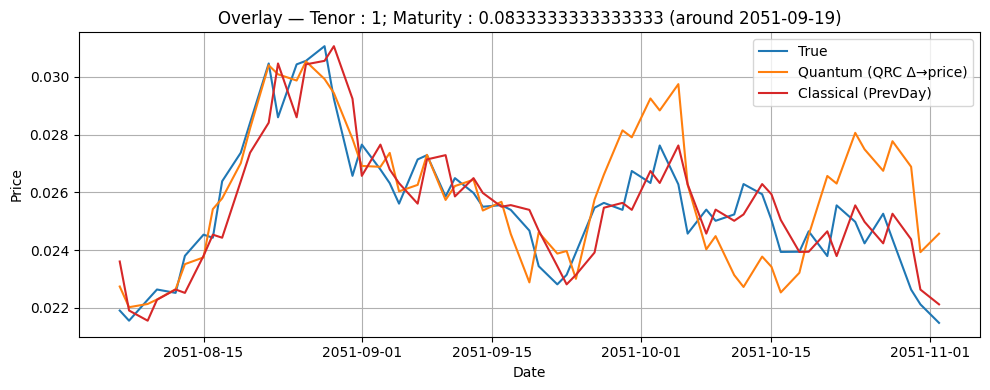

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_409.png


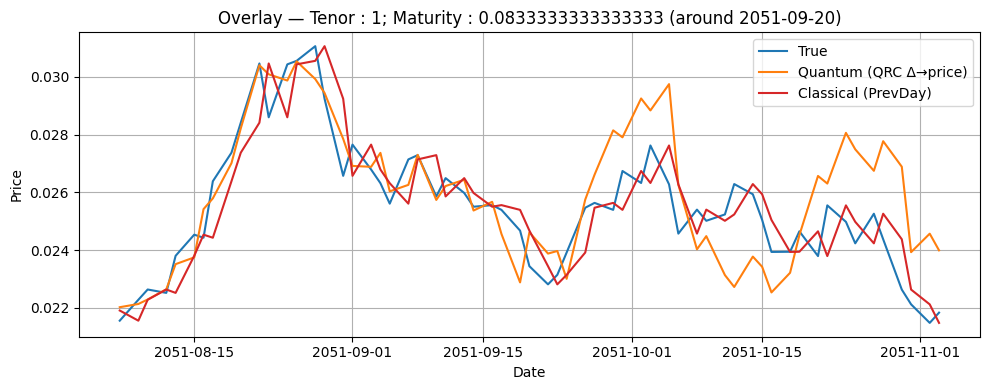

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_410.png


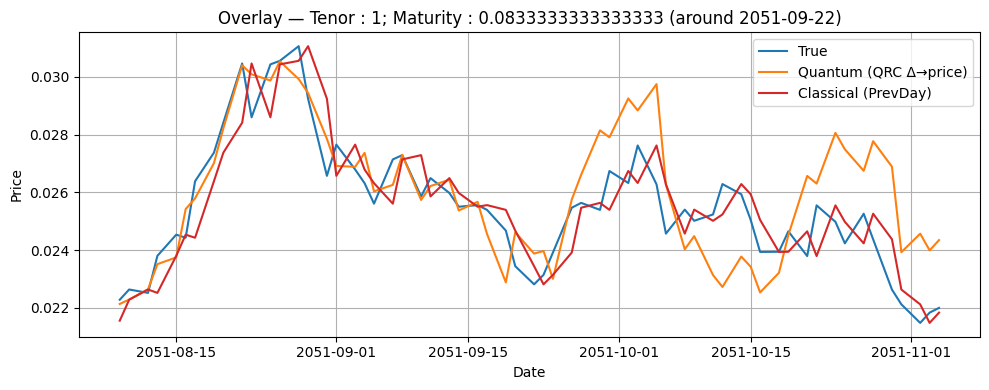

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_411.png


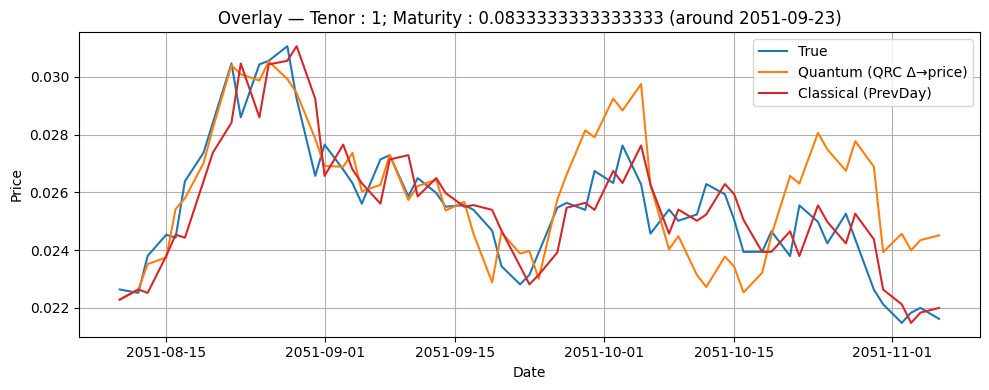

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_412.png


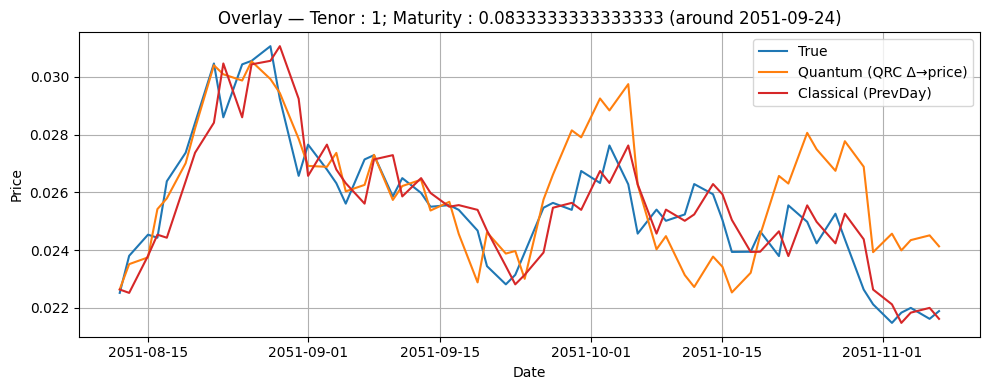

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_413.png


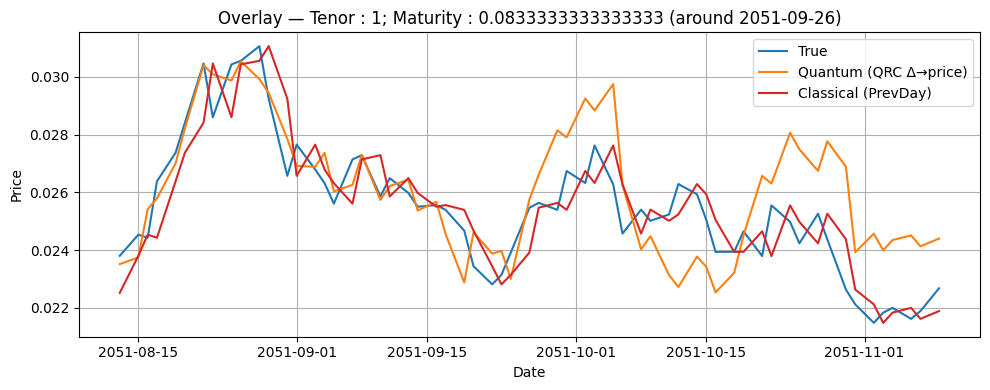

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_414.png


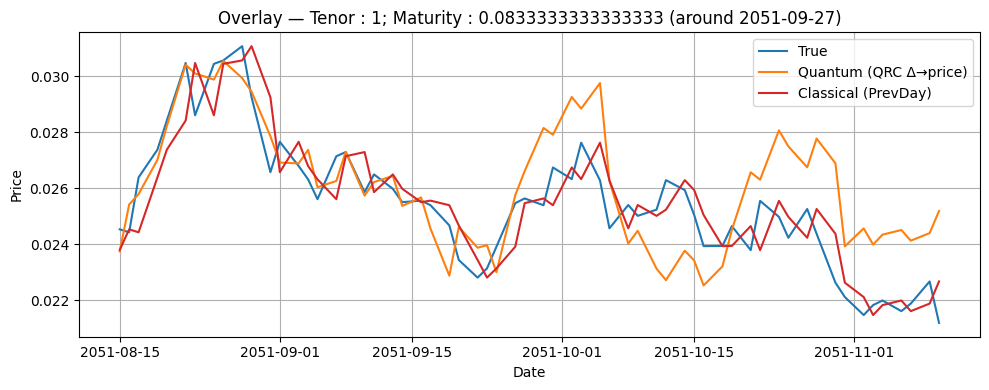

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_415.png


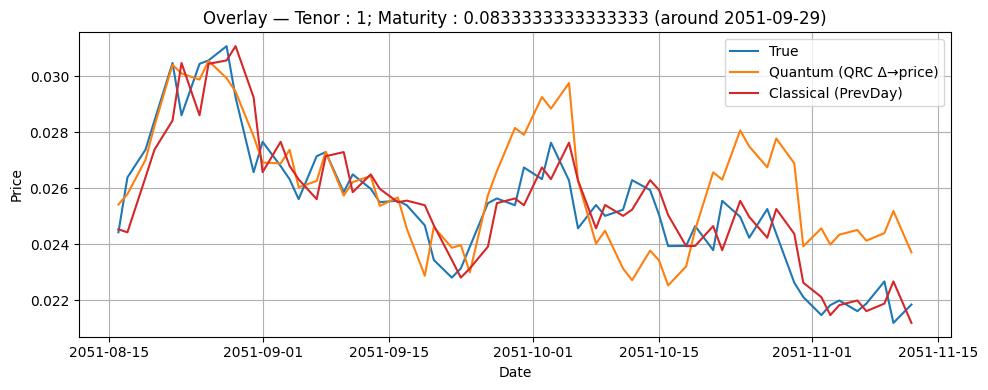

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_416.png


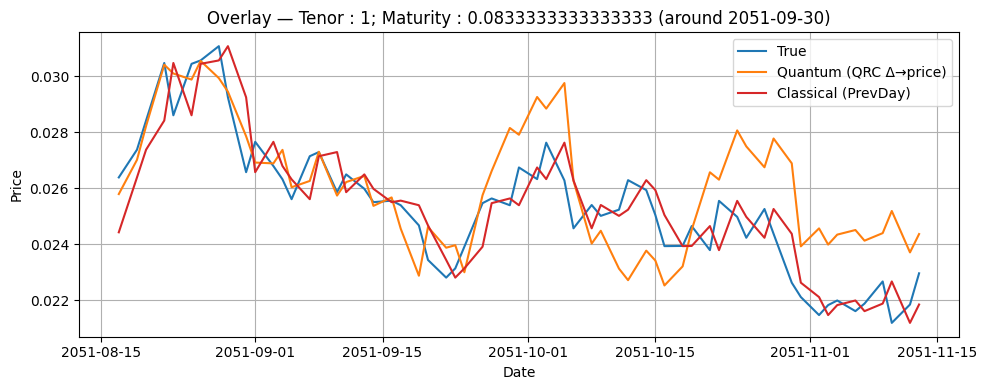

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_417.png


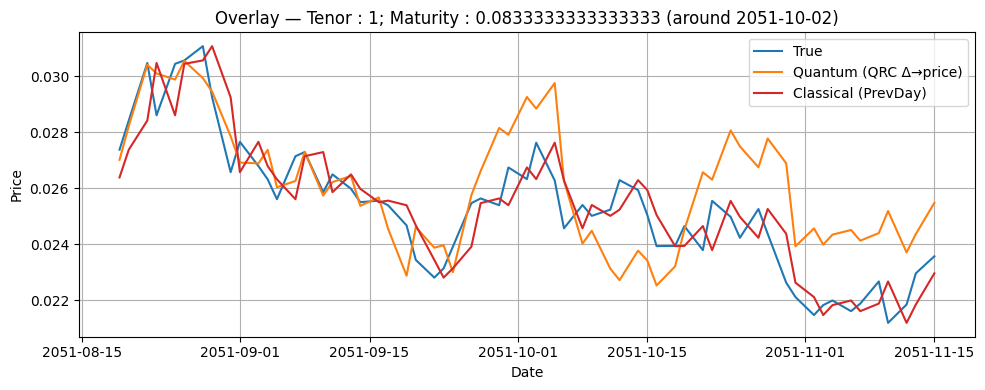

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_418.png


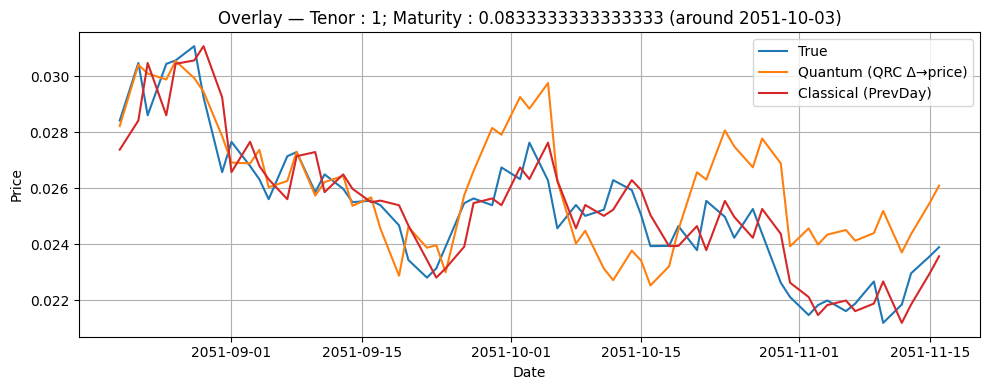

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_419.png


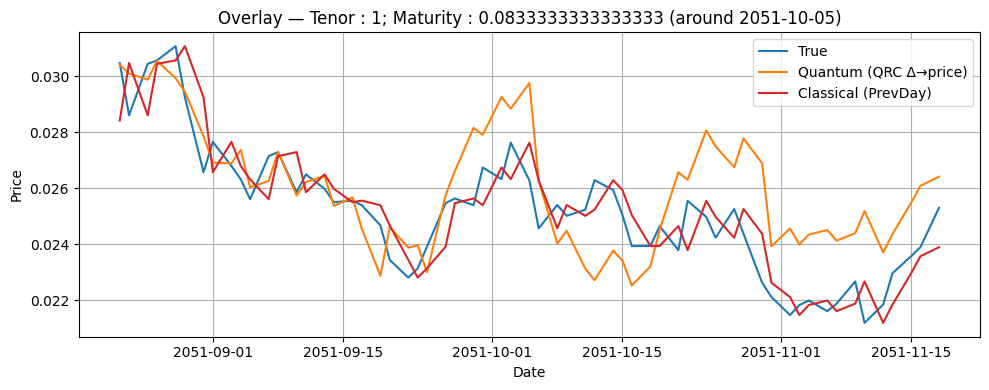

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_420.png


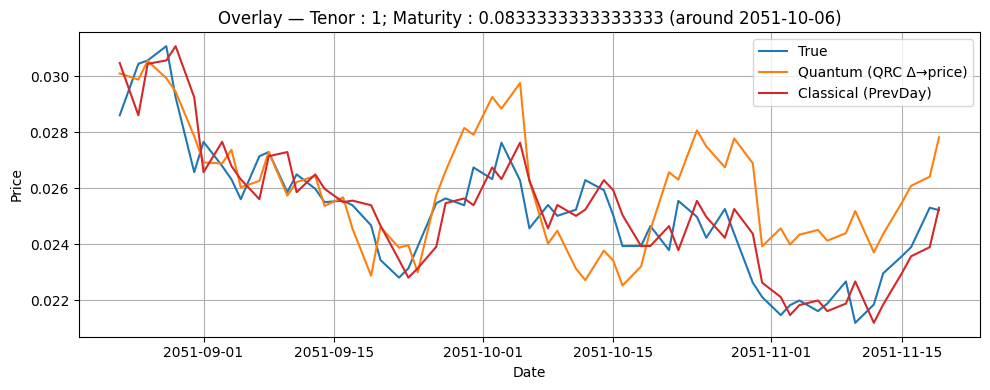

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_421.png


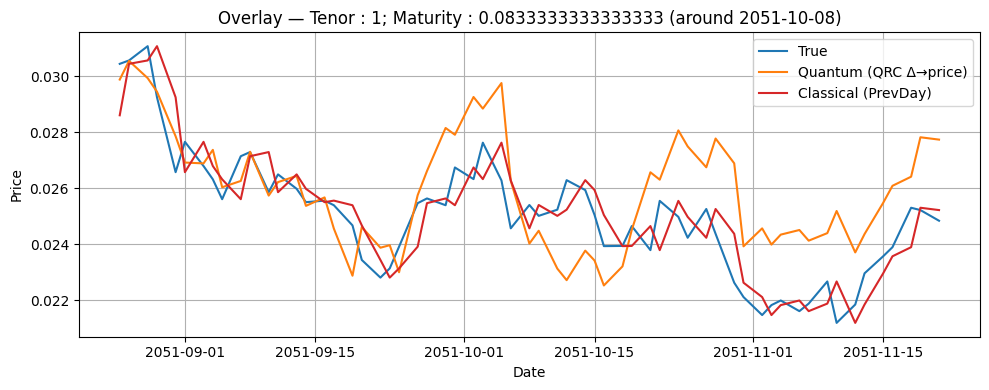

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_422.png


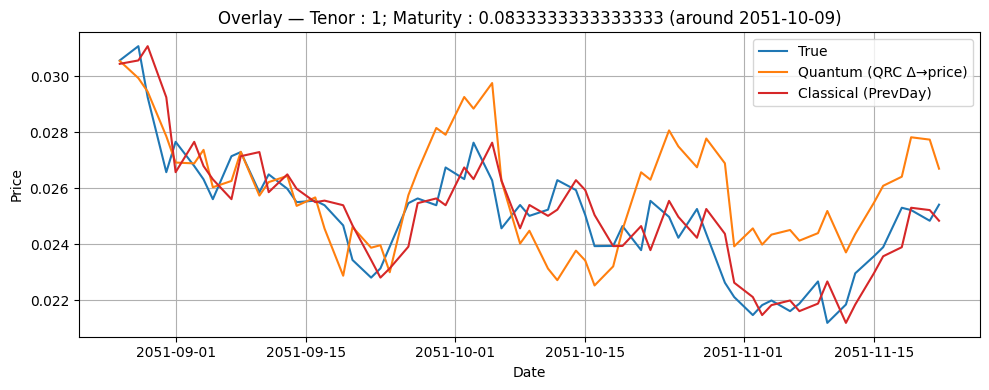

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_423.png


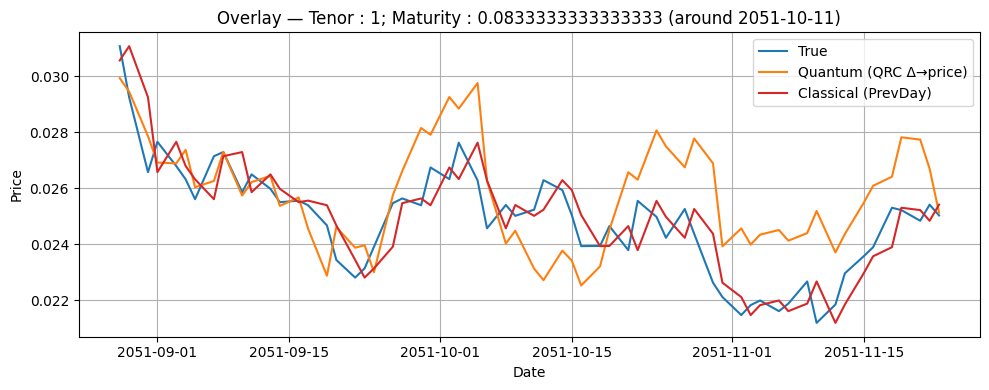

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_424.png


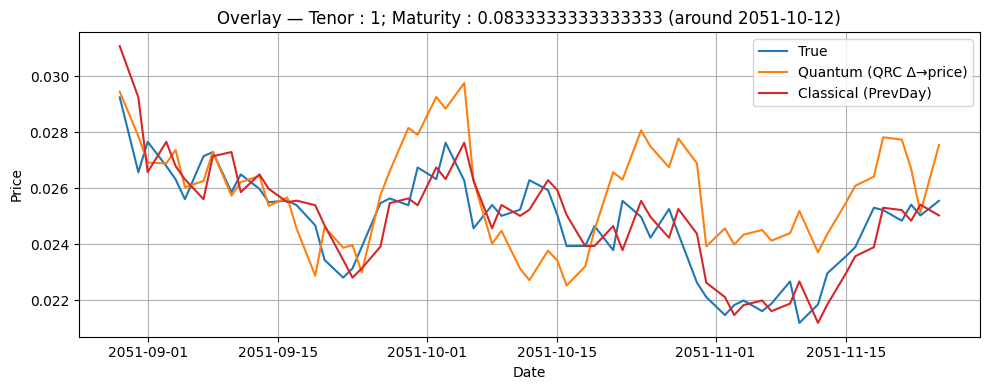

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_425.png


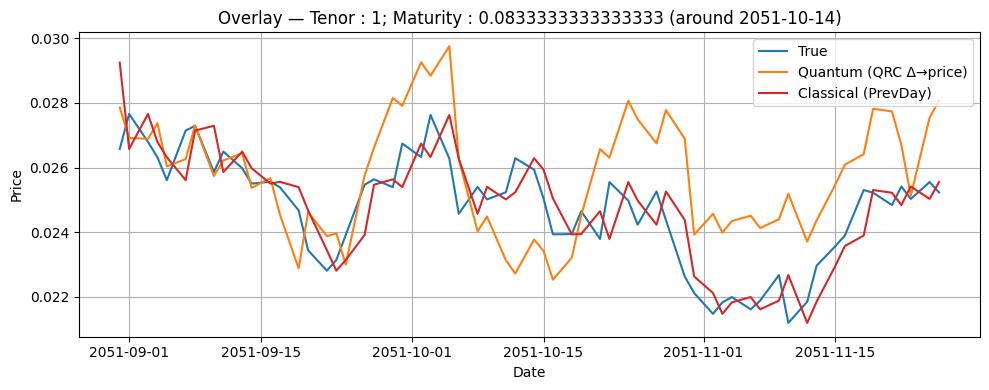

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_426.png


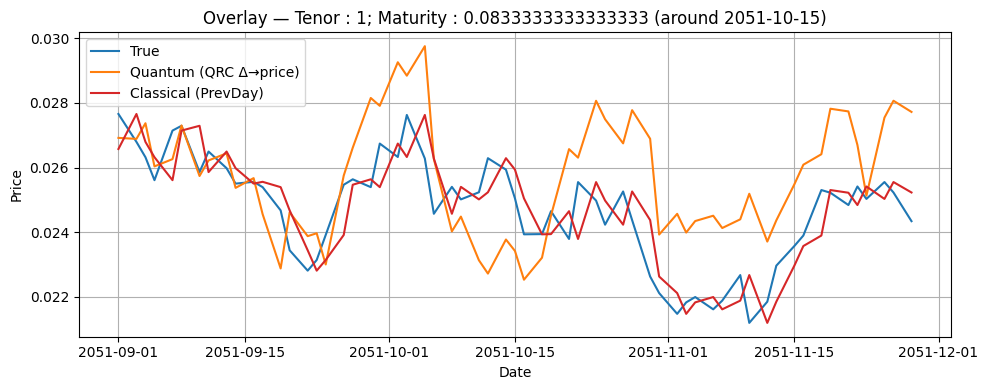

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_427.png


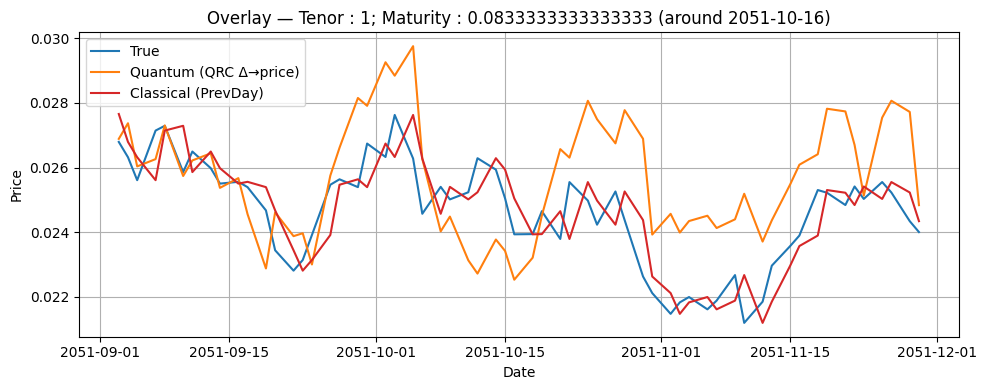

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_428.png


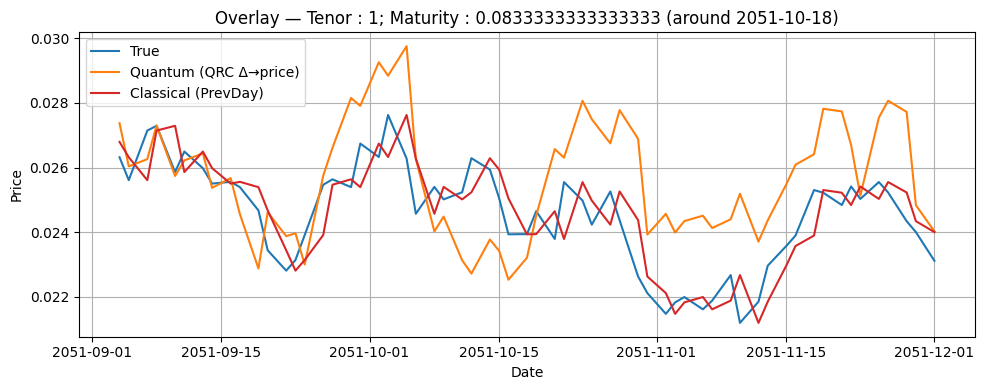

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_429.png


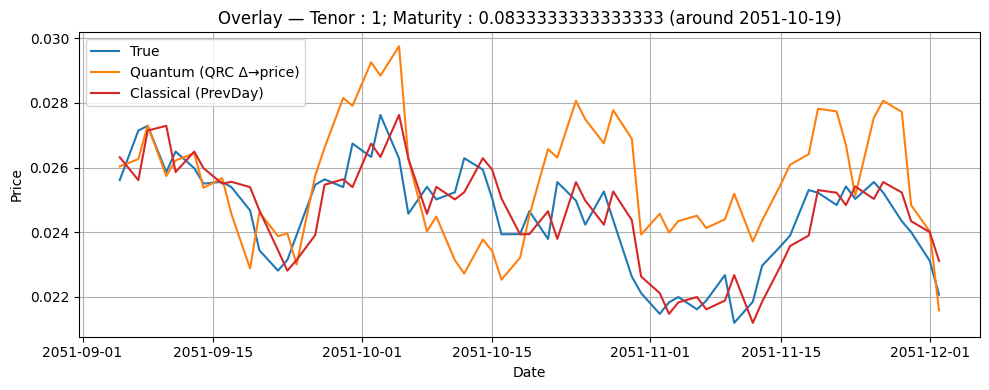

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_430.png


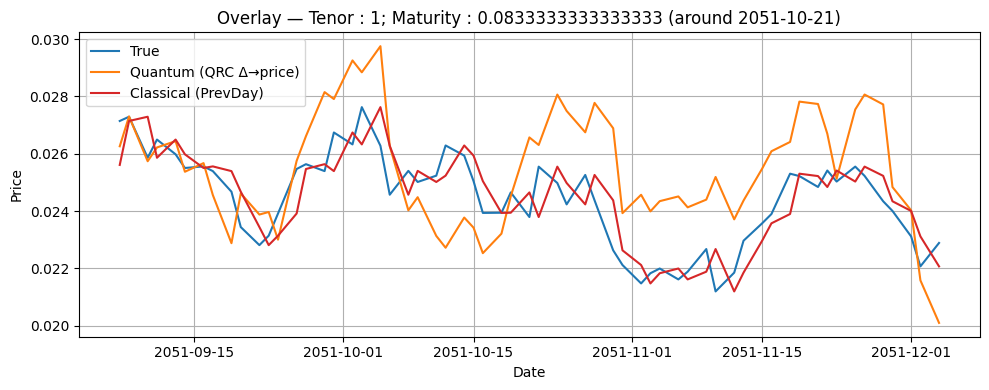

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_431.png


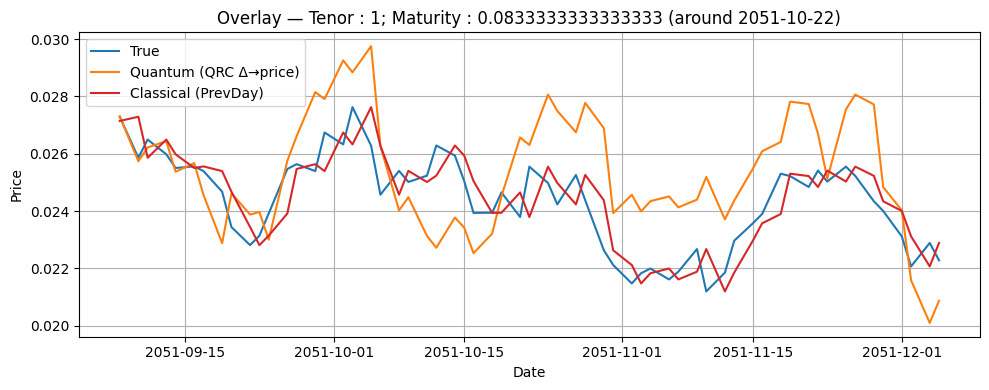

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_432.png


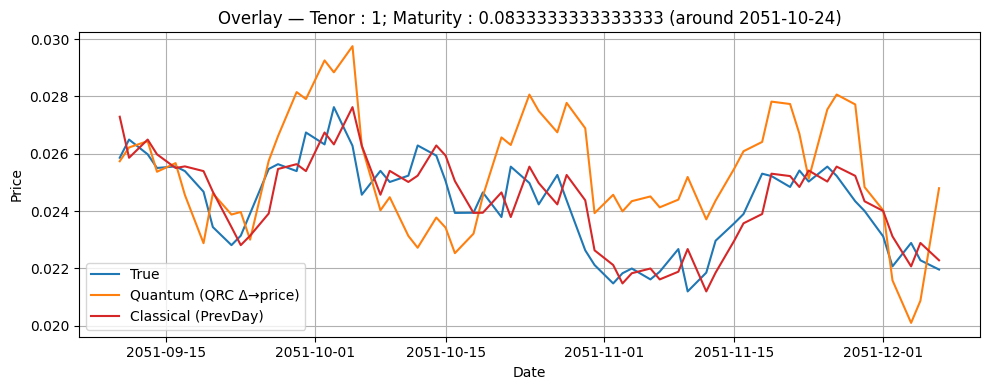

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_433.png


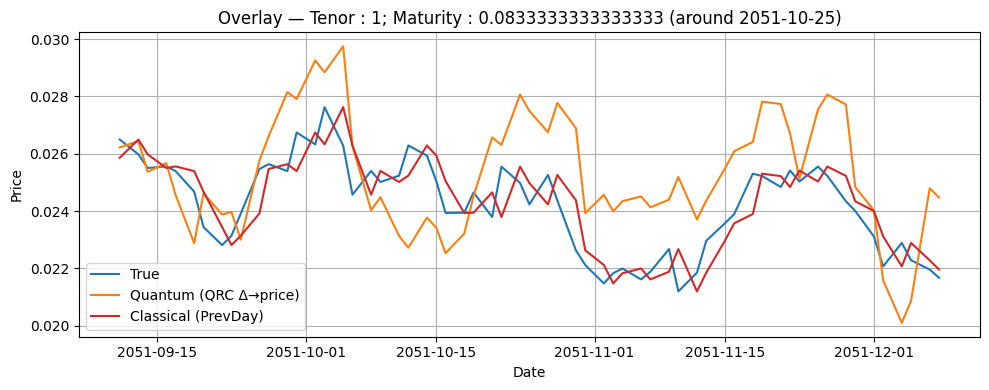

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_434.png


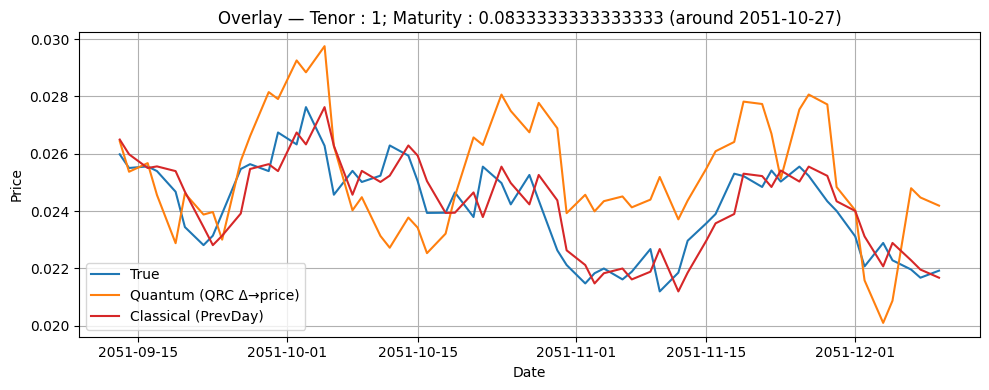

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_435.png


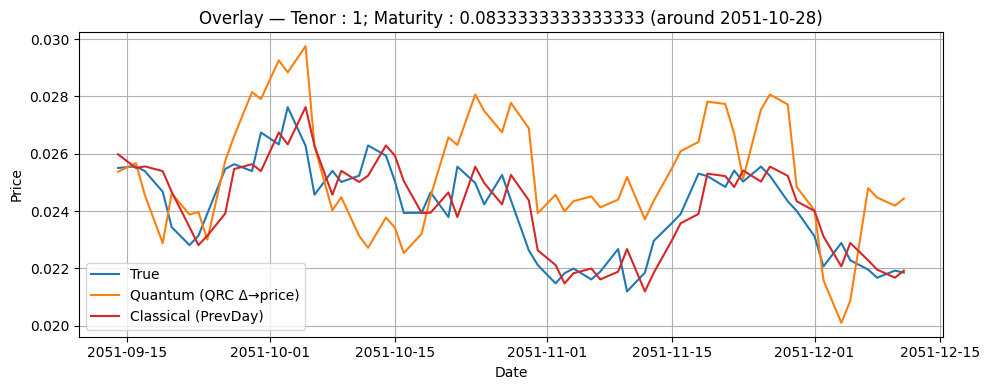

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_436.png


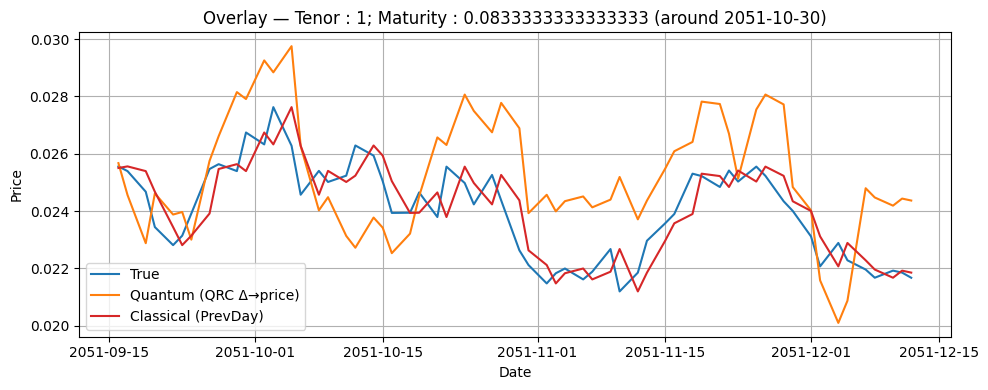

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_437.png


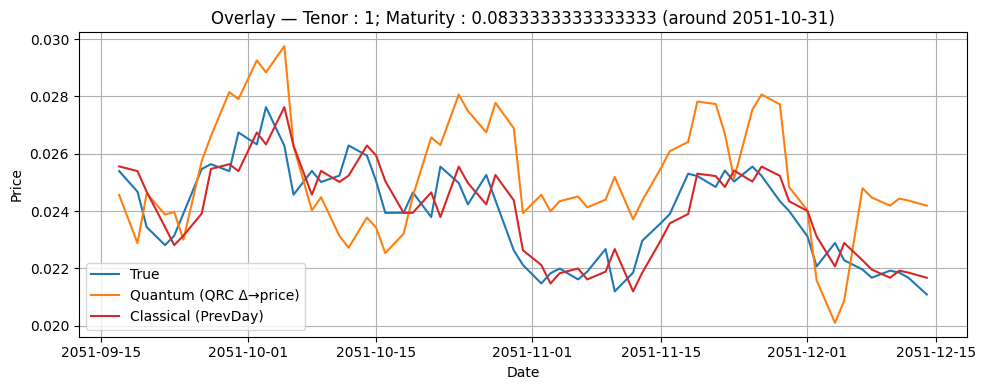

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_438.png


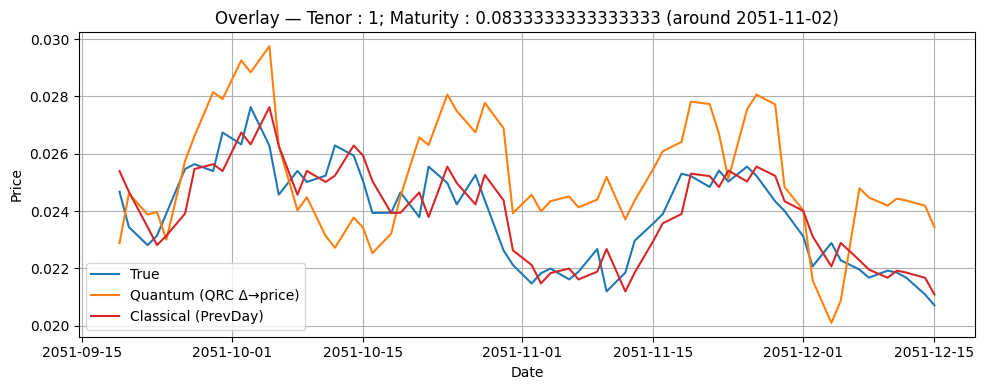

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_439.png


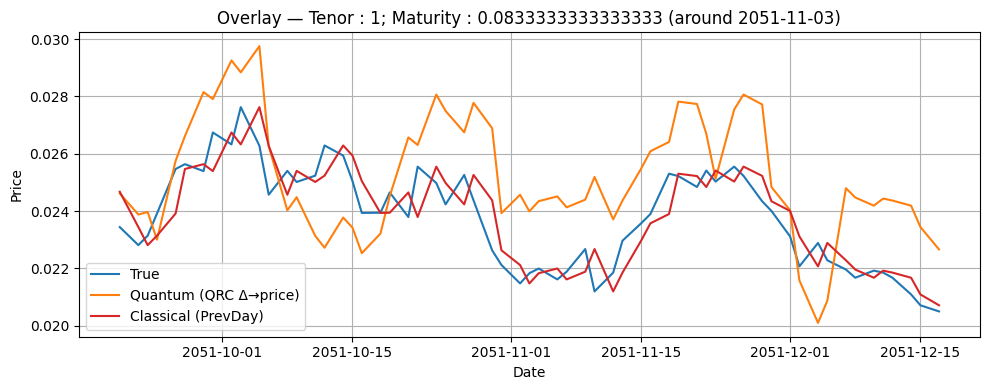

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_440.png


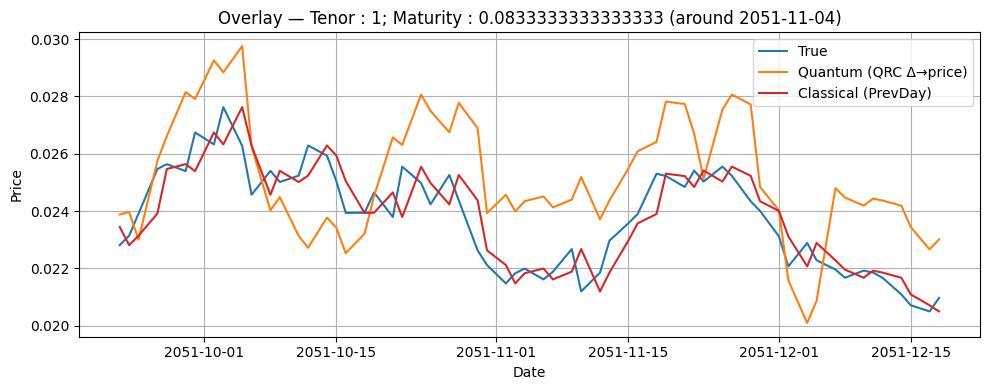

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_441.png


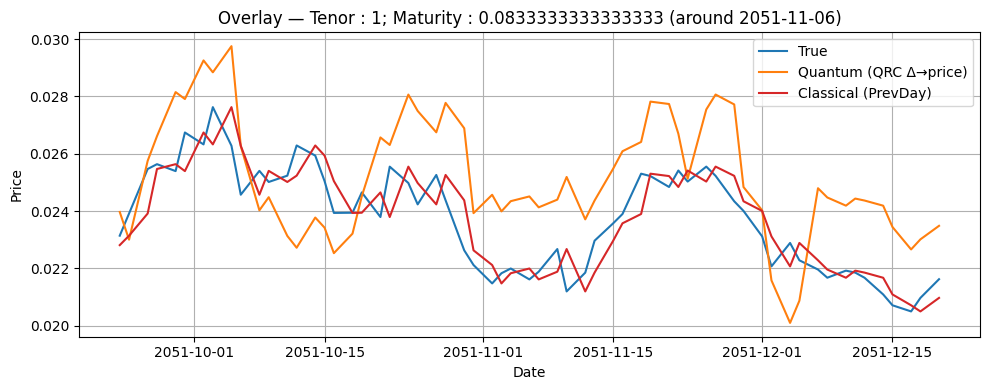

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_442.png


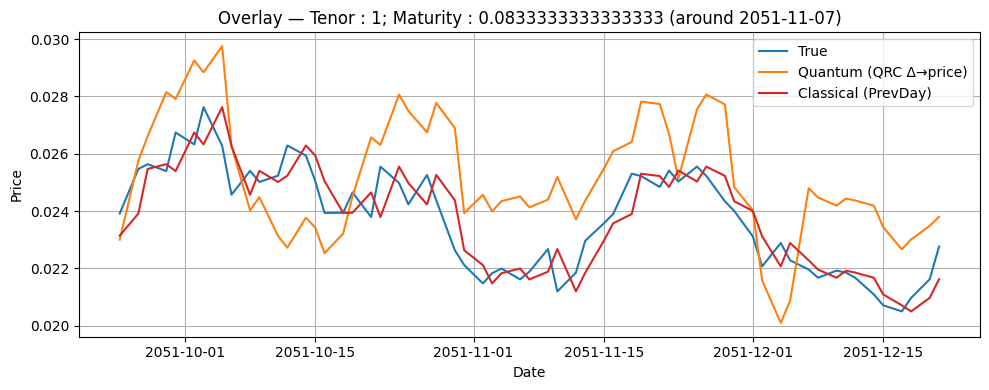

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_443.png


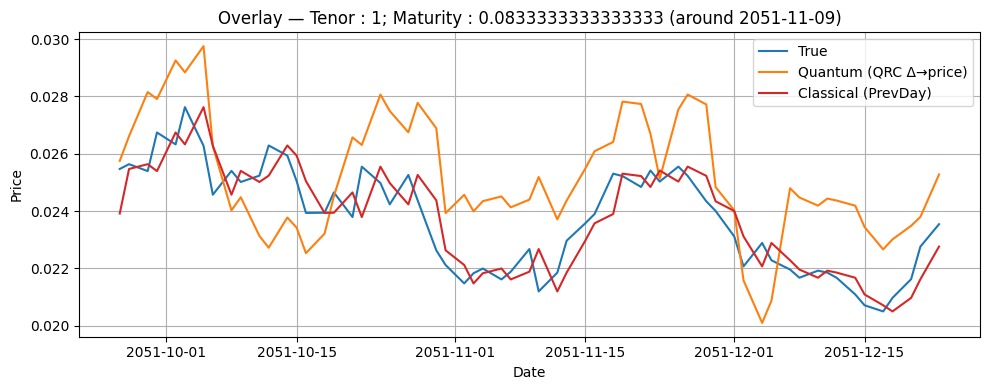

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_444.png


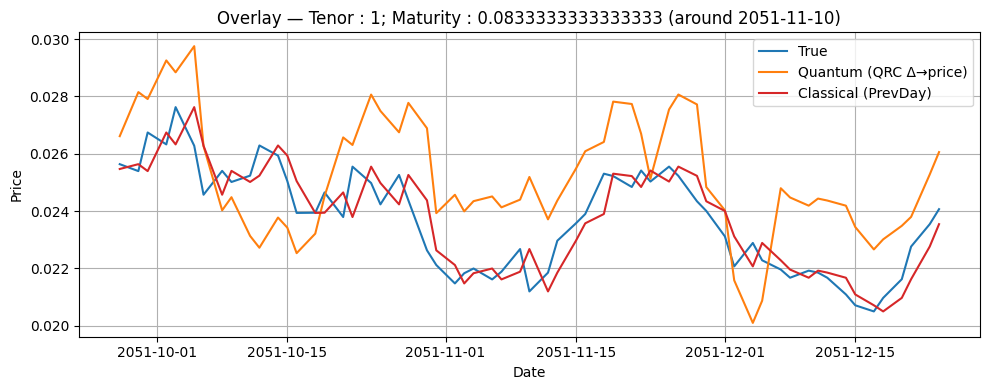

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_445.png


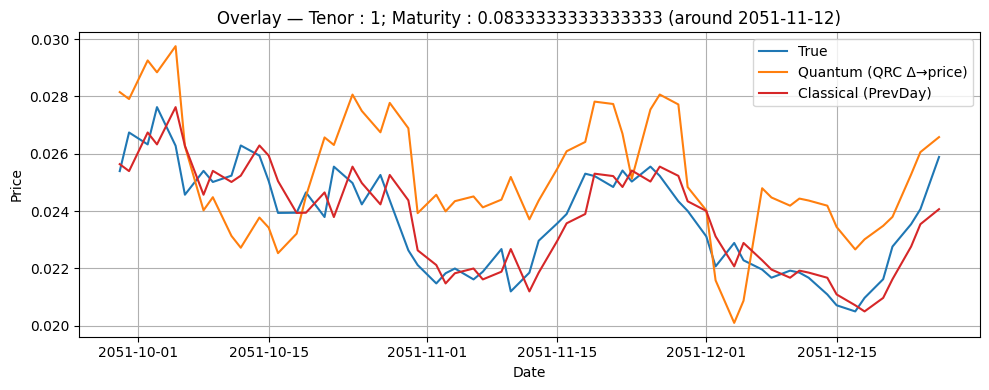

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_446.png


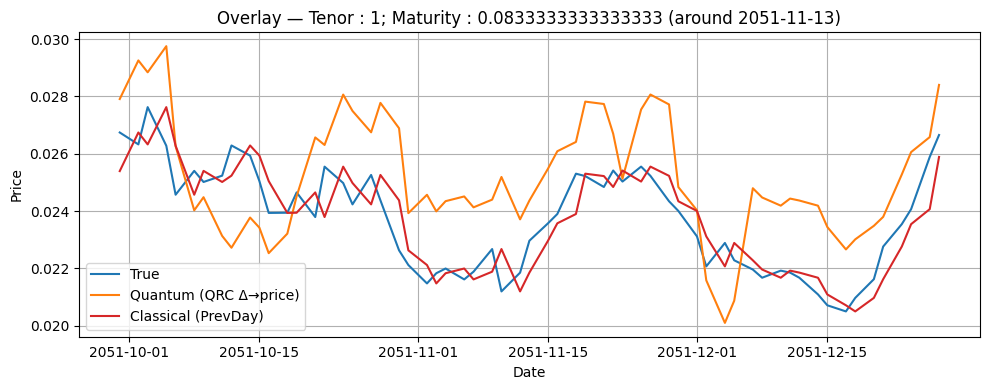

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_447.png


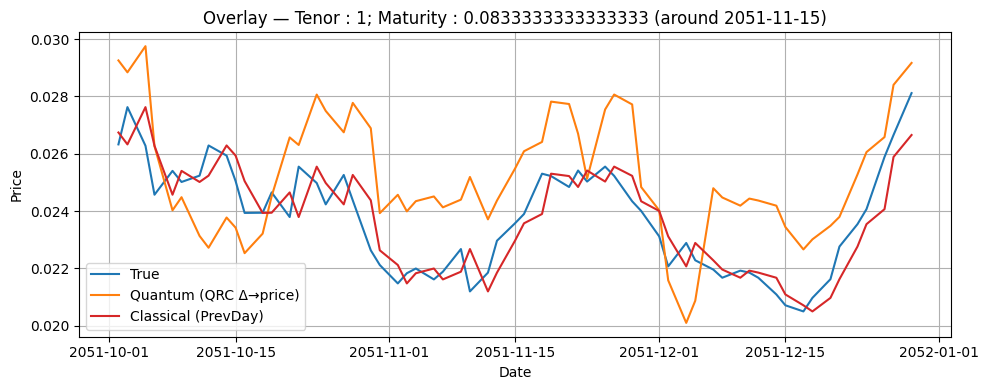

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_448.png


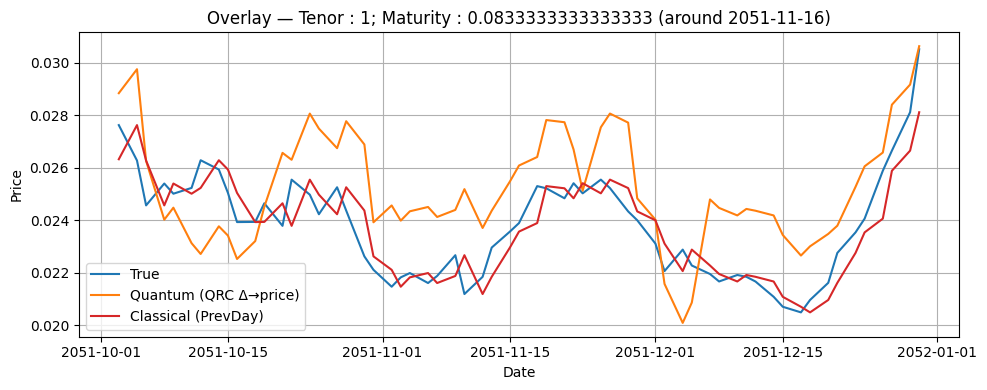

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_449.png


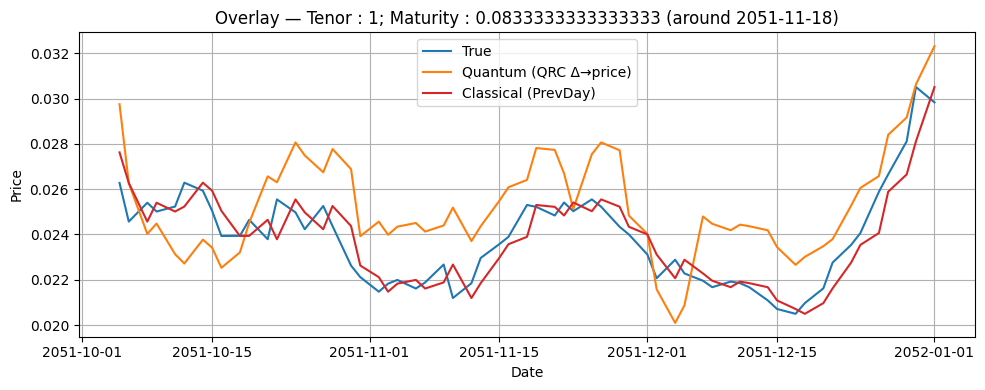

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_450.png


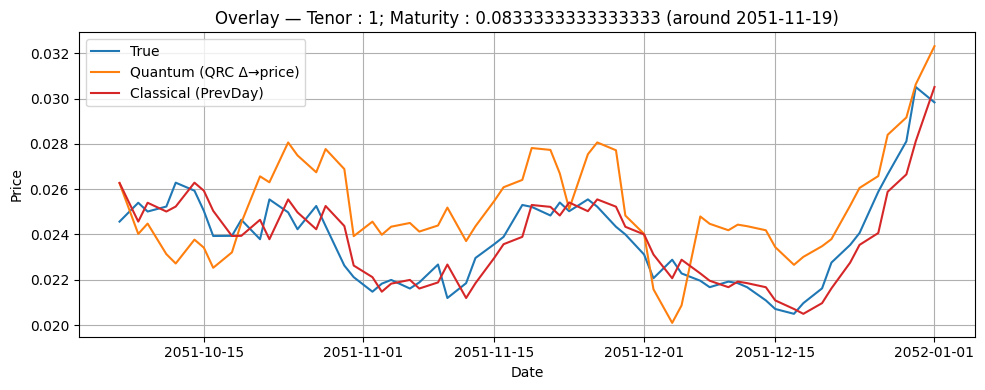

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_451.png


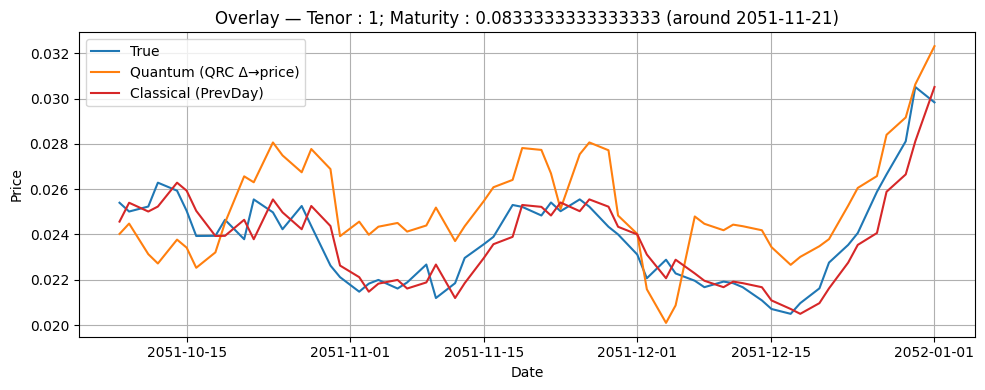

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_452.png


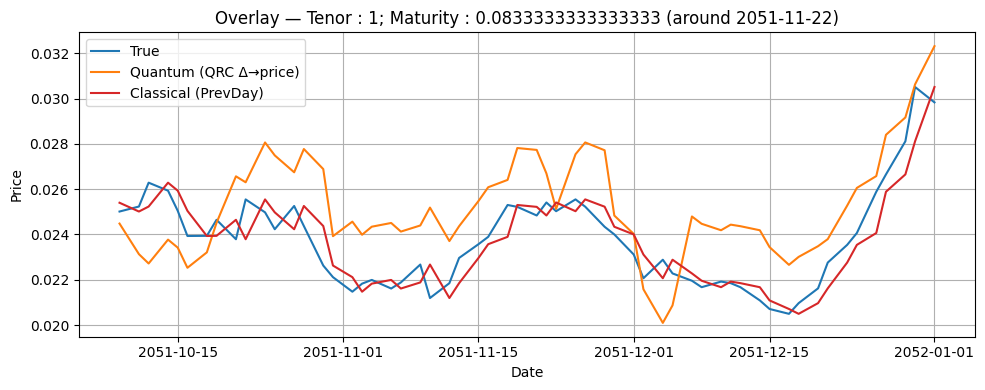

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_453.png


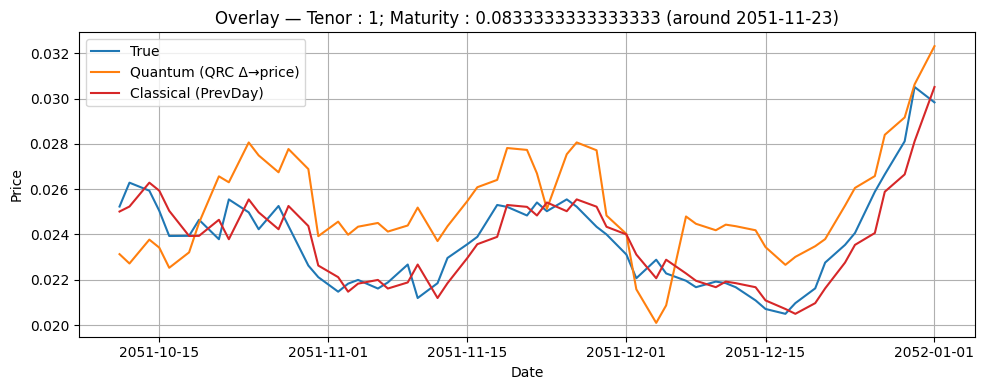

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_454.png


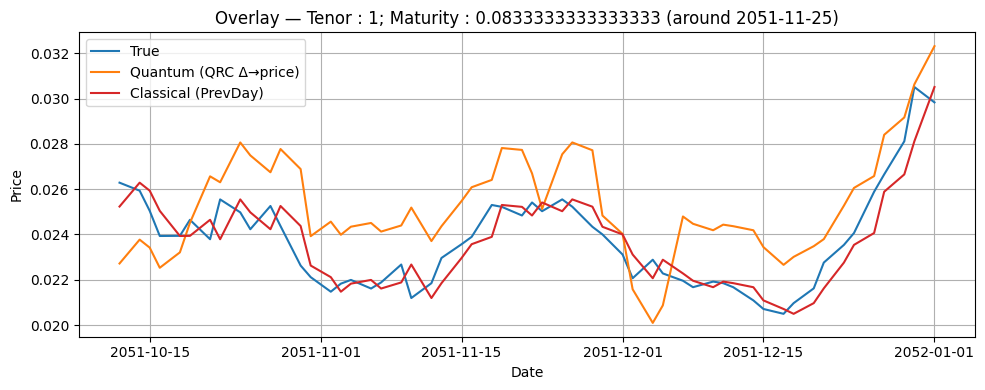

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_455.png


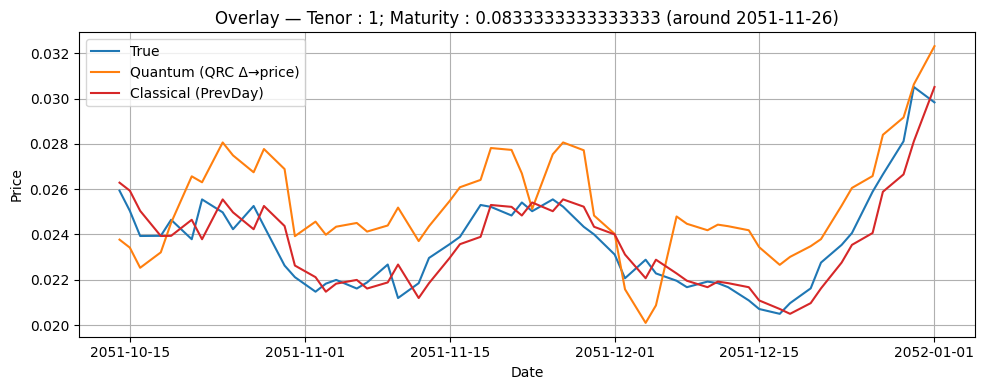

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_456.png


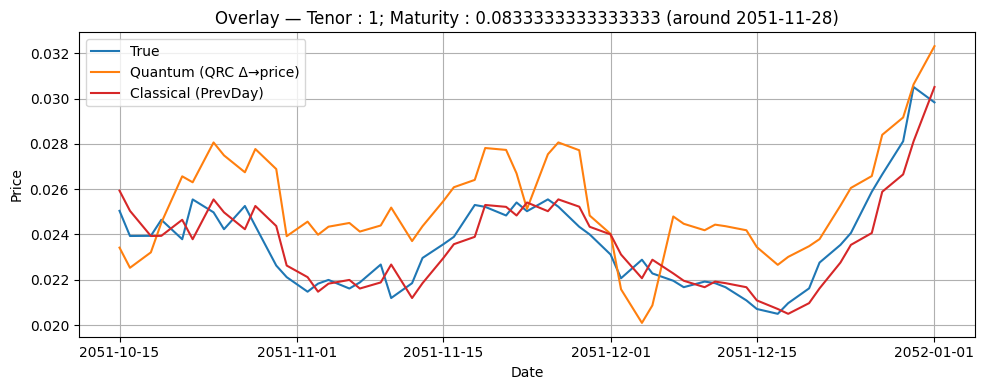

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_457.png


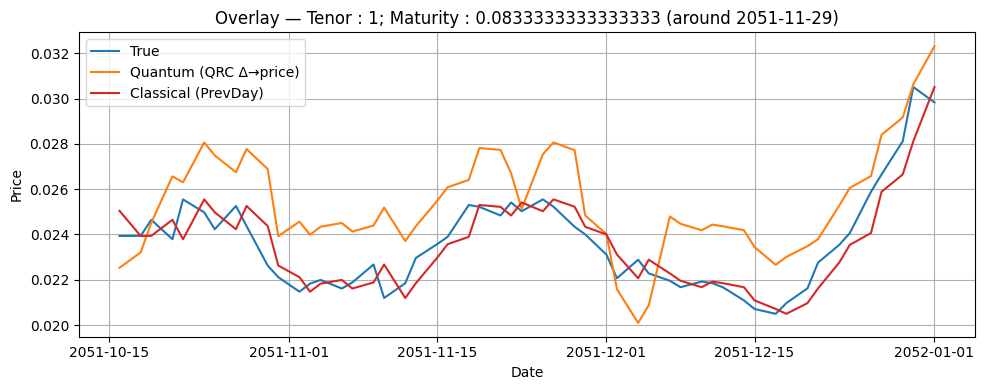

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_458.png


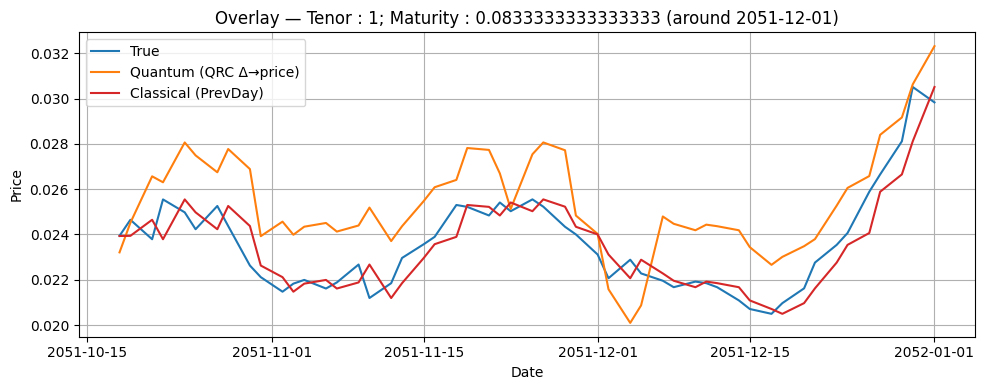

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_459.png


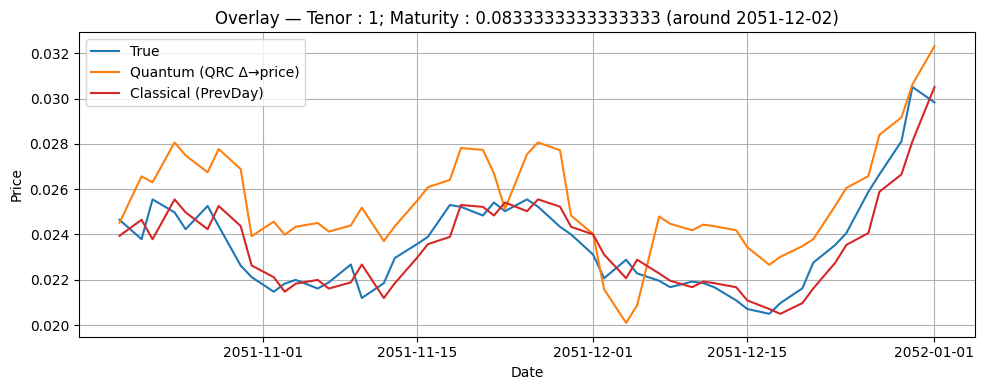

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_460.png


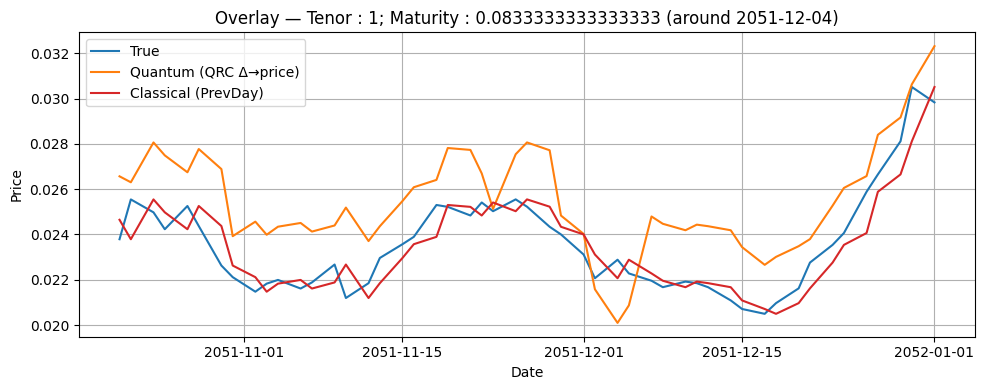

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_461.png


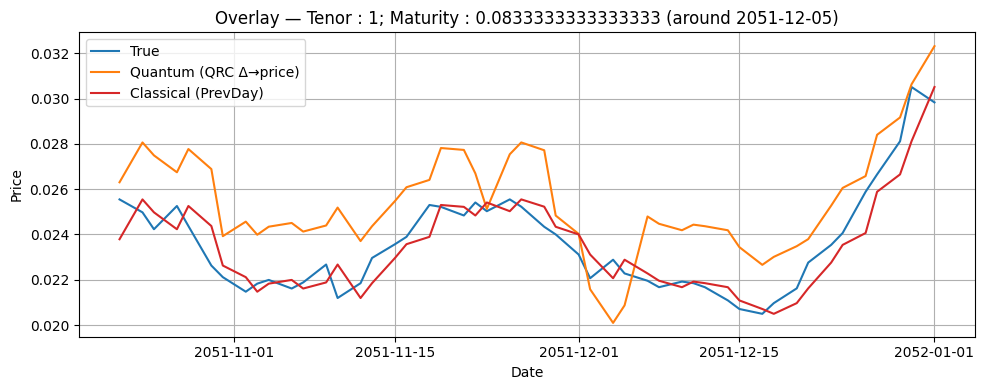

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_462.png


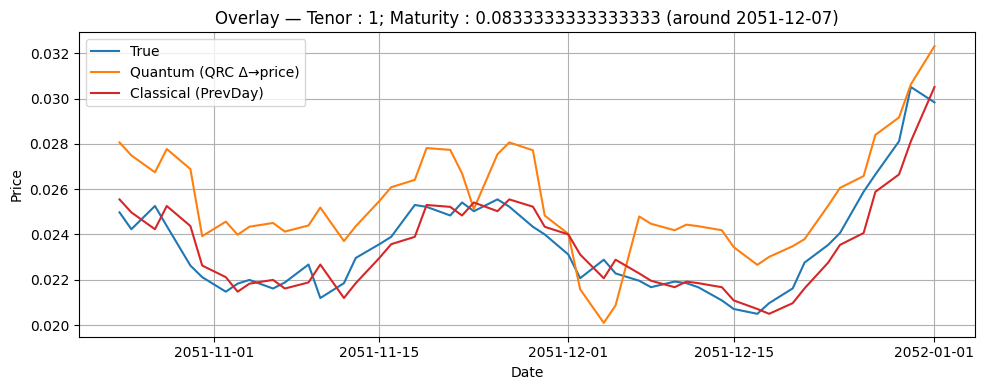

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_463.png


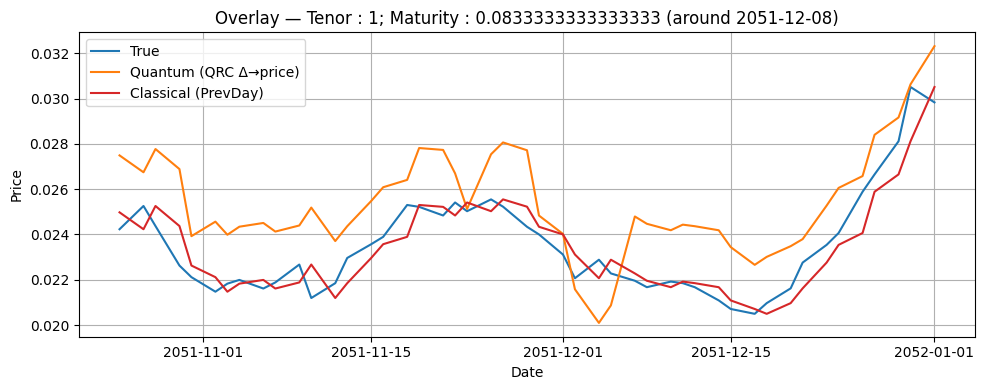

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_464.png


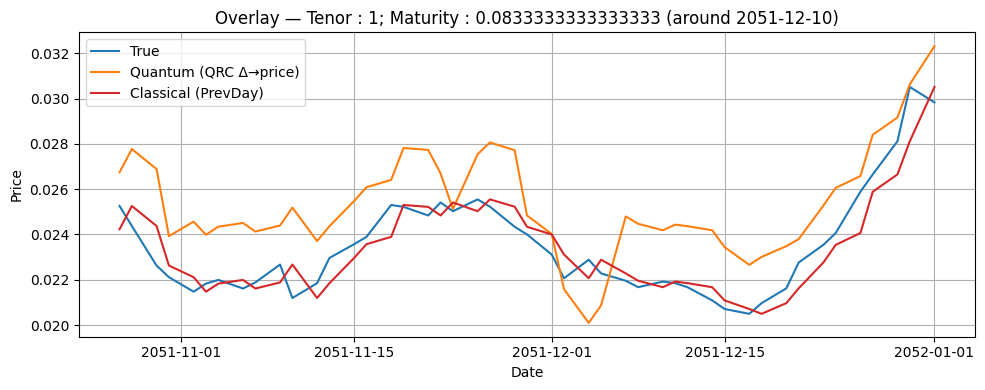

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_465.png


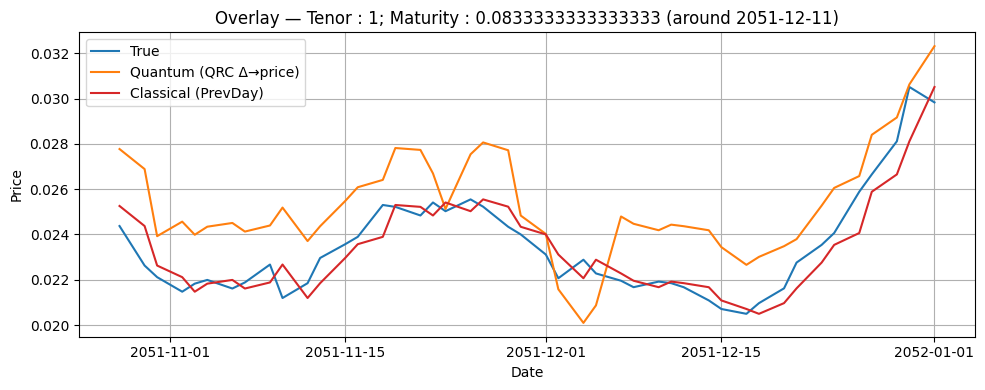

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_466.png


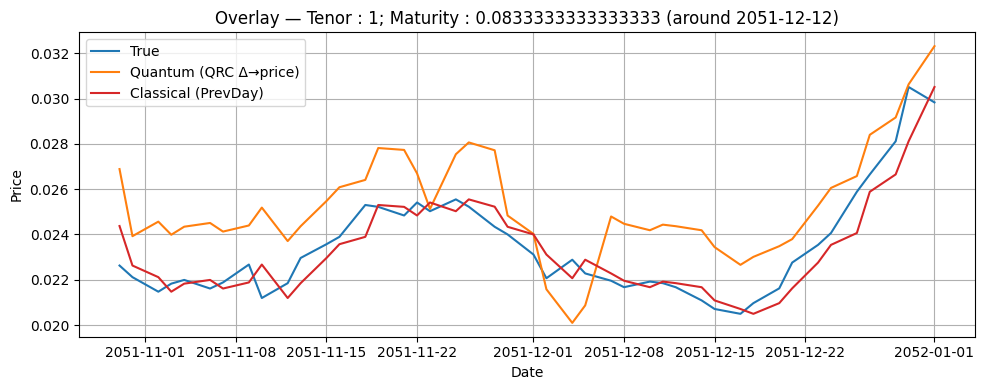

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_467.png


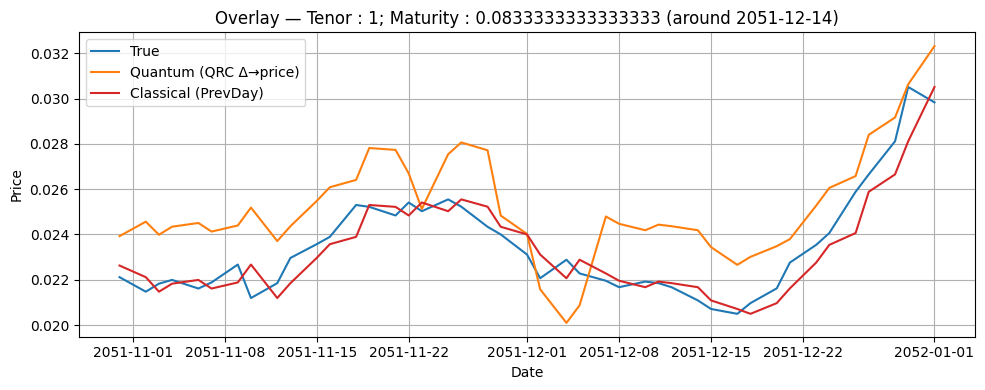

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_468.png


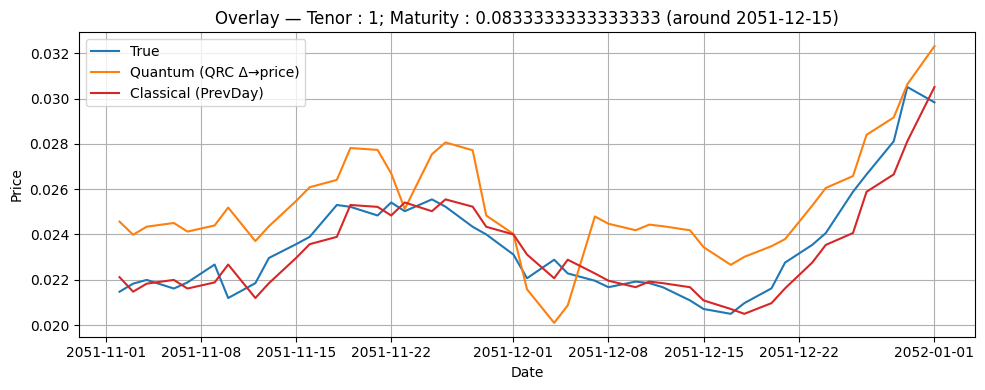

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_469.png


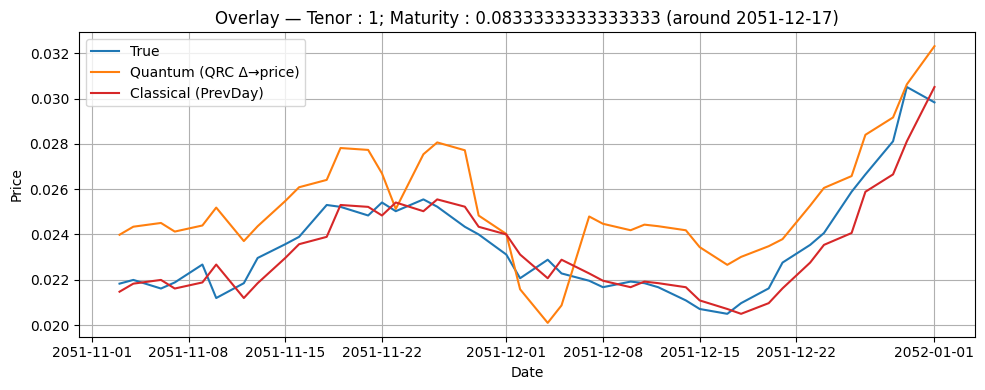

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_470.png


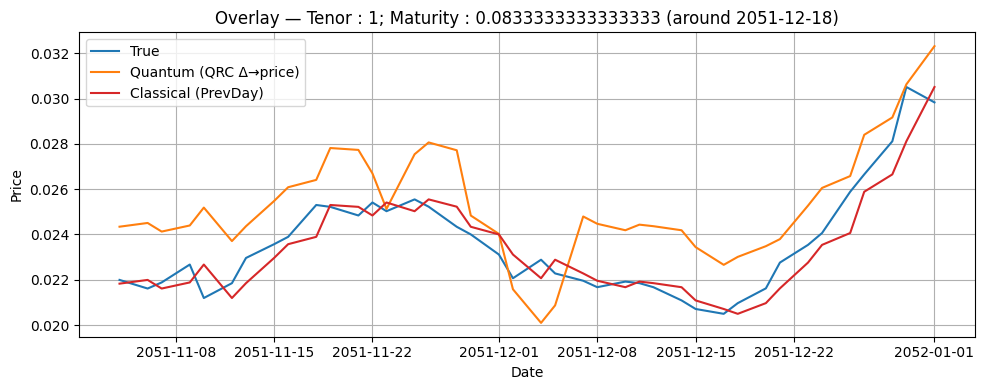

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_471.png


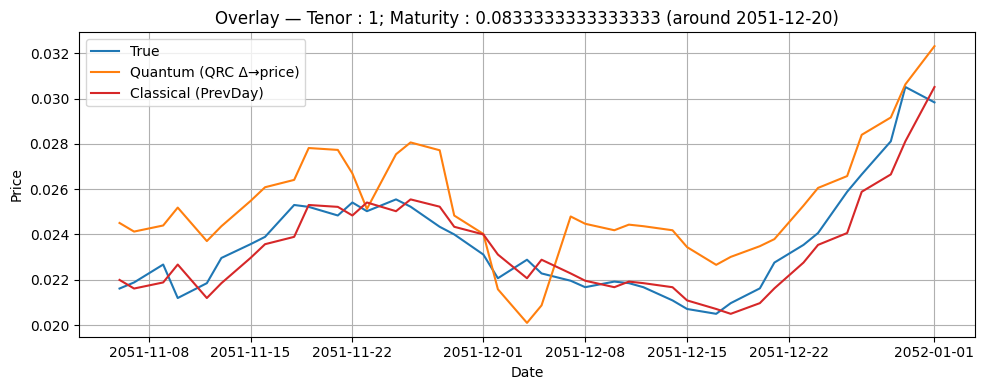

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_472.png


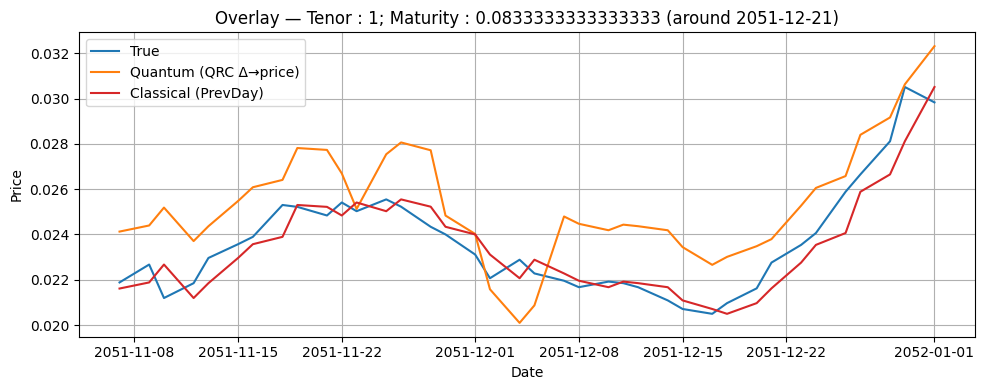

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_473.png


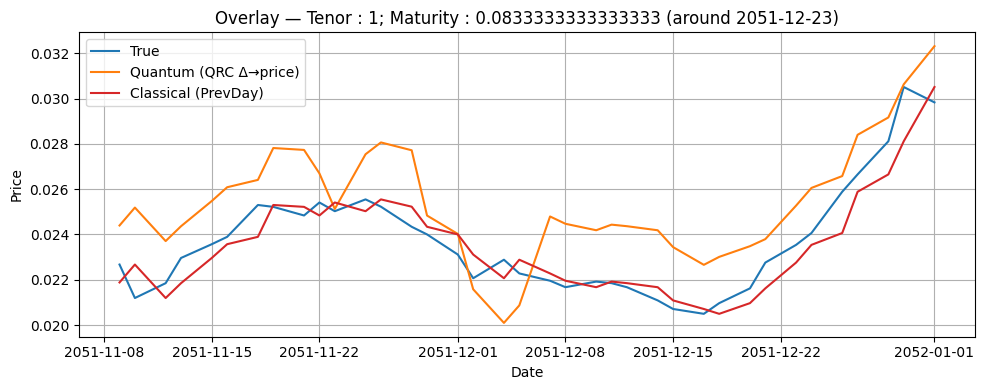

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_474.png


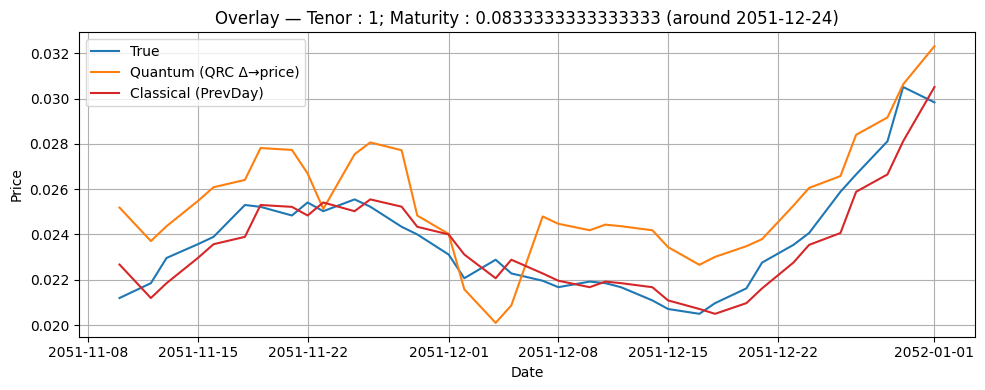

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_475.png


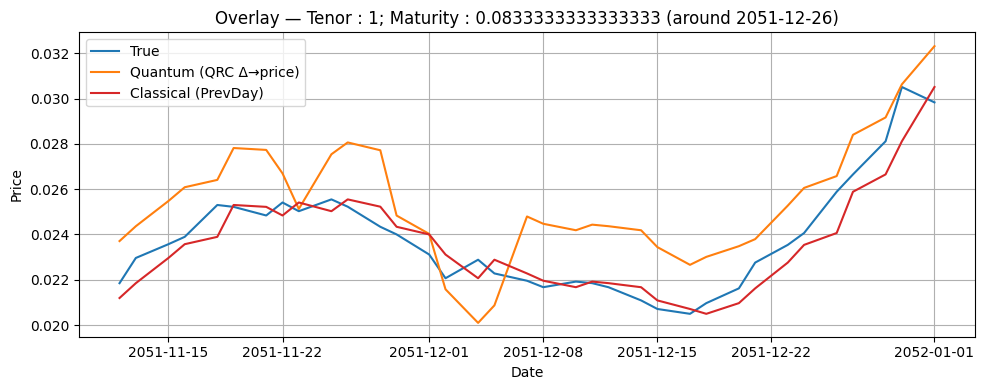

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_476.png


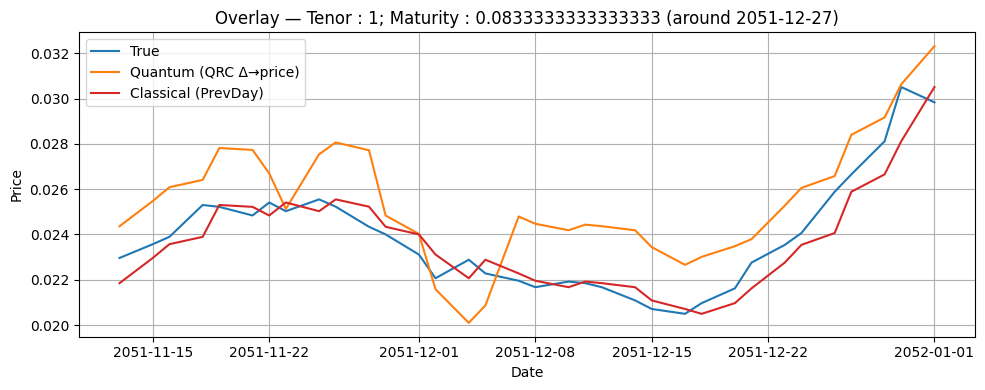

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_477.png


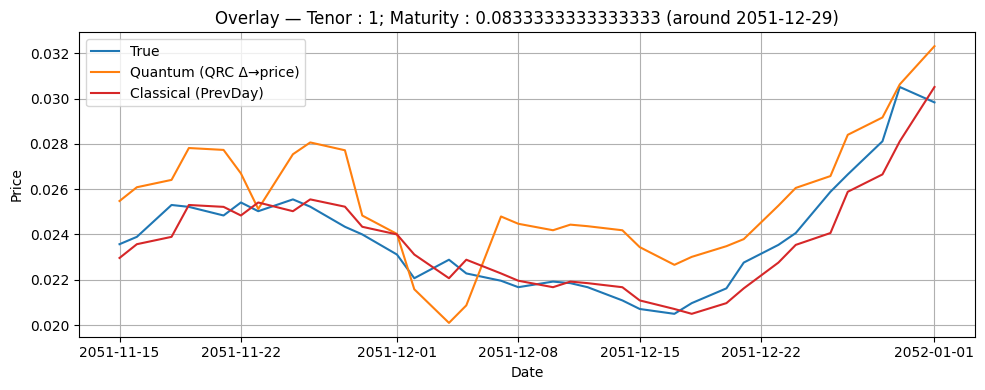

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_478.png


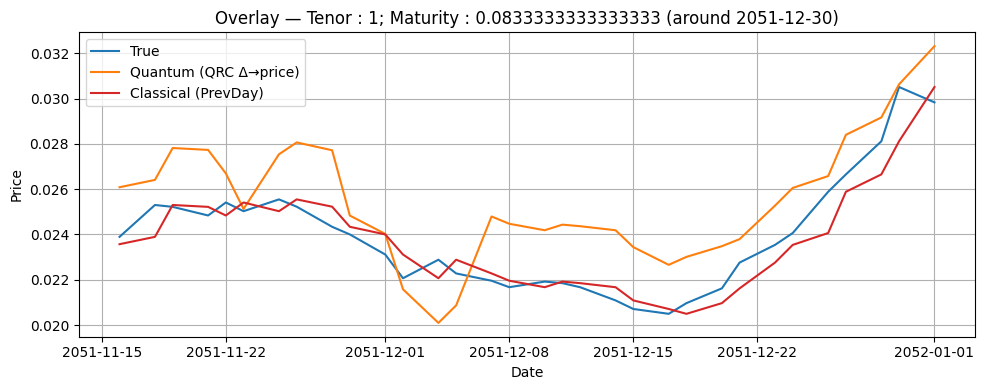

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_﻿Tenor _ 1; Maturity _ 0.0833333333333333_at_479.png


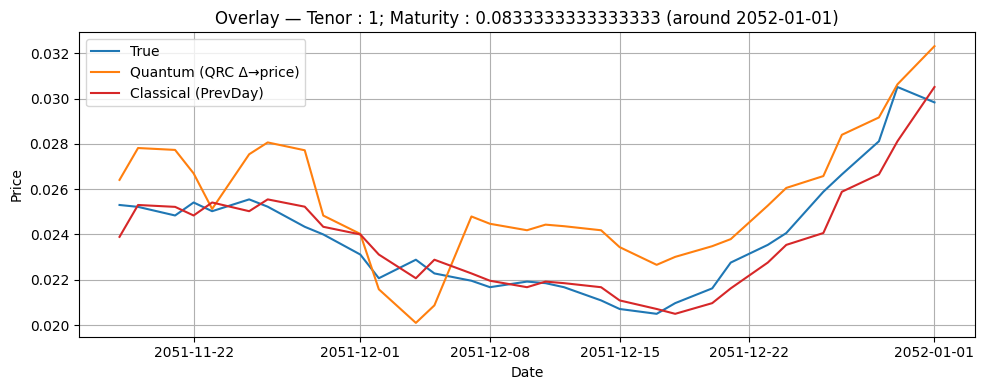

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_408.png


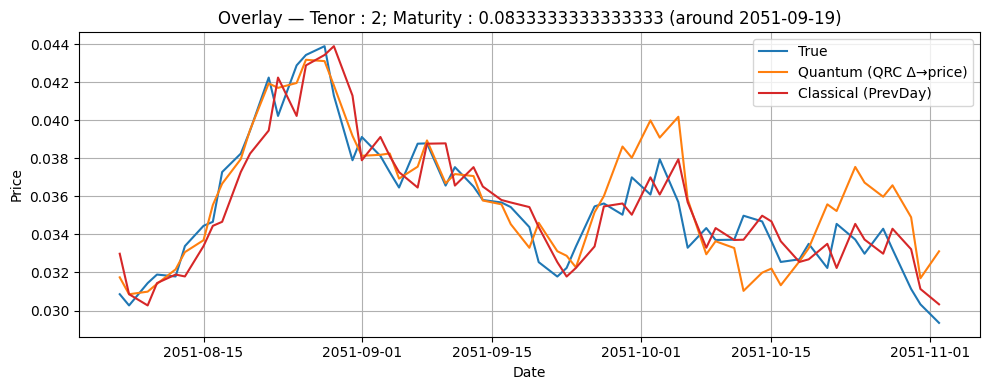

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_409.png


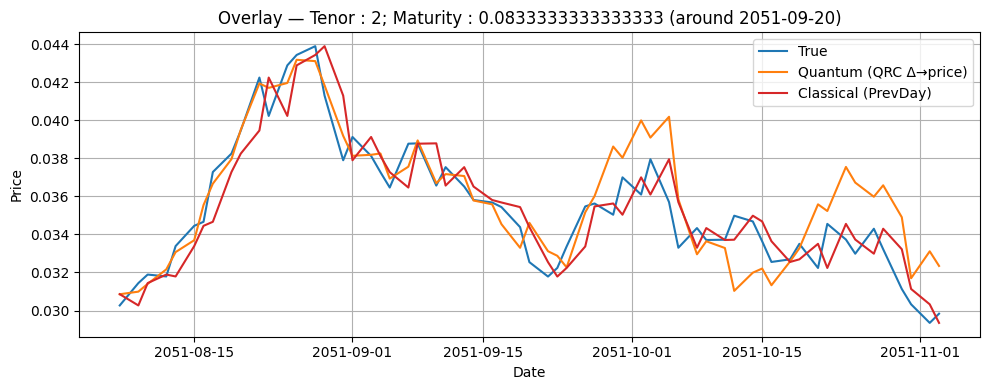

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_410.png


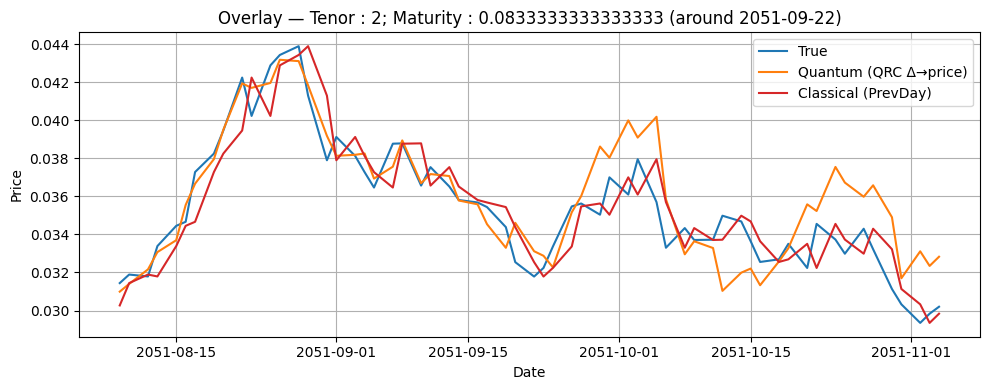

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_411.png


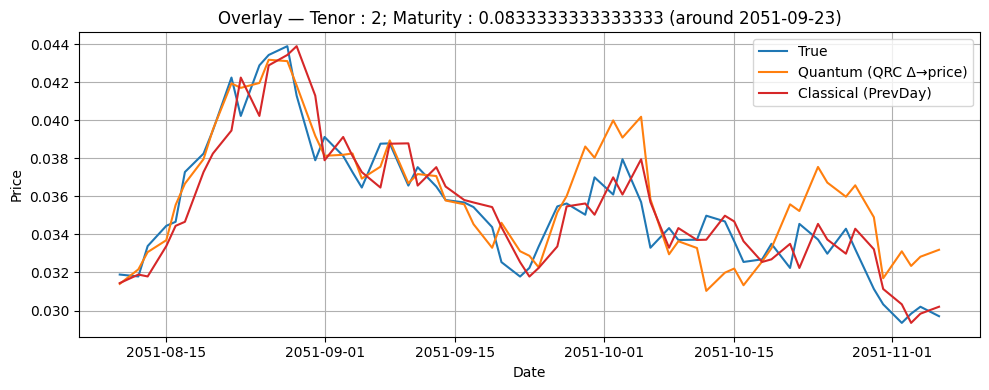

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_412.png


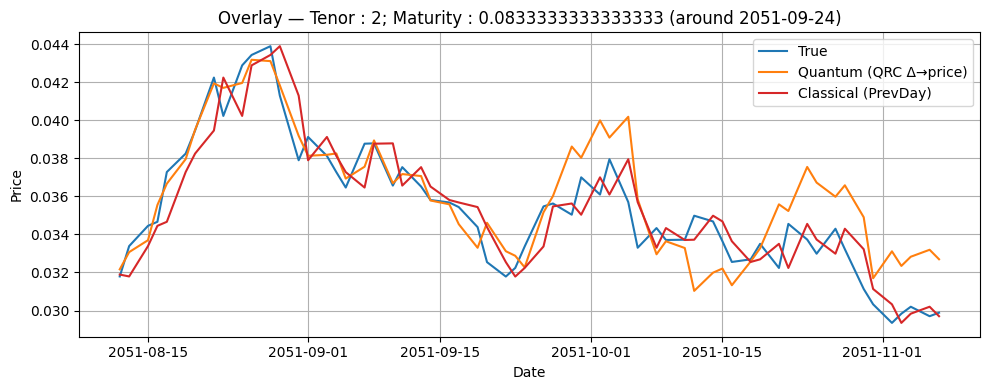

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_413.png


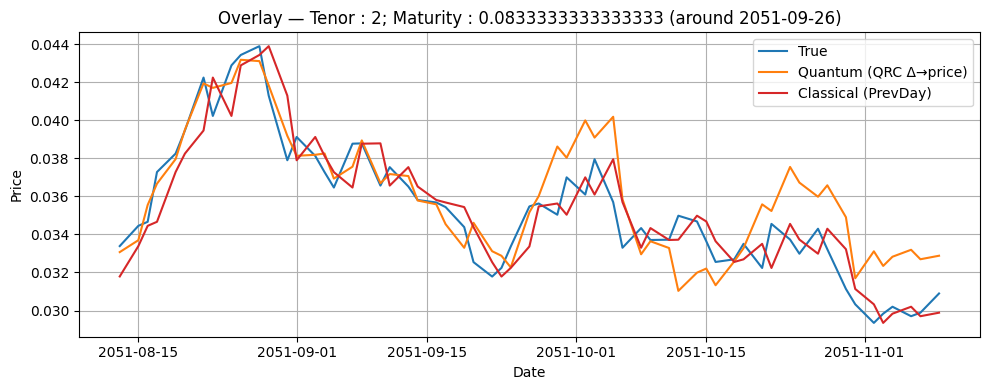

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_414.png


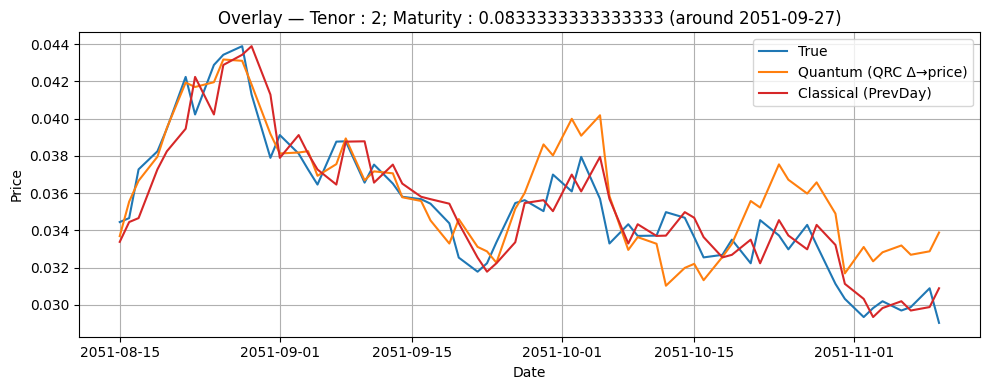

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_415.png


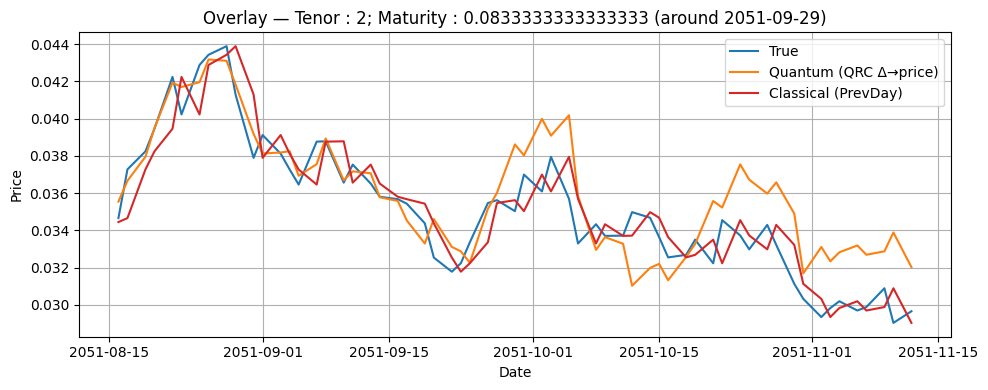

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_416.png


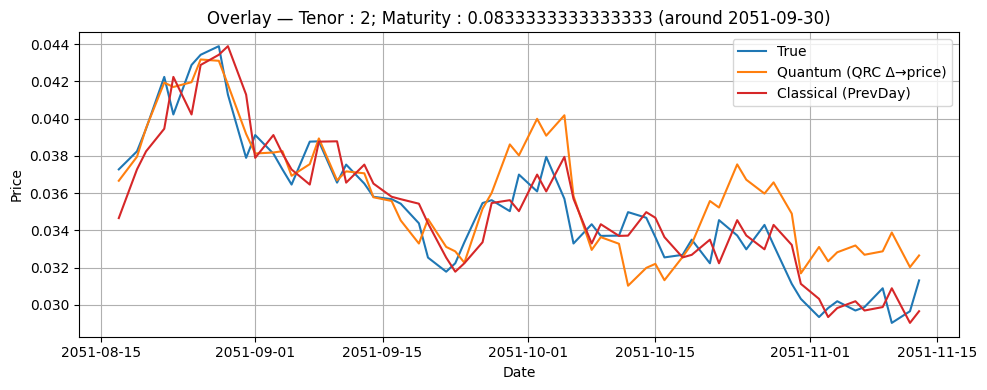

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_417.png


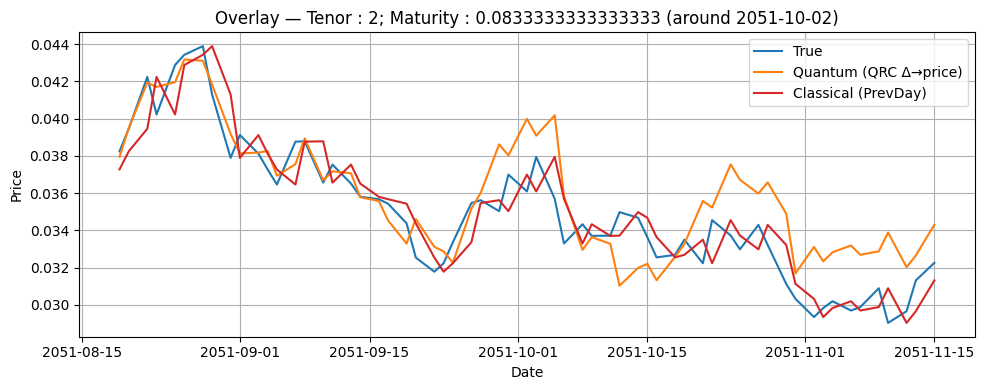

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_418.png


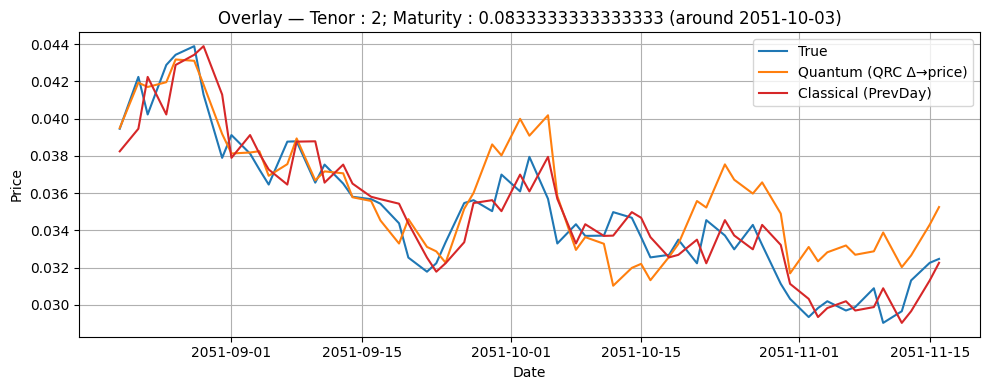

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_419.png


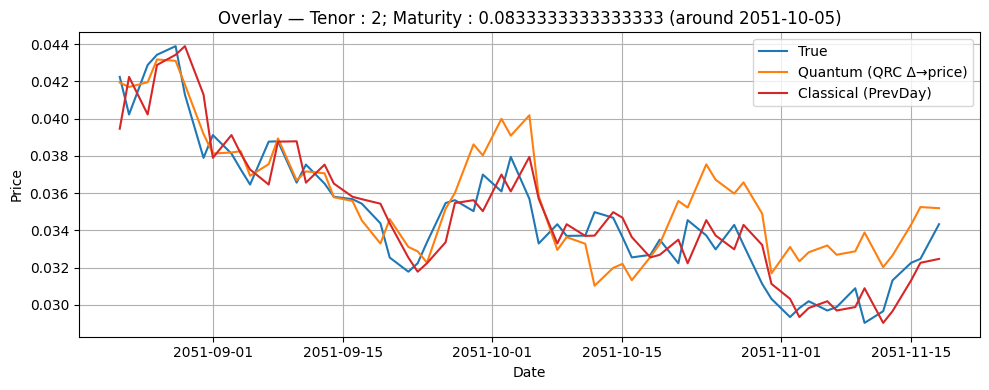

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_420.png


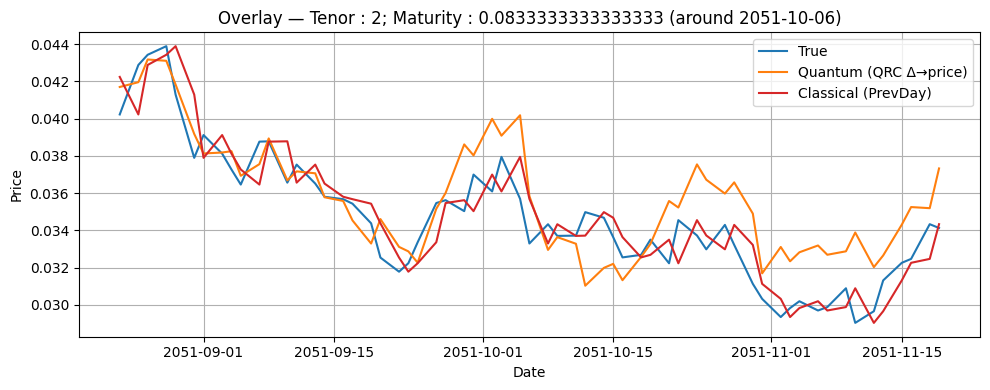

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_421.png


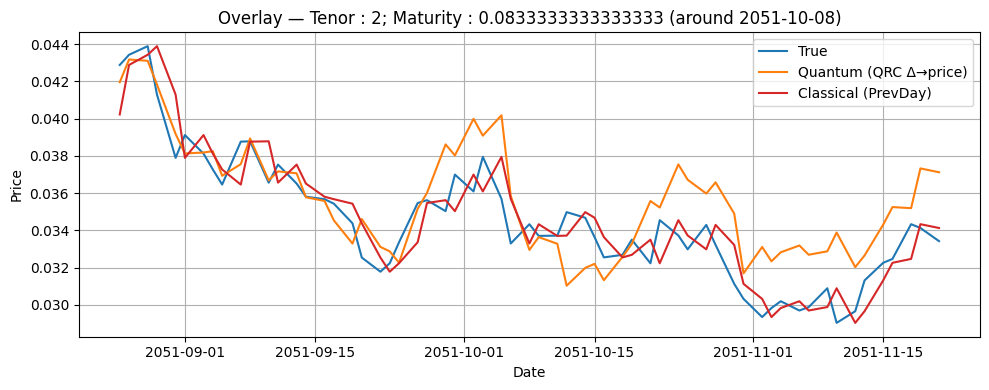

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_422.png


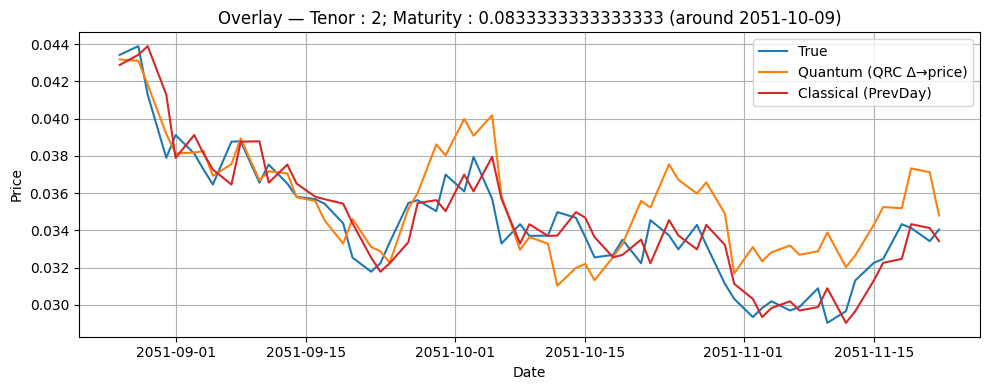

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_423.png


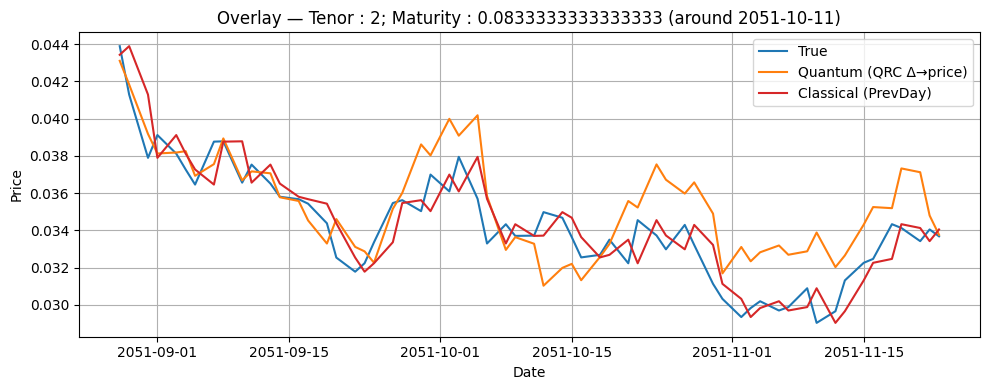

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_424.png


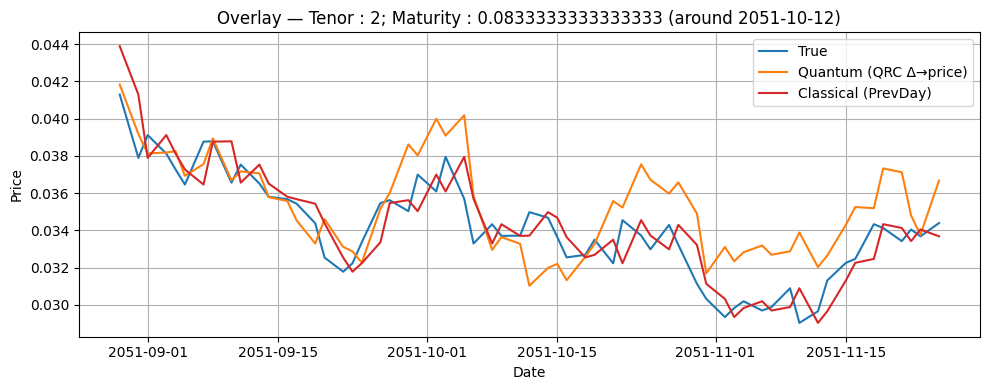

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_425.png


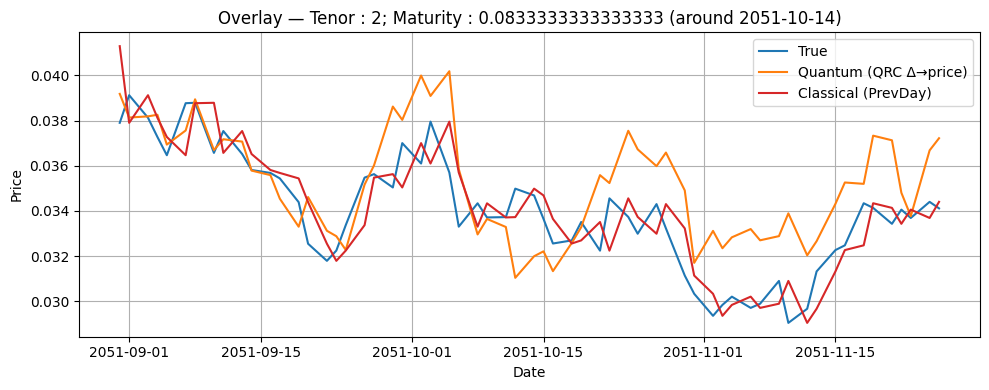

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_426.png


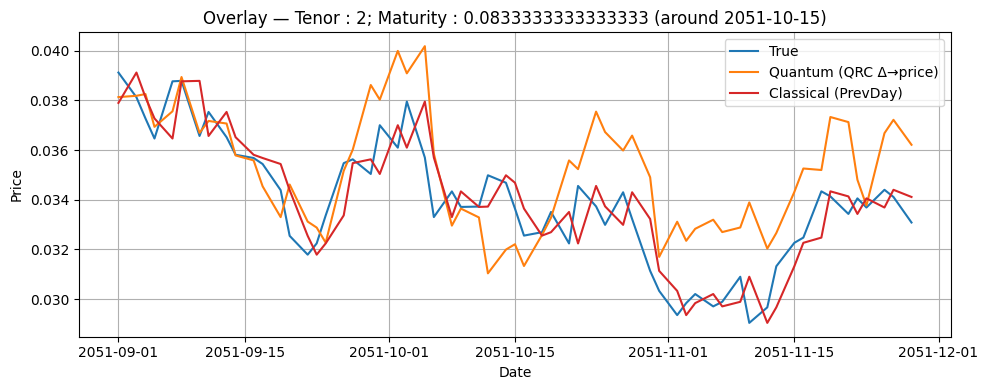

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_427.png


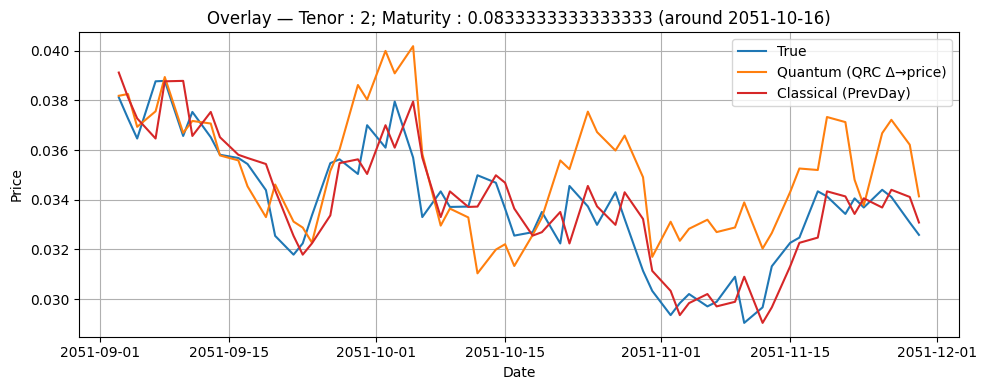

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_428.png


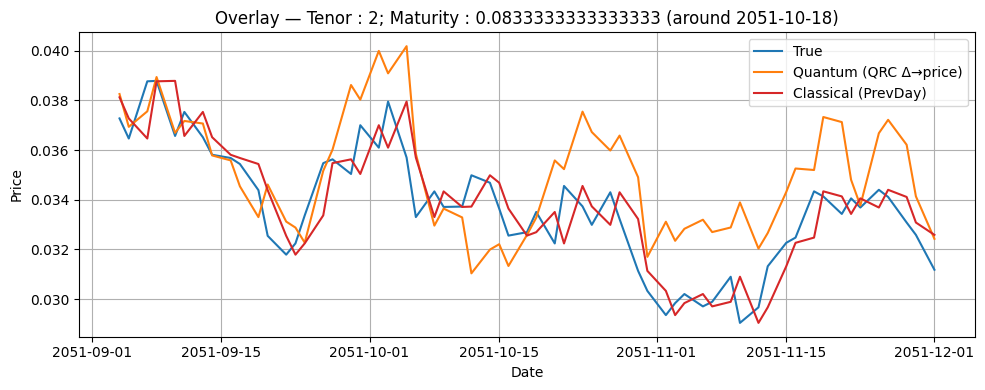

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_429.png


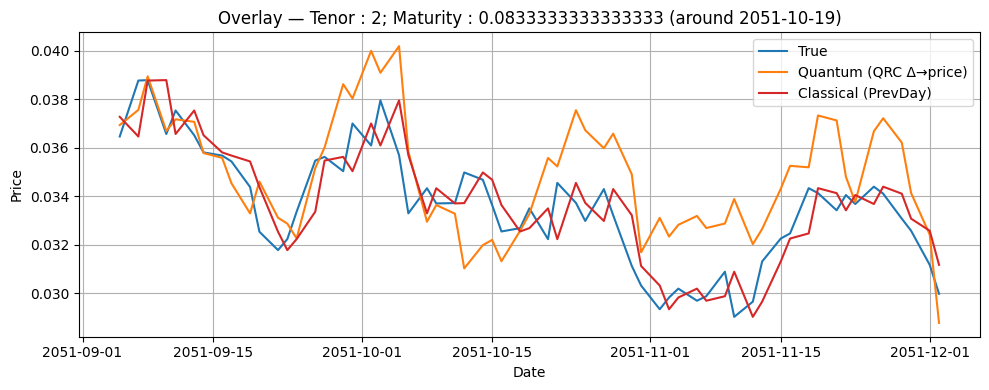

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_430.png


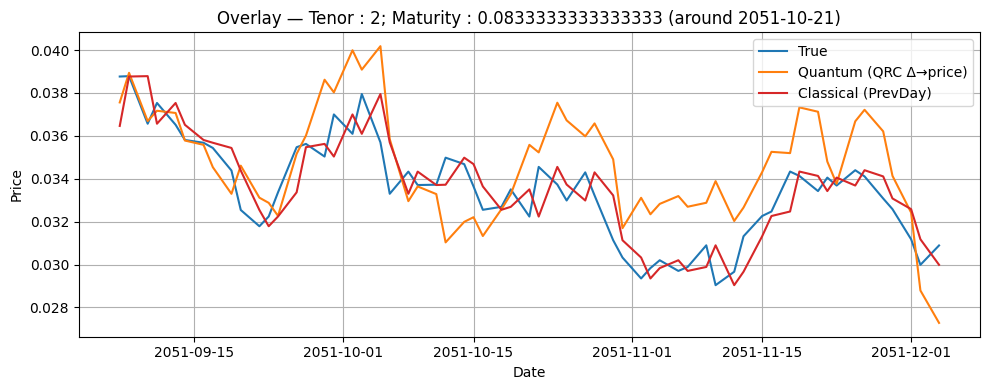

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_431.png


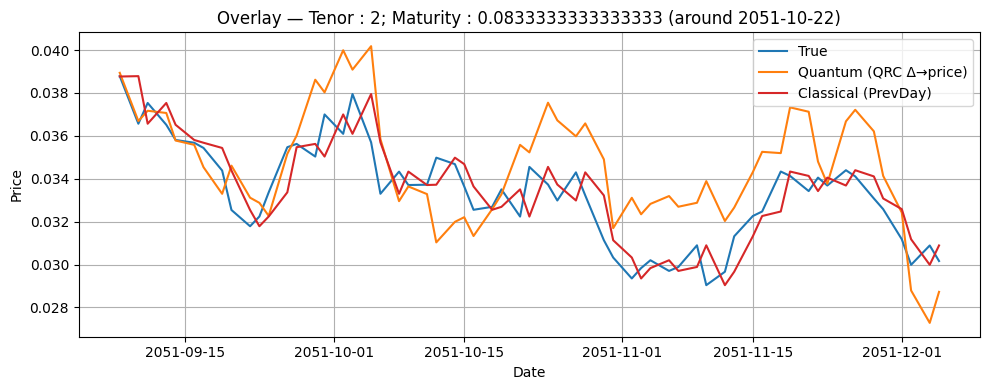

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_432.png


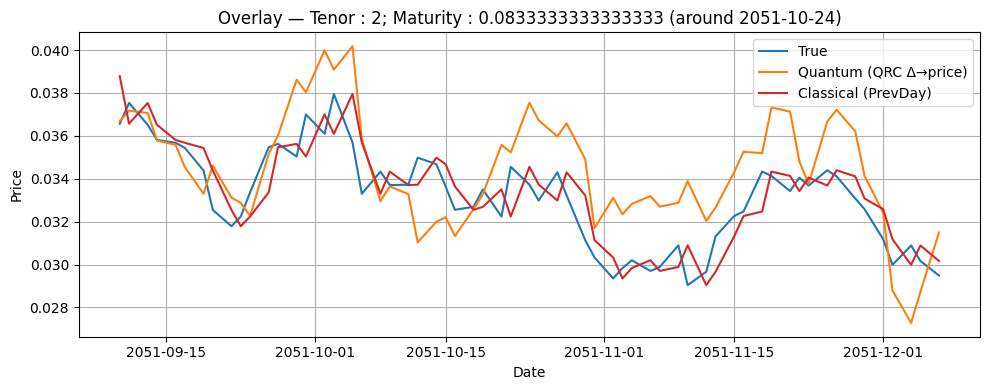

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_433.png


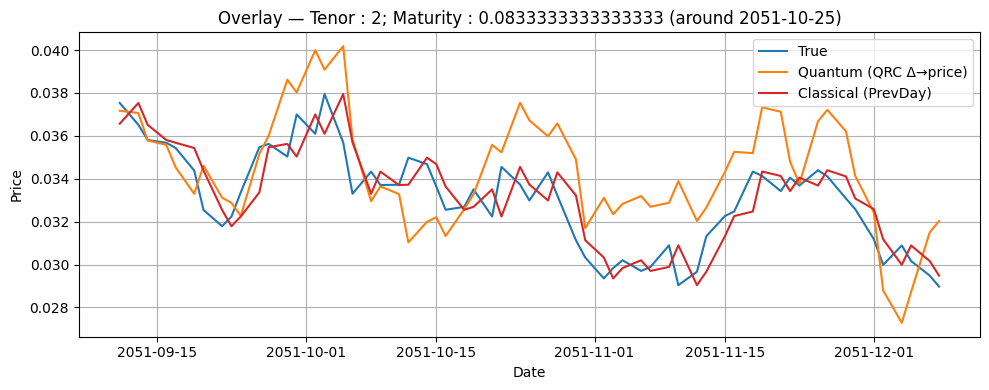

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_434.png


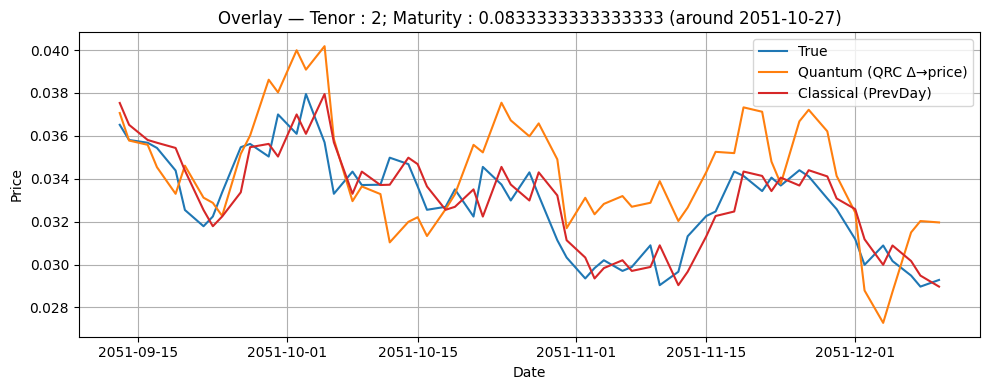

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_435.png


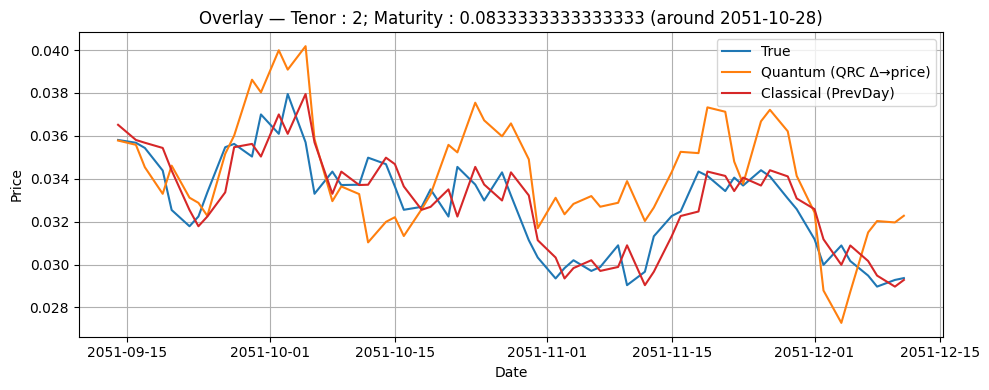

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_436.png


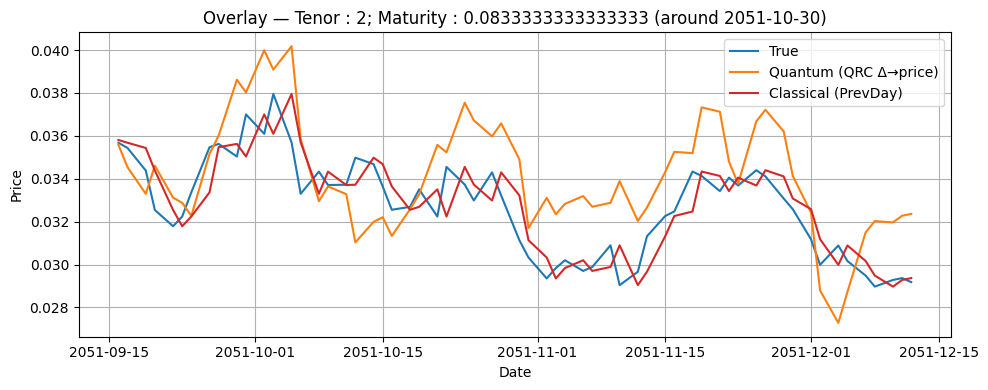

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_437.png


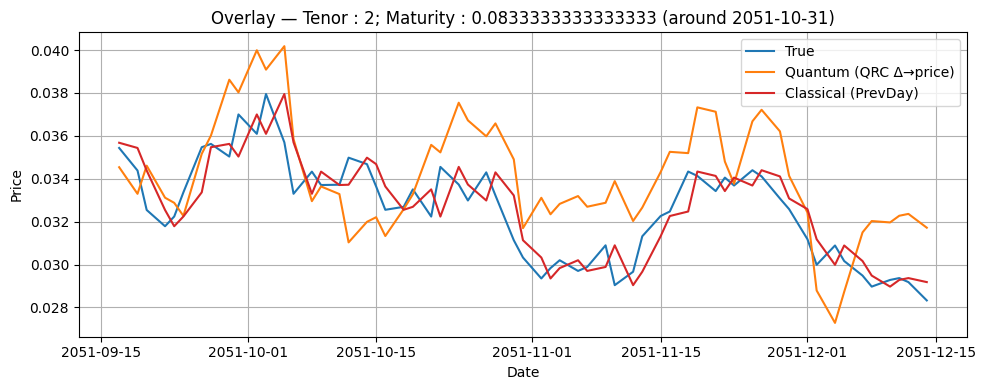

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_438.png


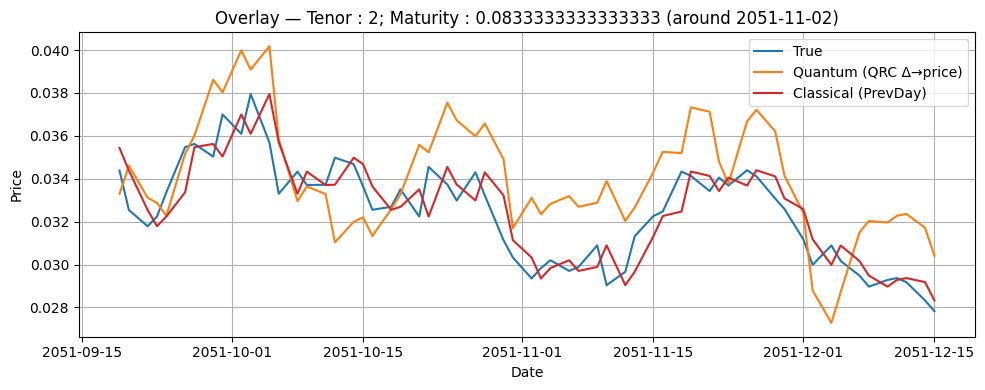

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_439.png


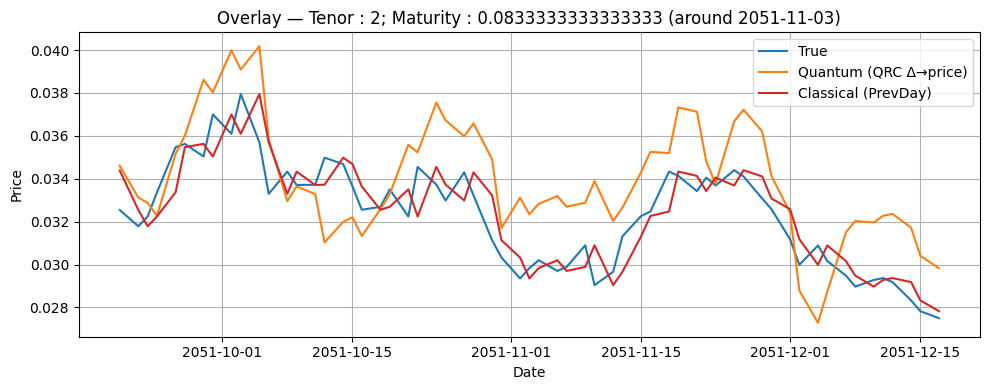

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_440.png


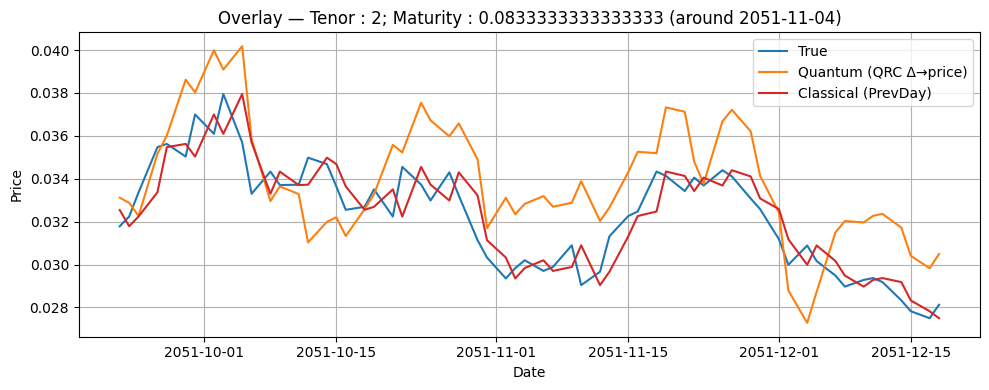

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_441.png


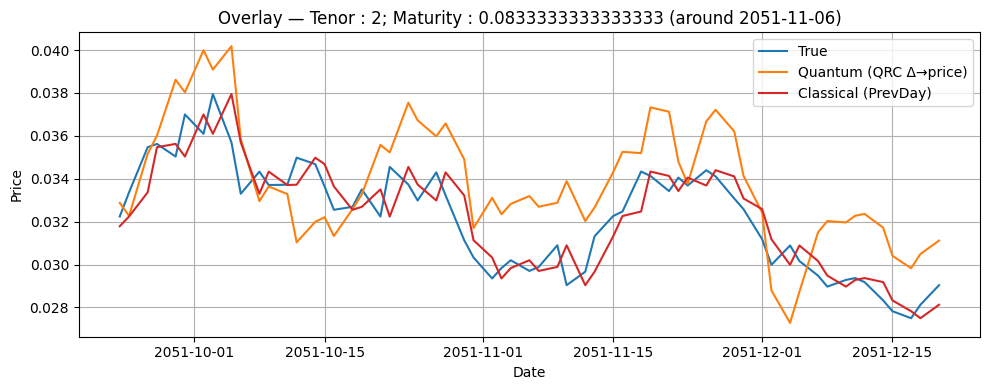

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_442.png


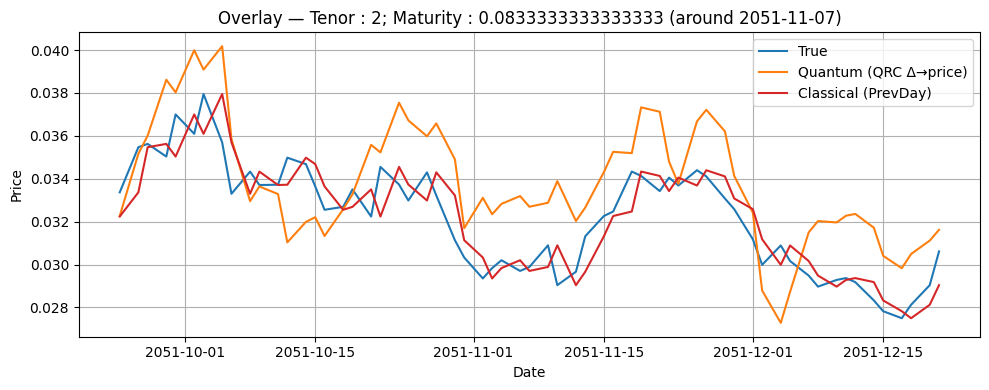

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_443.png


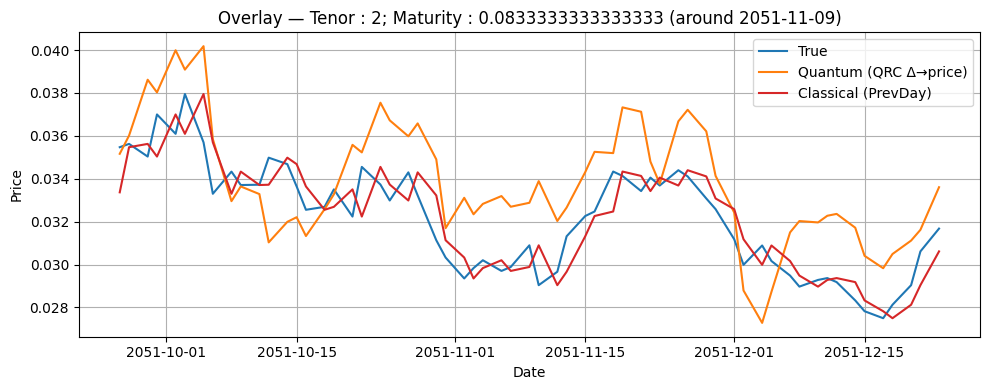

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_444.png


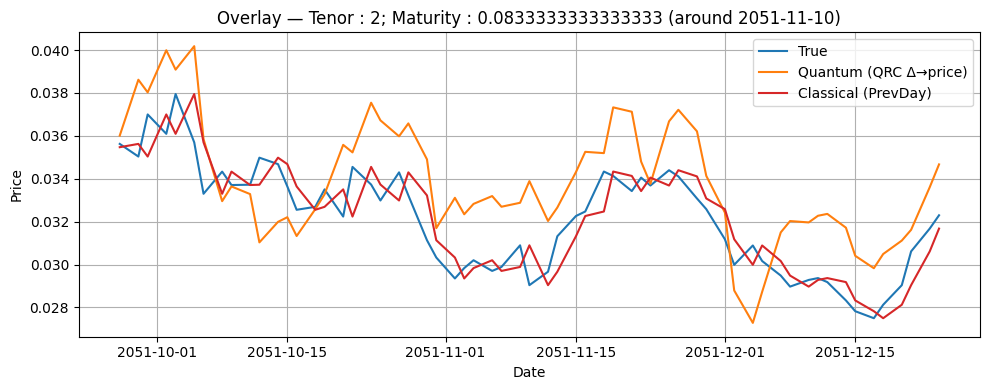

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_445.png


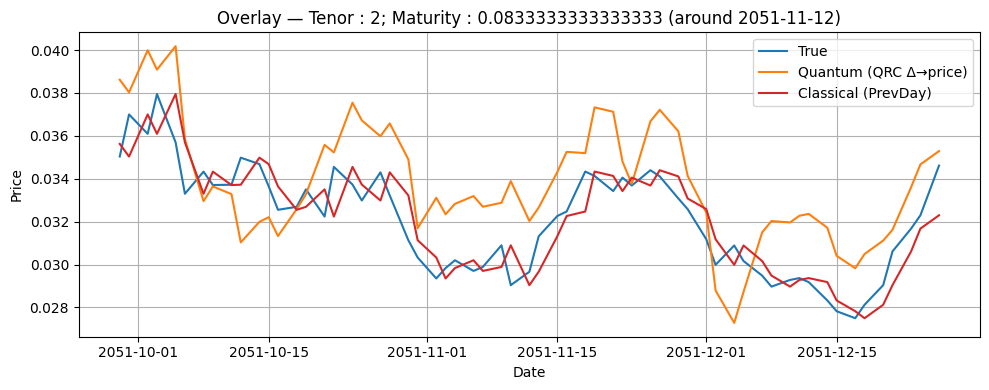

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_446.png


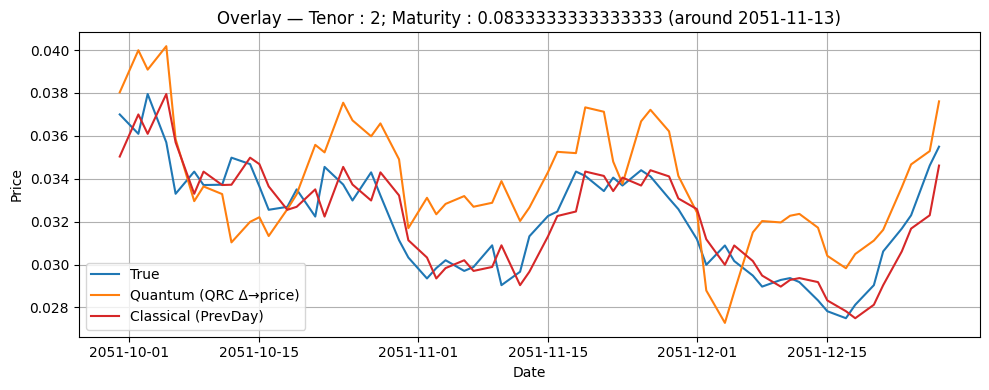

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_447.png


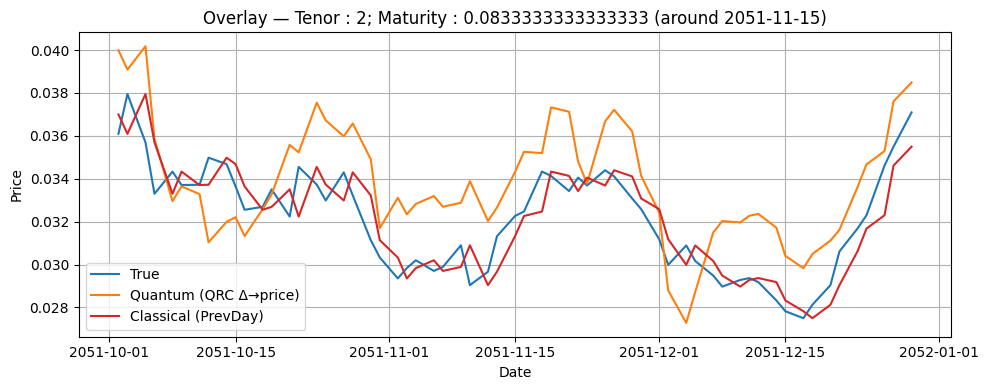

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_448.png


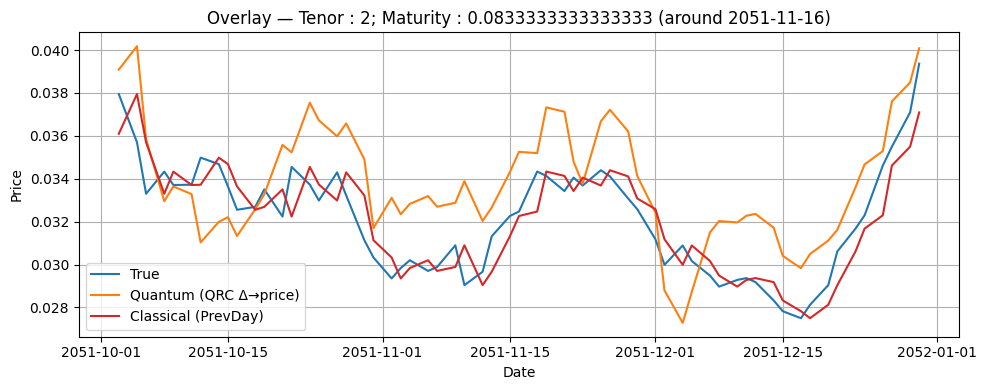

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_449.png


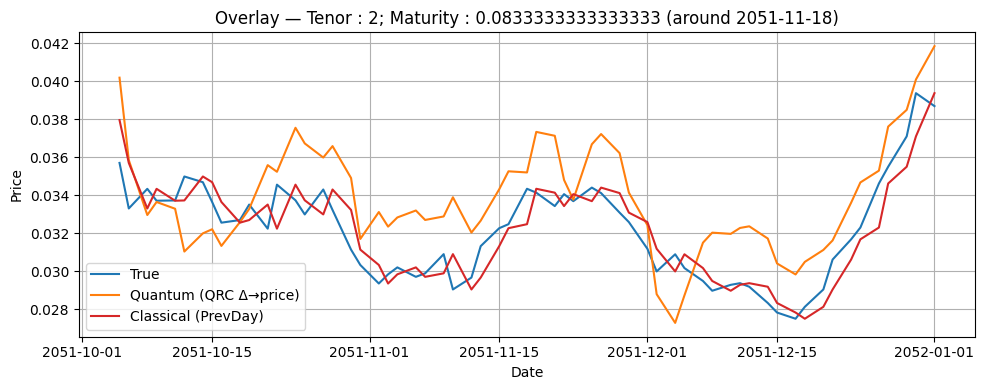

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_450.png


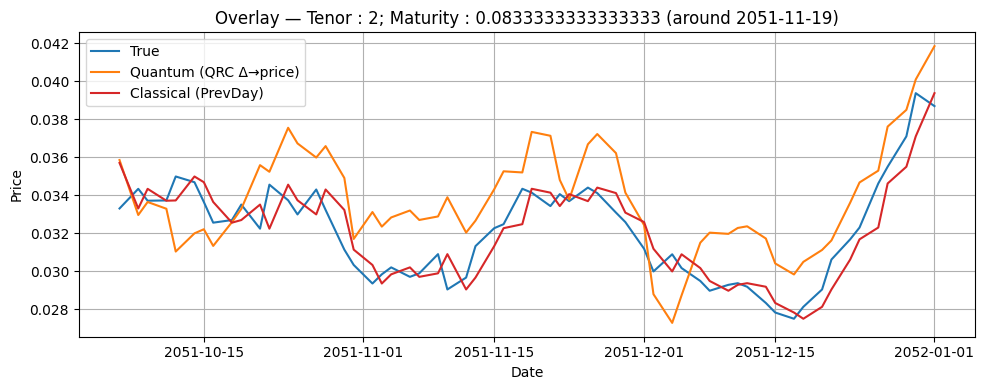

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_451.png


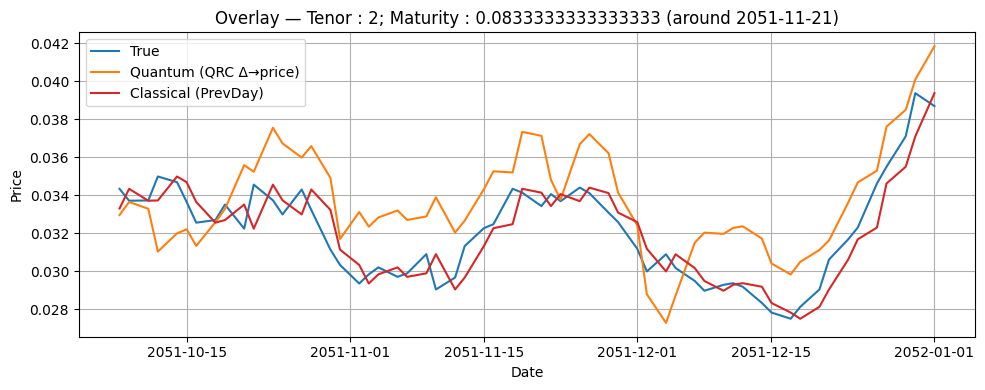

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_452.png


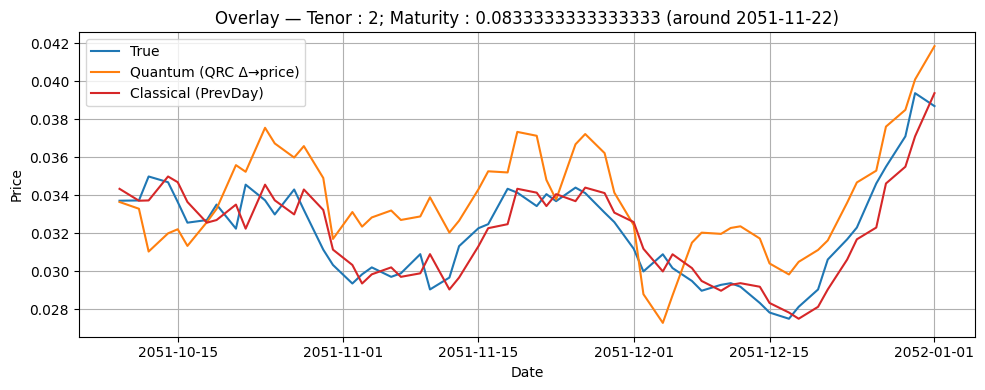

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_453.png


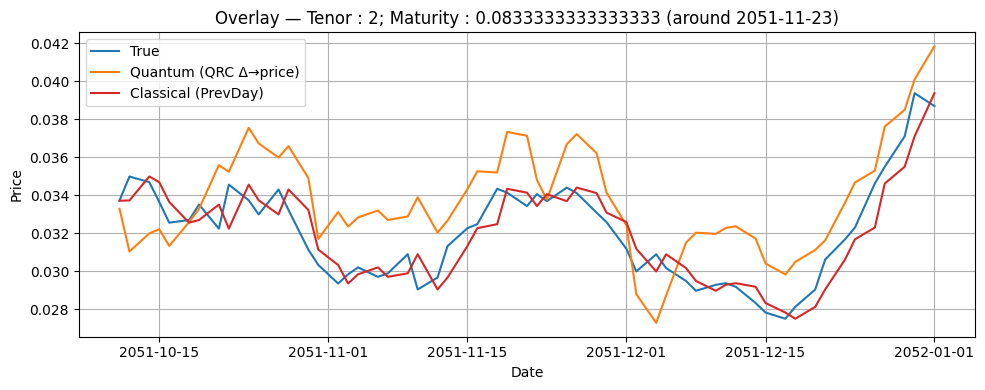

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_454.png


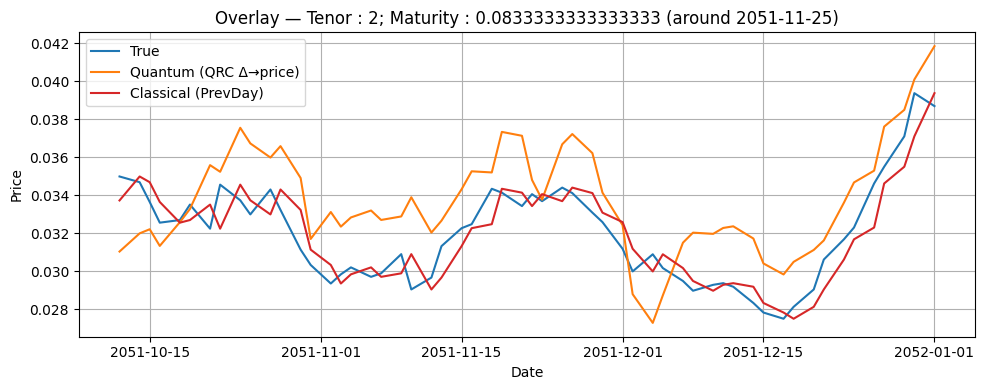

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_455.png


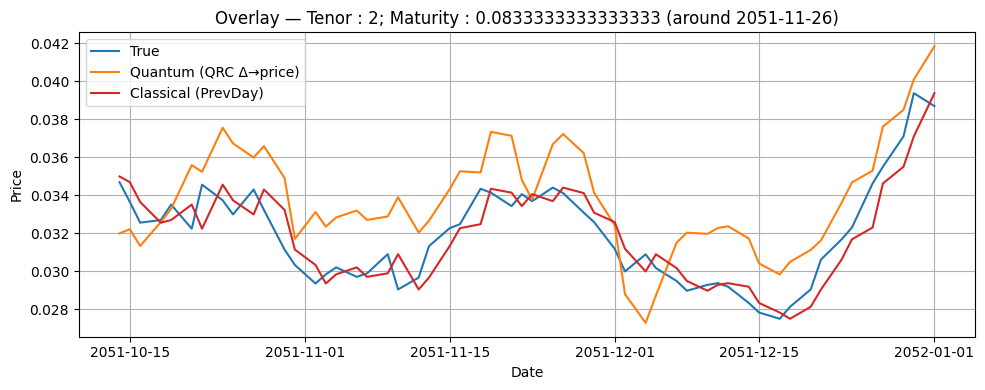

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_456.png


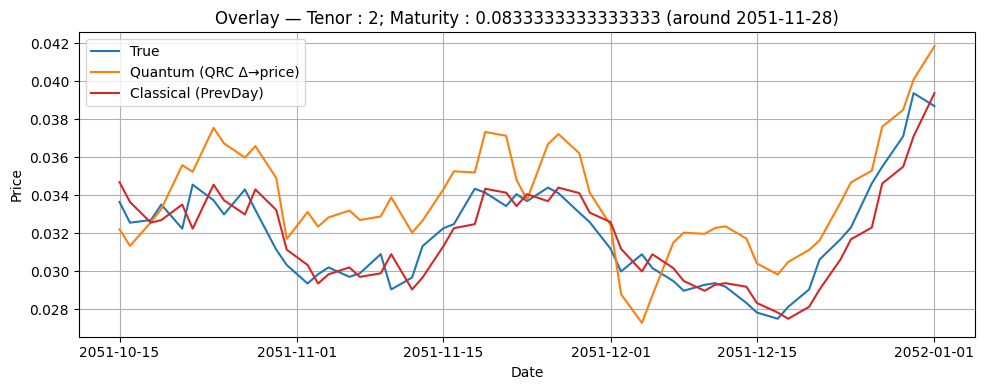

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_457.png


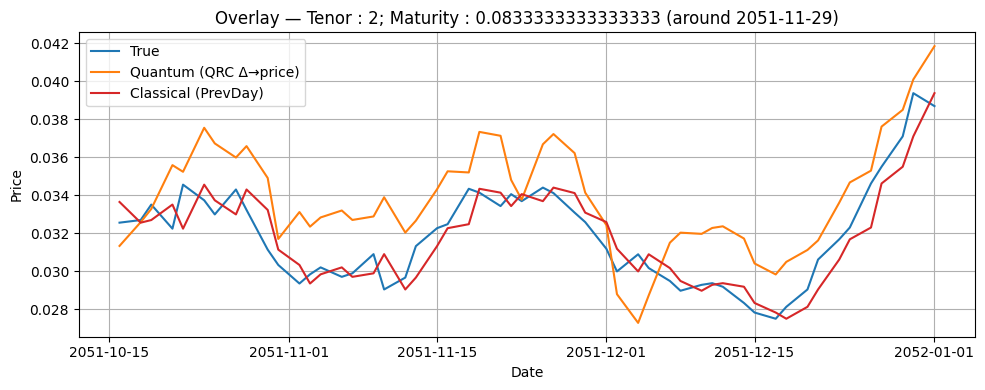

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_458.png


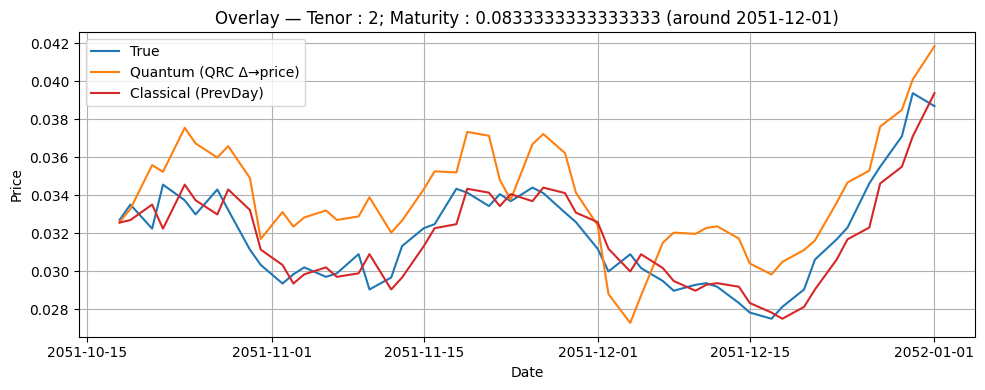

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_459.png


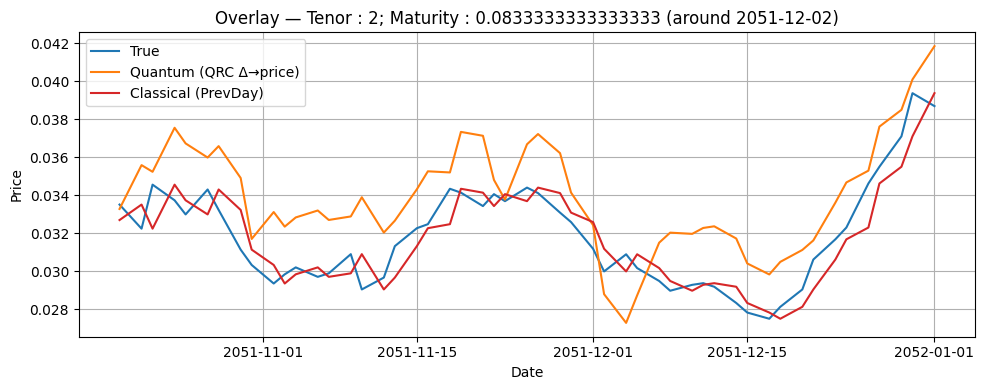

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_460.png


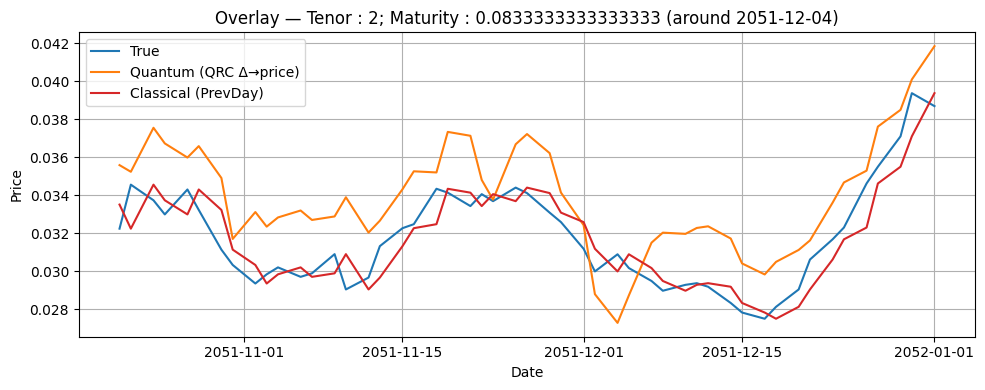

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_461.png


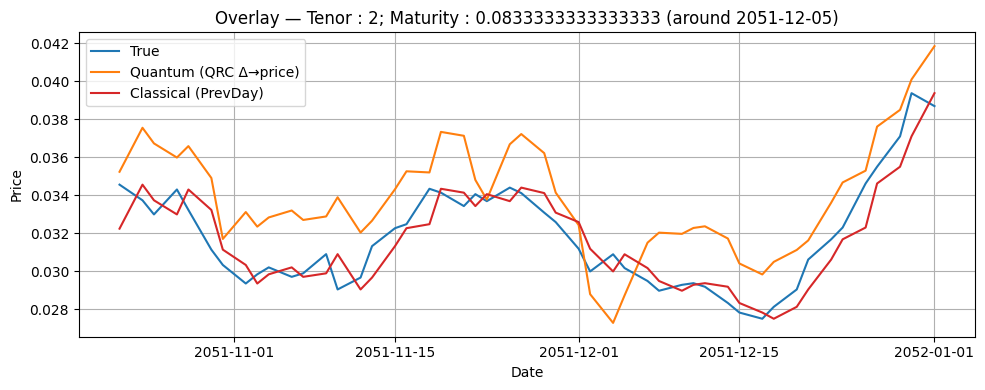

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_462.png


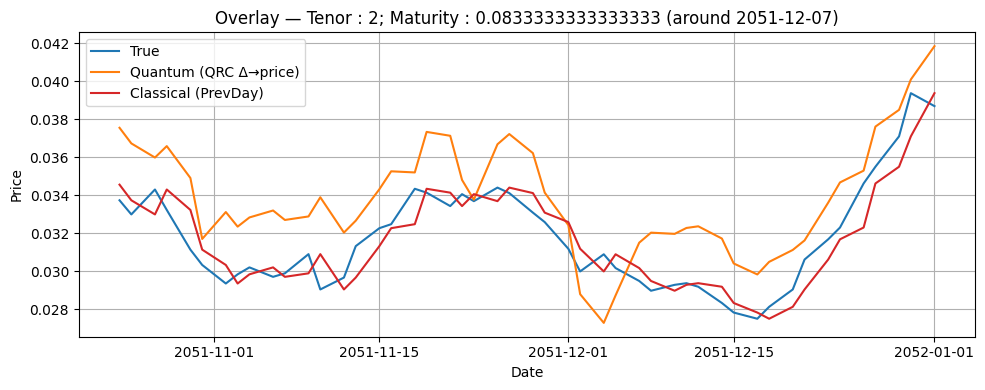

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_463.png


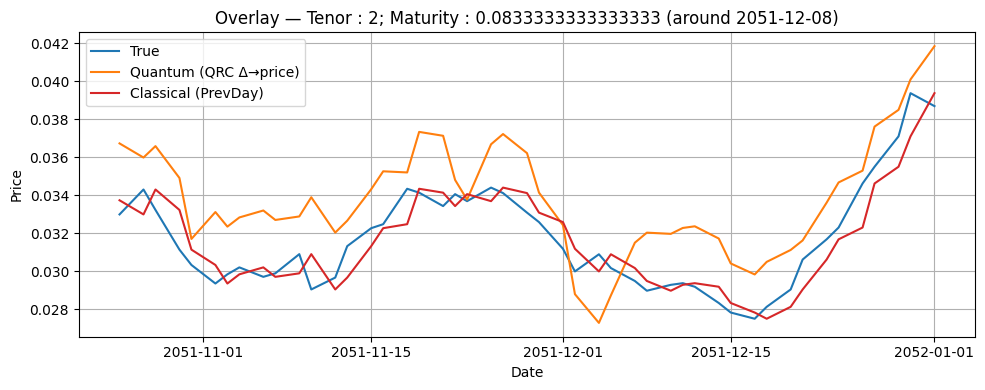

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_464.png


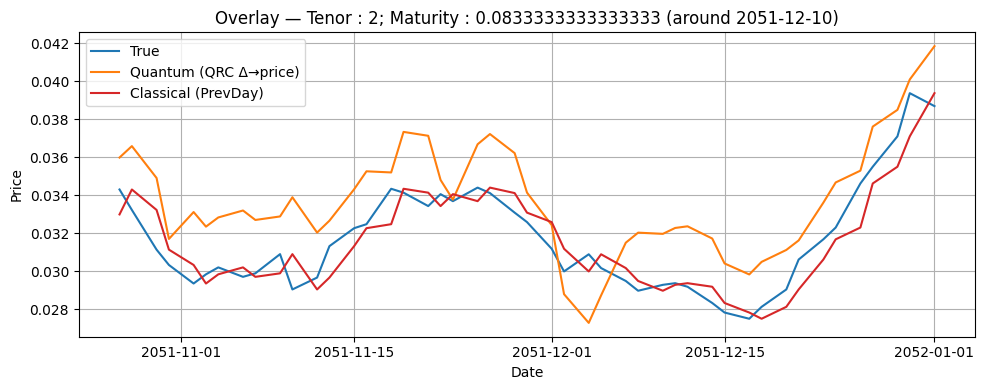

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_465.png


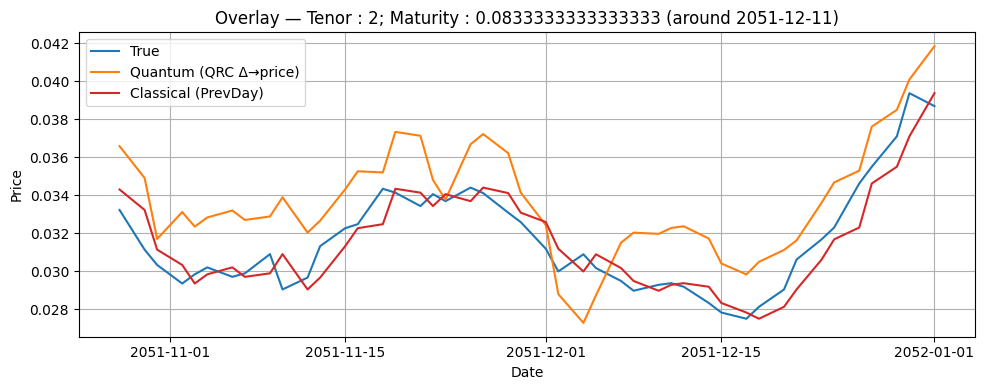

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_466.png


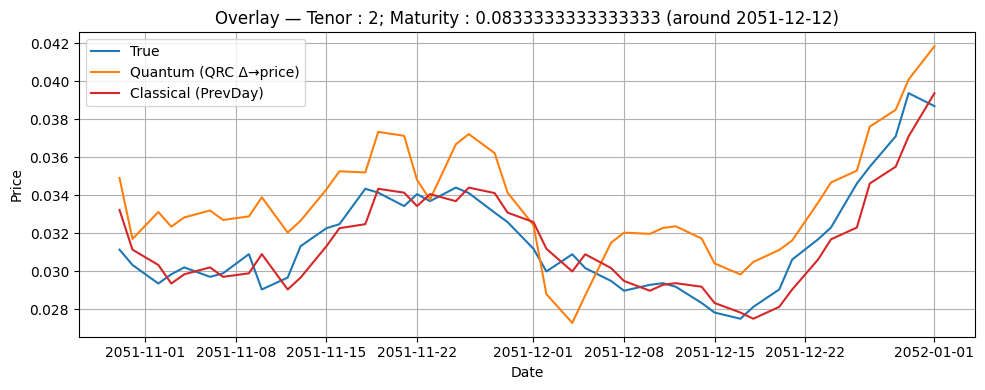

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_467.png


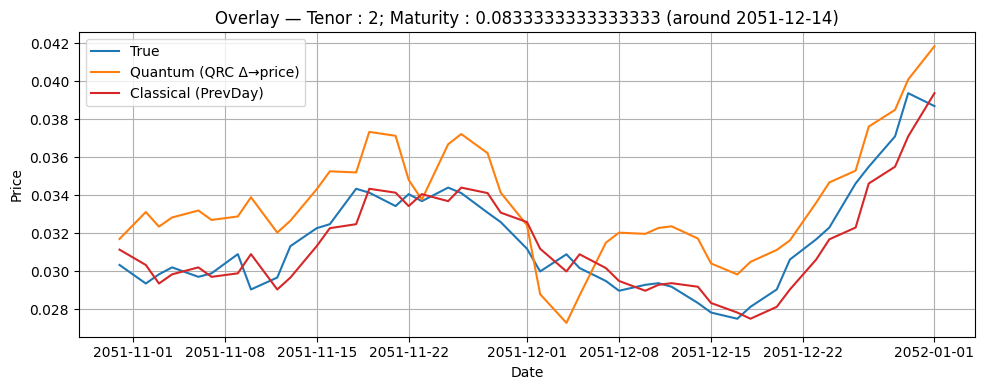

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_468.png


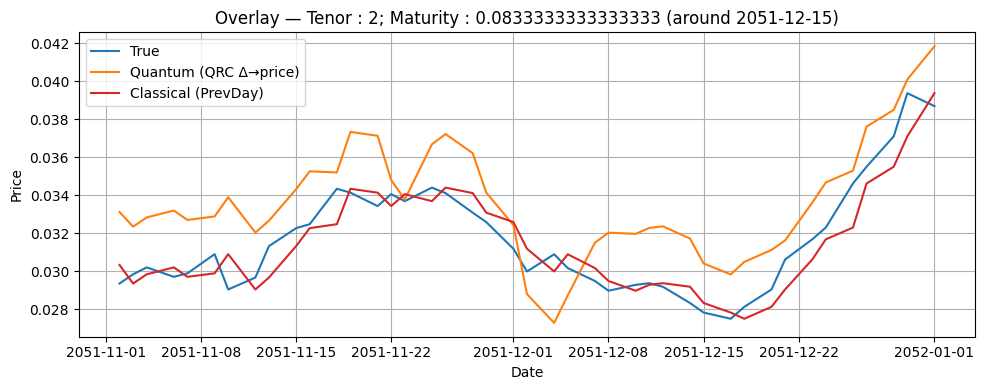

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_469.png


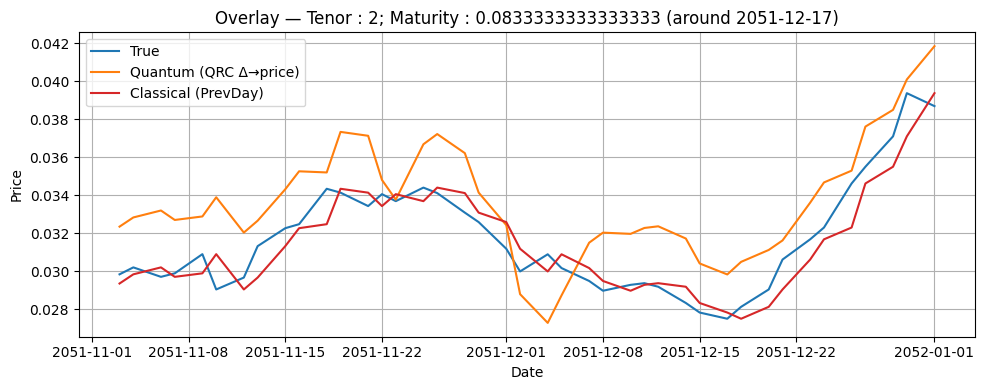

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_470.png


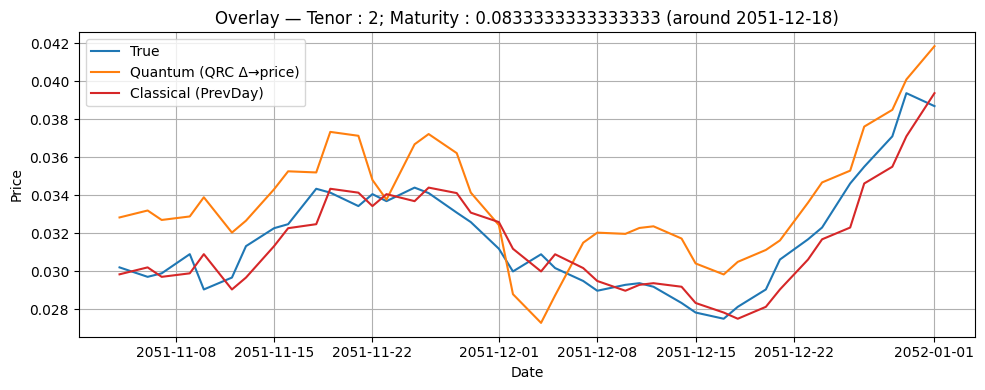

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_471.png


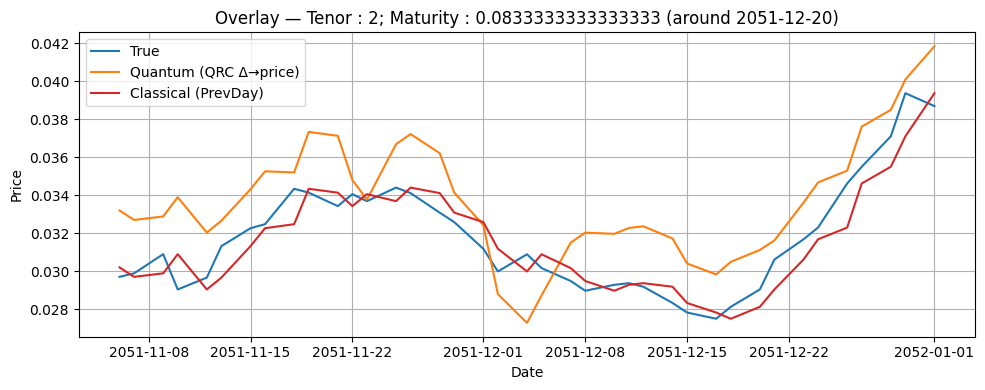

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_472.png


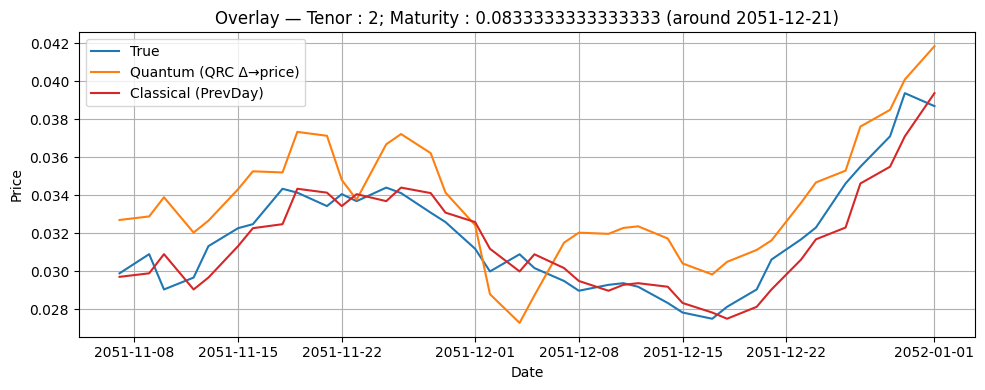

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_473.png


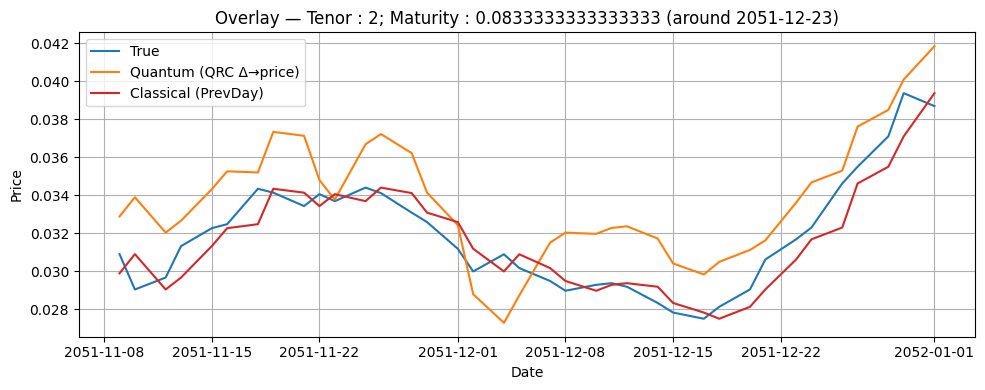

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_474.png


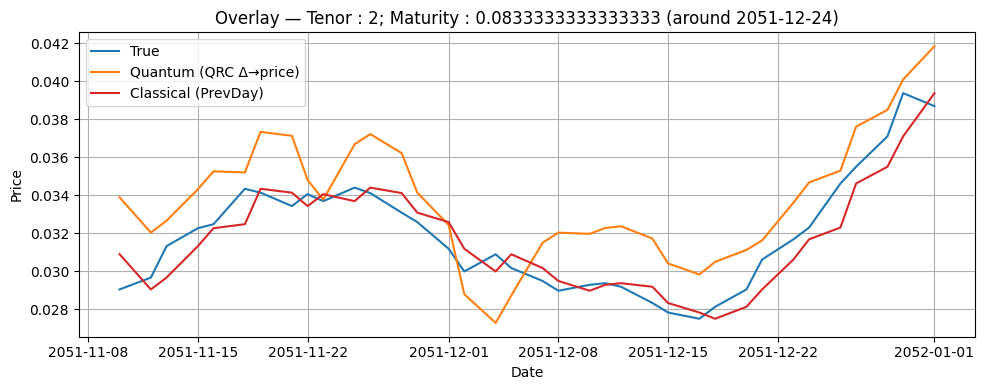

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_475.png


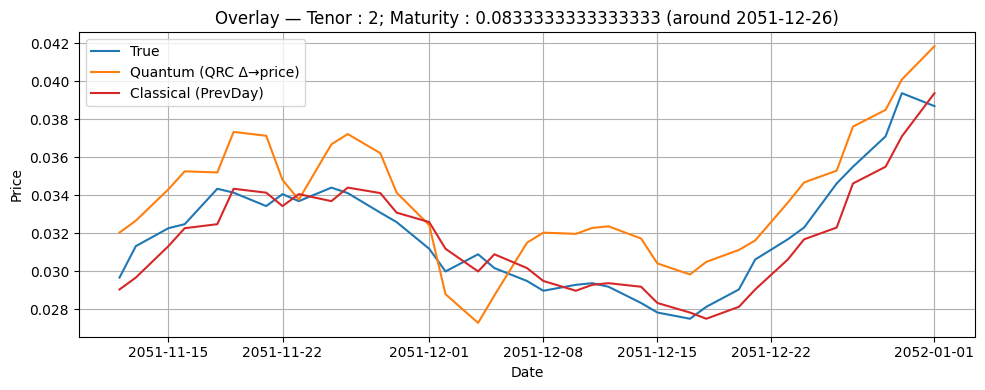

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_476.png


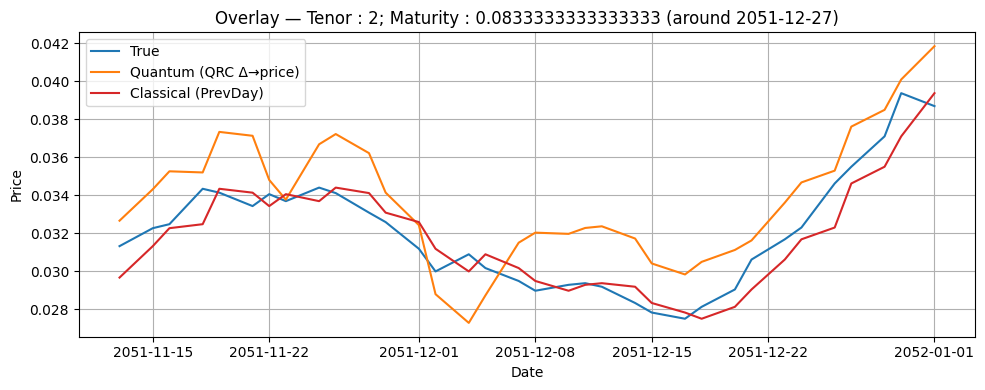

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_477.png


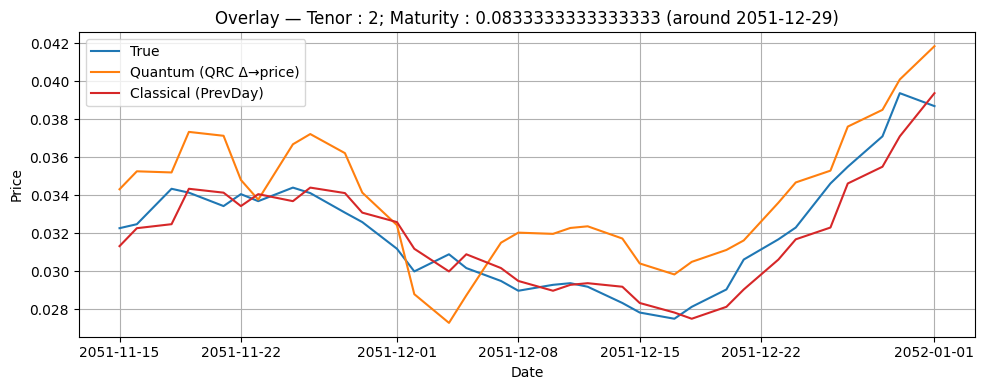

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_478.png


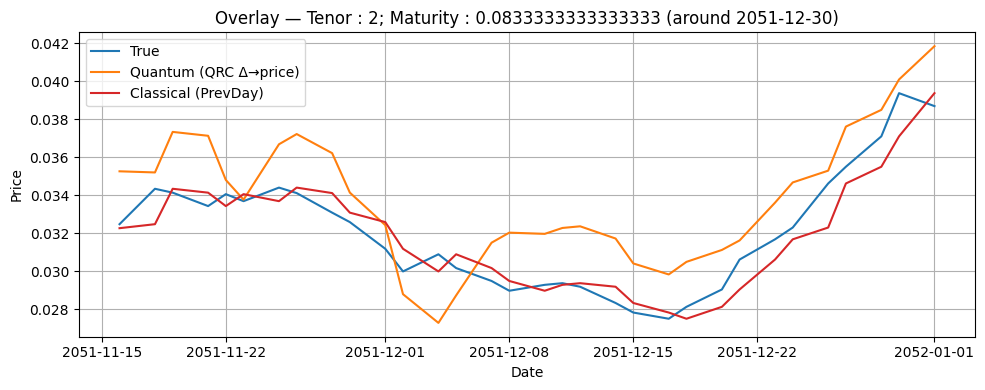

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 2; Maturity _ 0.0833333333333333_at_479.png


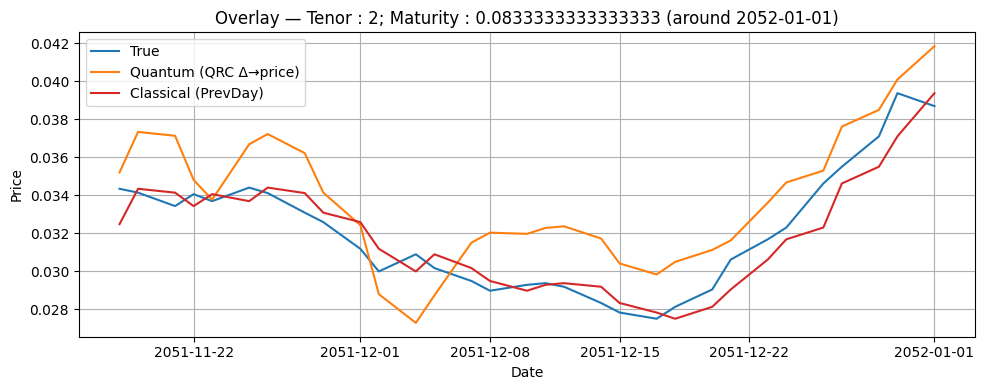

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_408.png


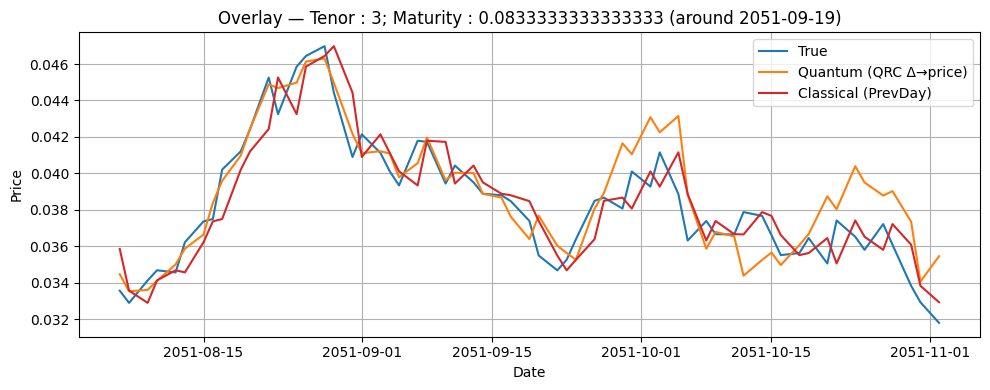

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_409.png


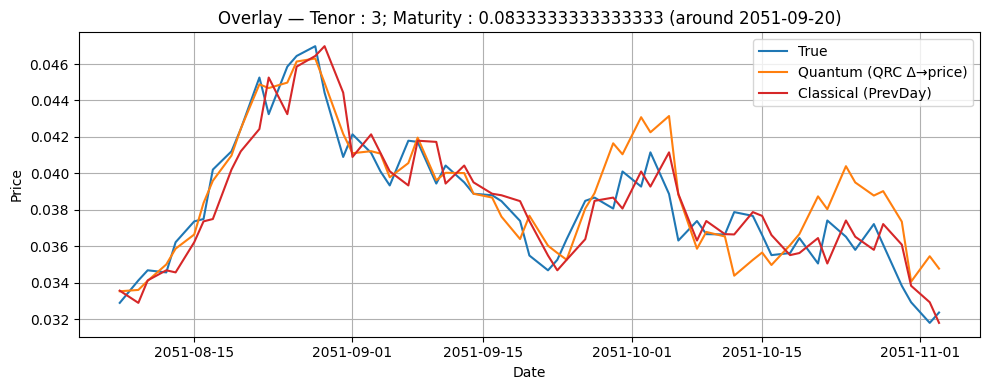

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_410.png


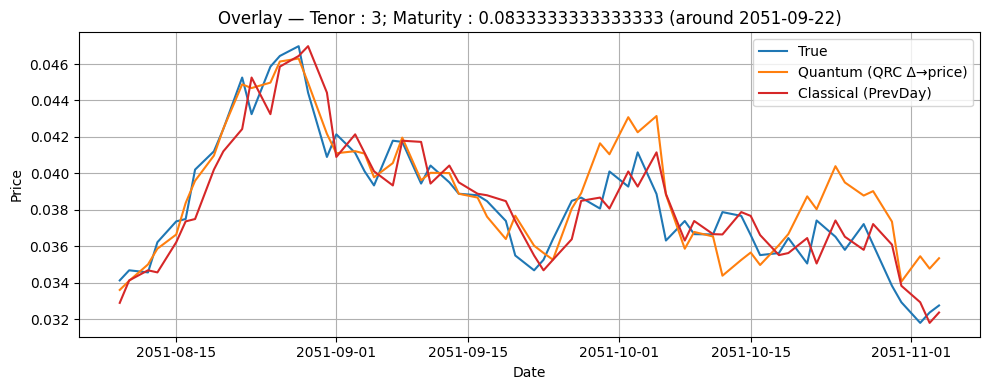

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_411.png


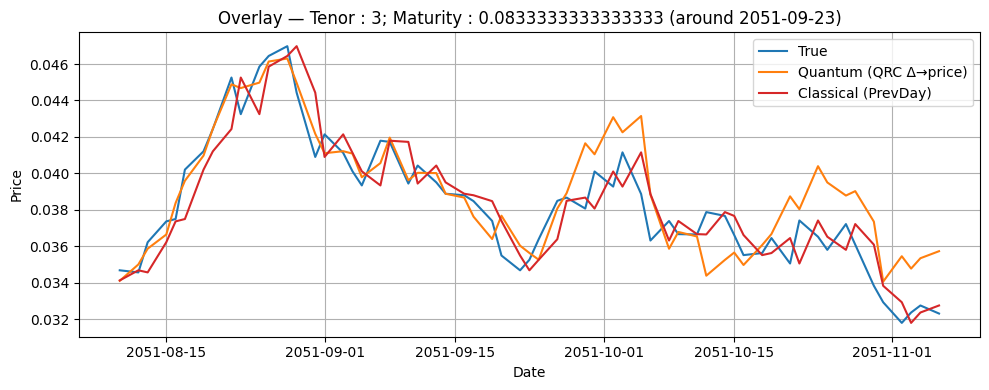

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_412.png


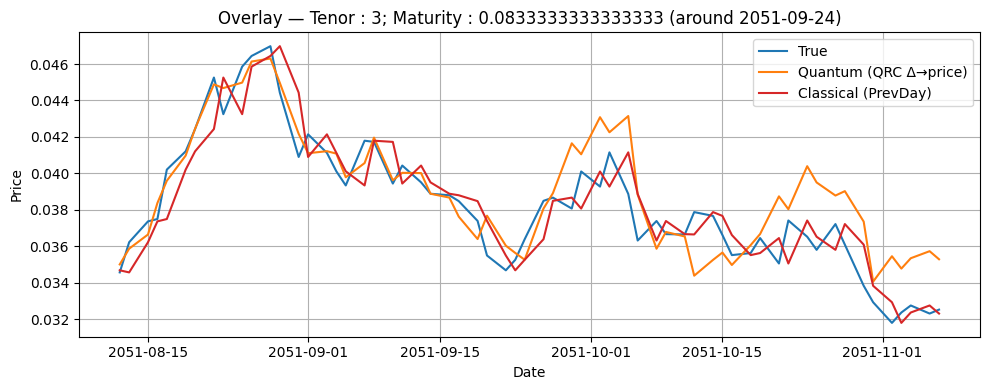

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_413.png


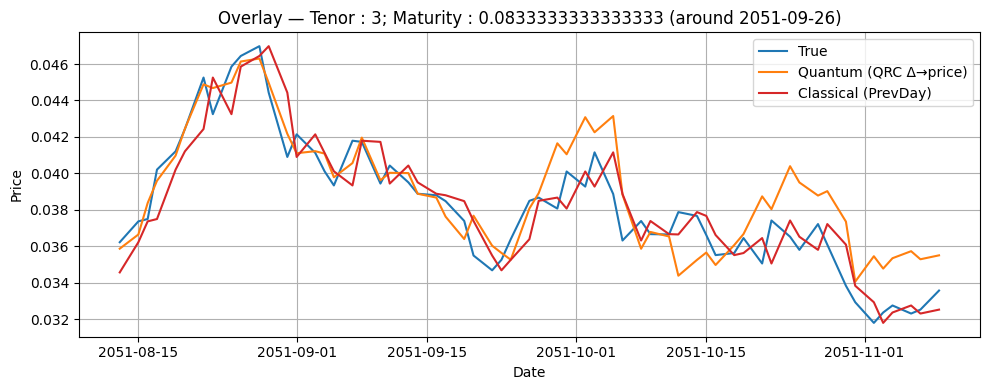

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_414.png


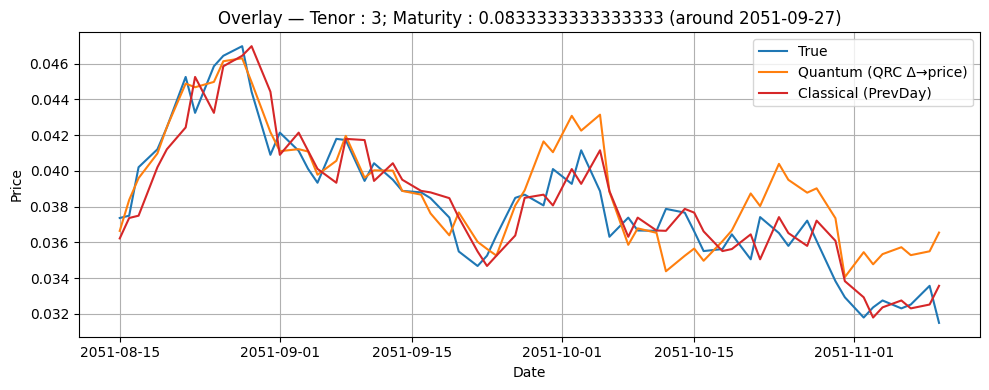

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_415.png


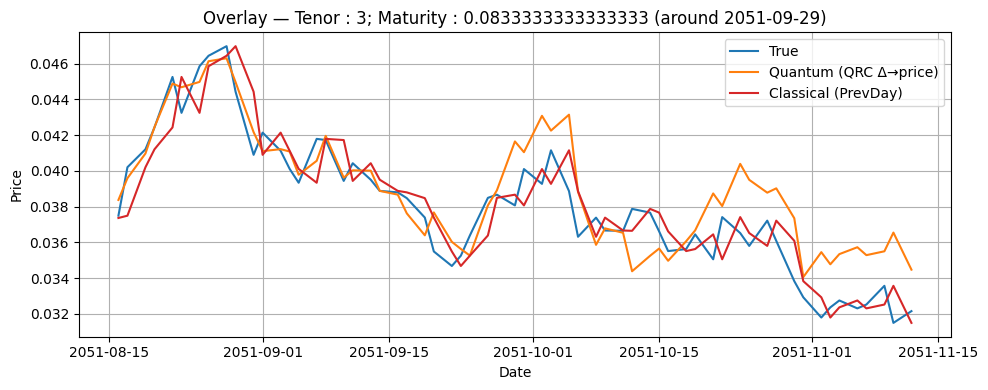

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_416.png


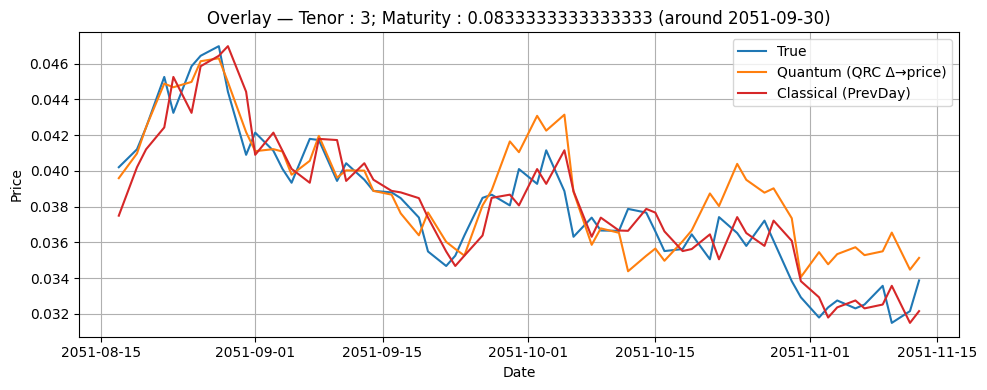

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_417.png


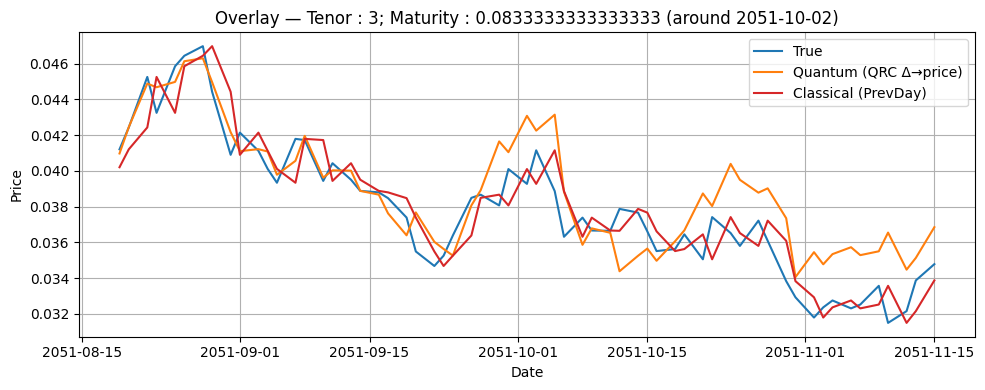

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_418.png


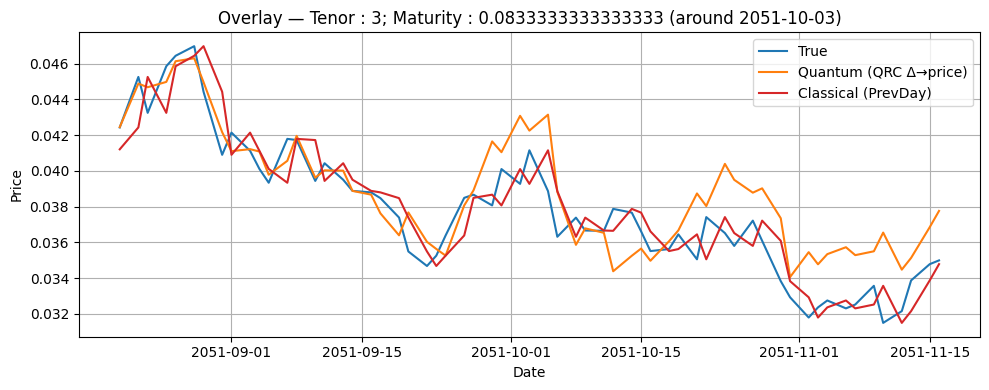

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_419.png


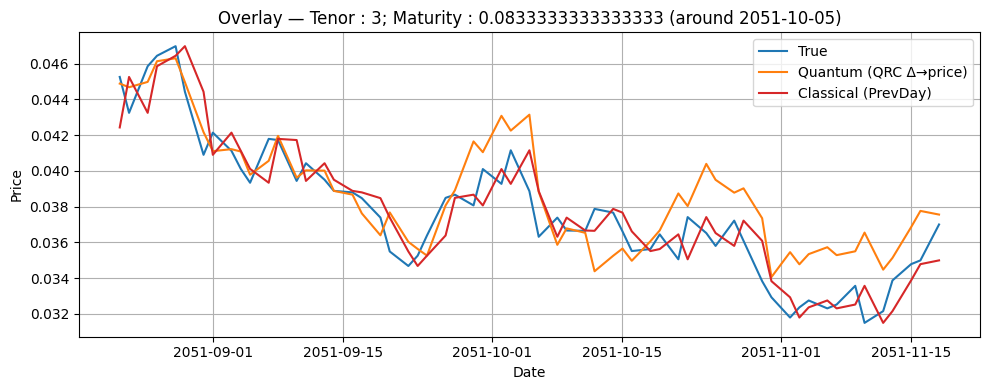

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_420.png


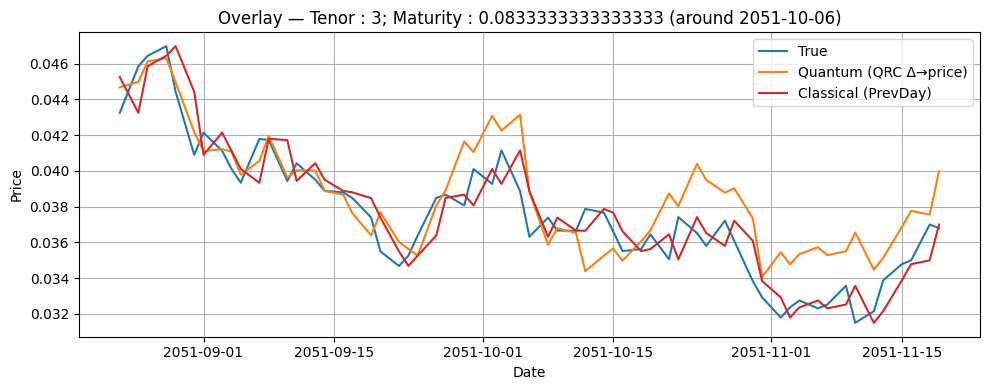

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_421.png


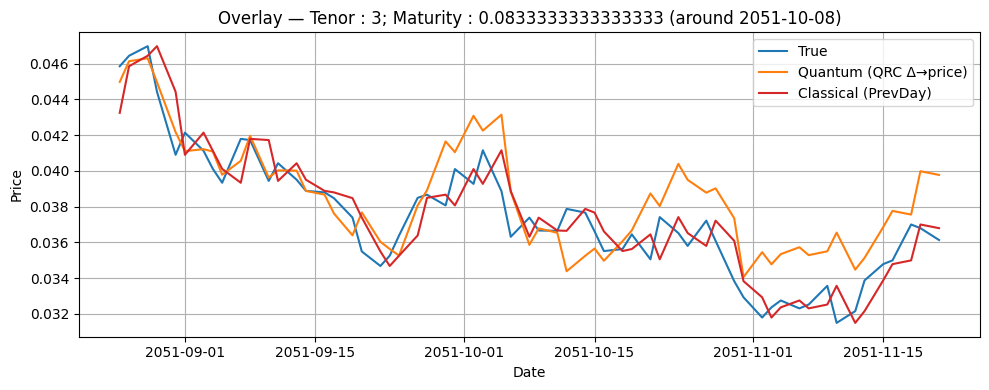

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_422.png


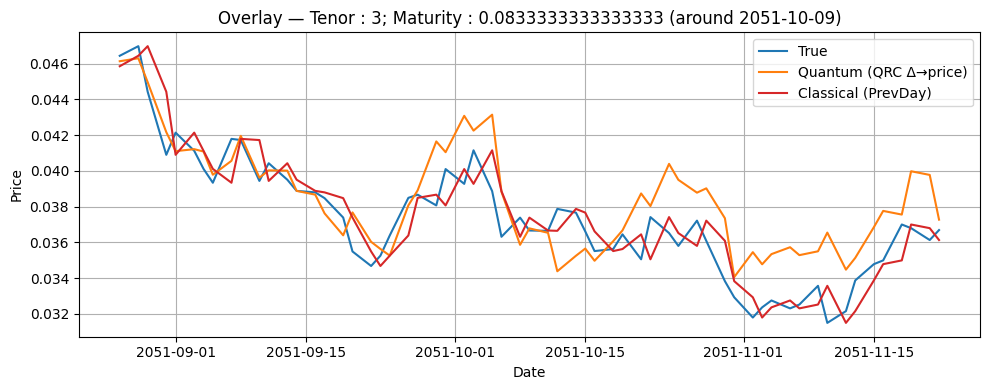

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_423.png


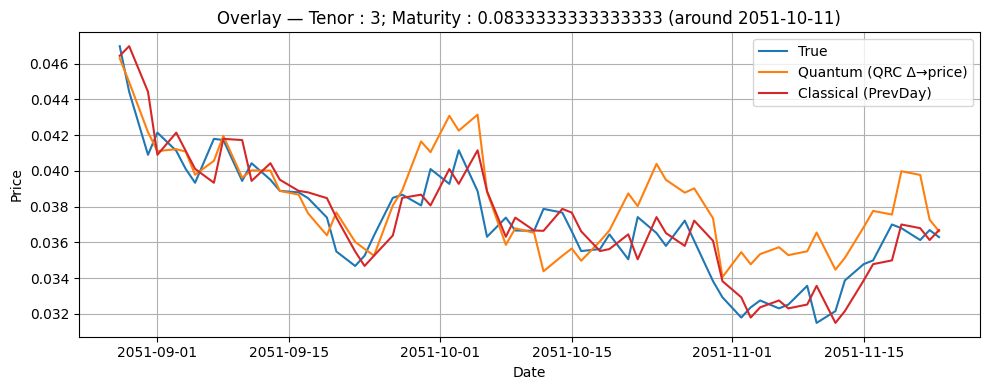

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_424.png


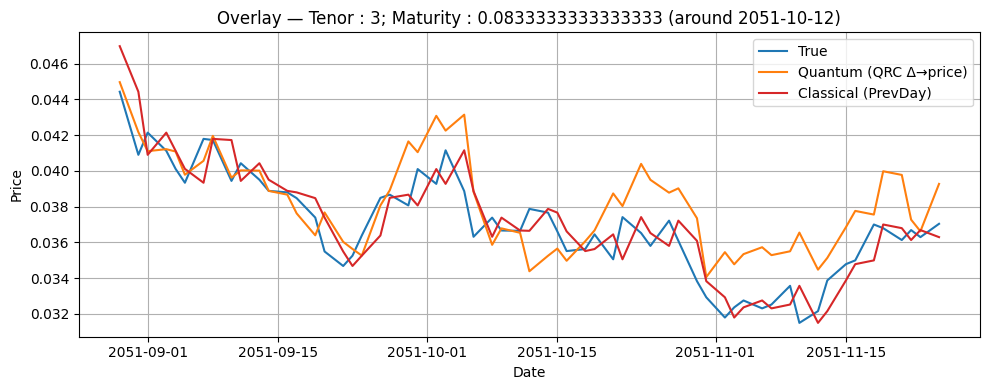

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_425.png


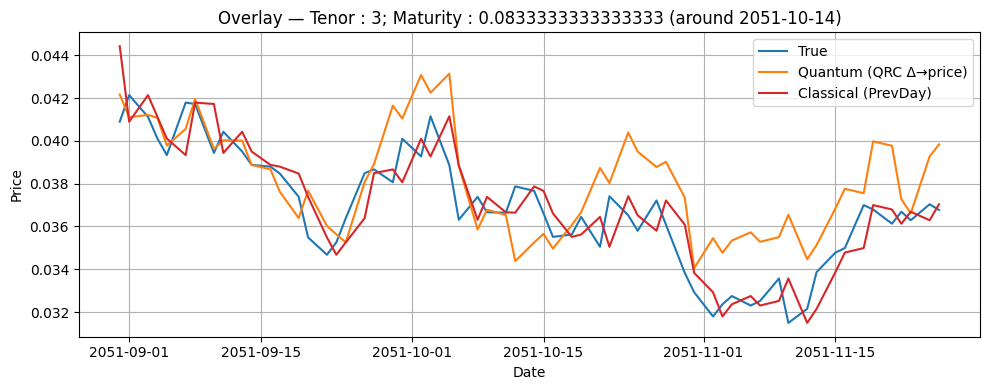

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_426.png


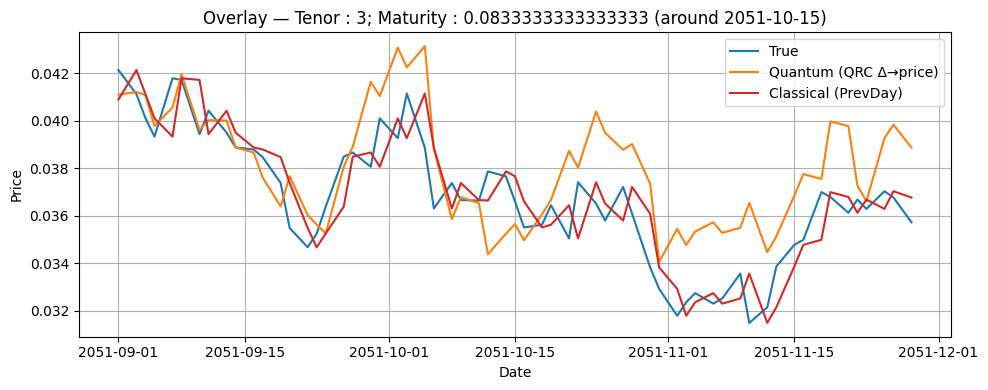

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_427.png


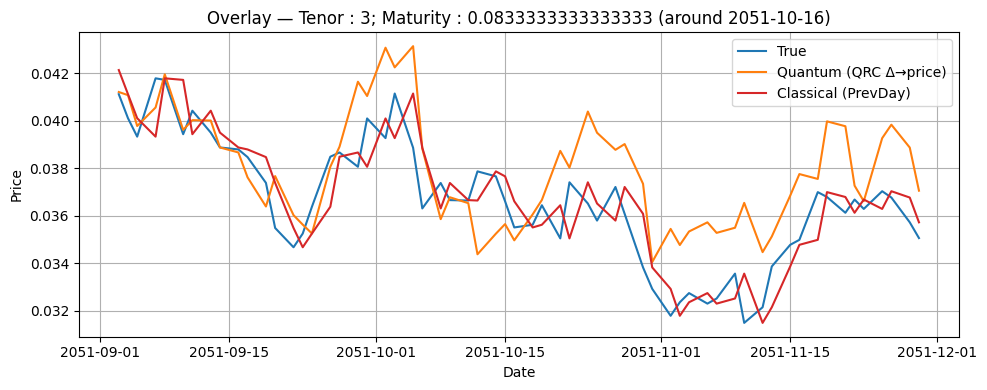

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_428.png


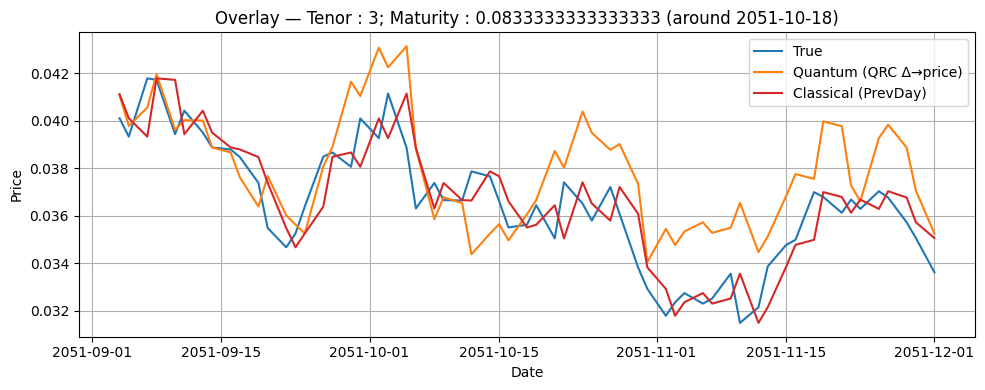

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_429.png


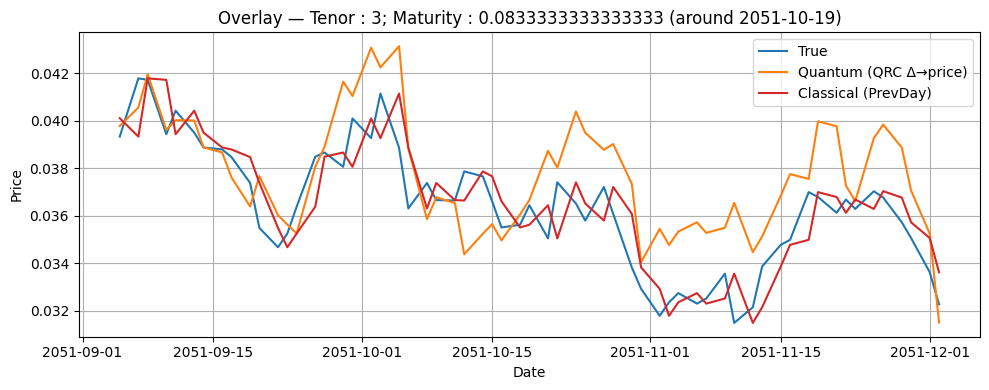

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_430.png


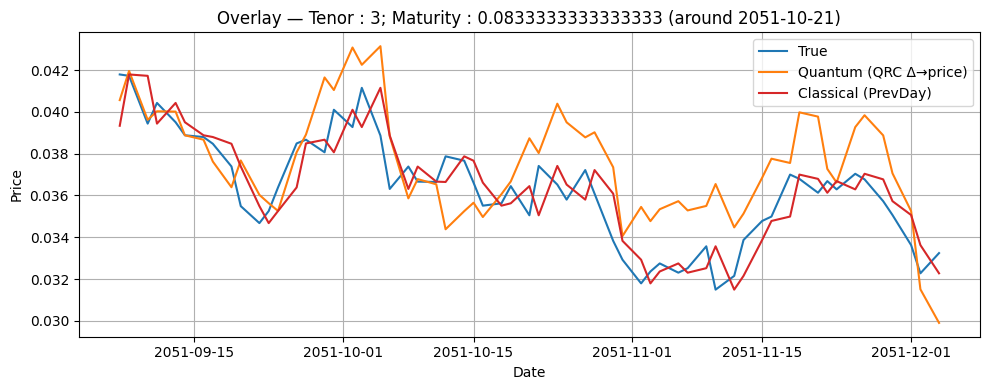

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_431.png


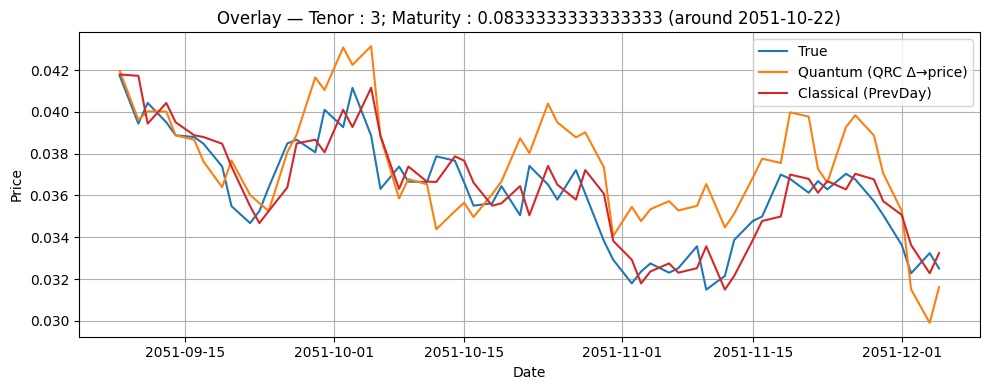

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_432.png


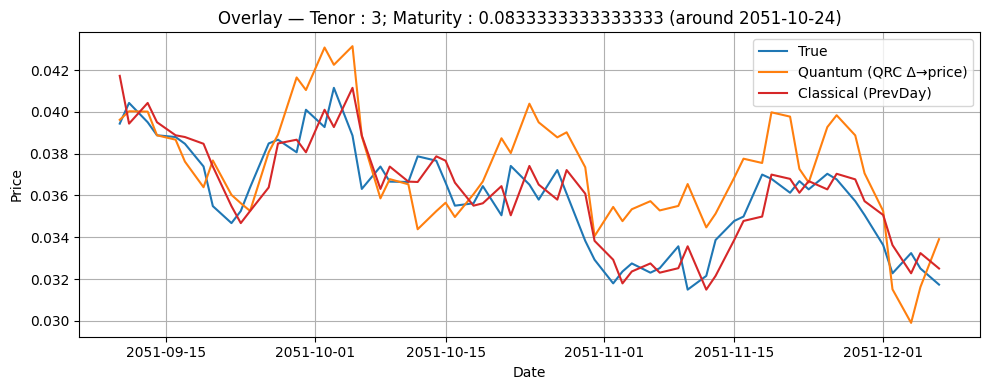

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_433.png


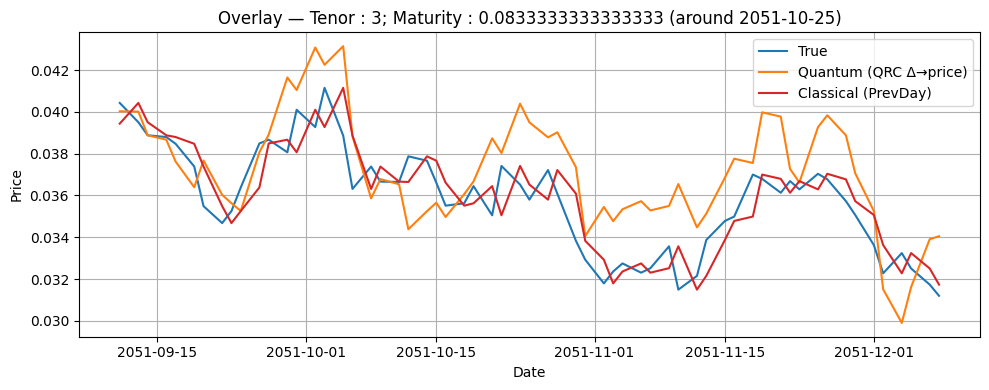

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_434.png


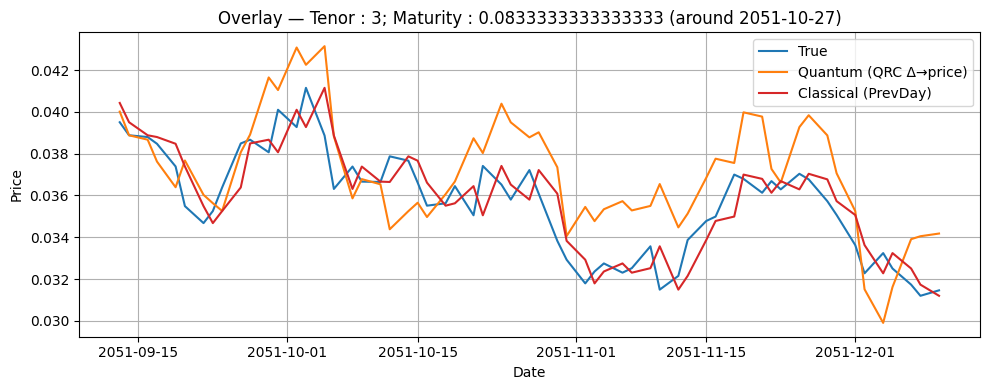

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_435.png


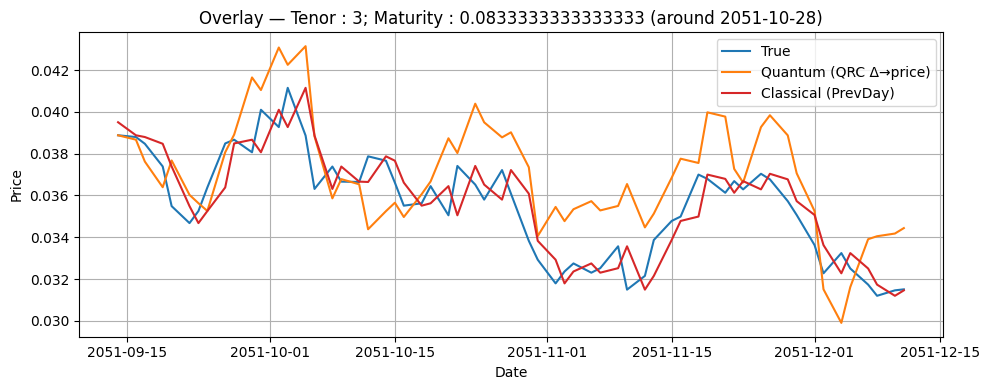

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_436.png


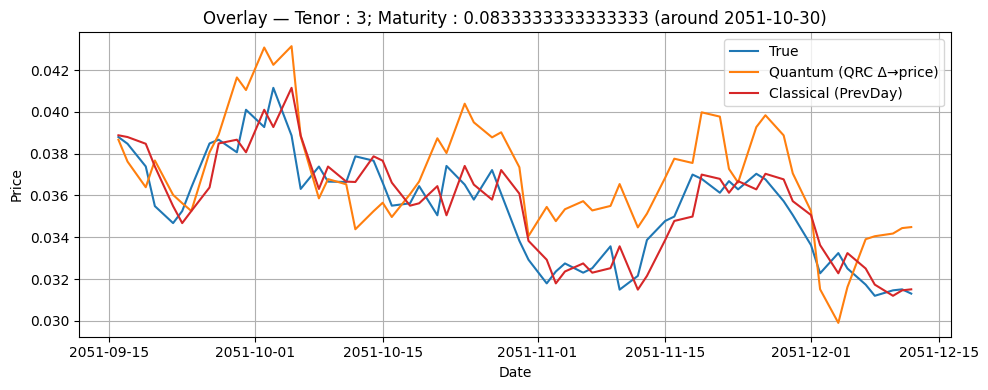

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_437.png


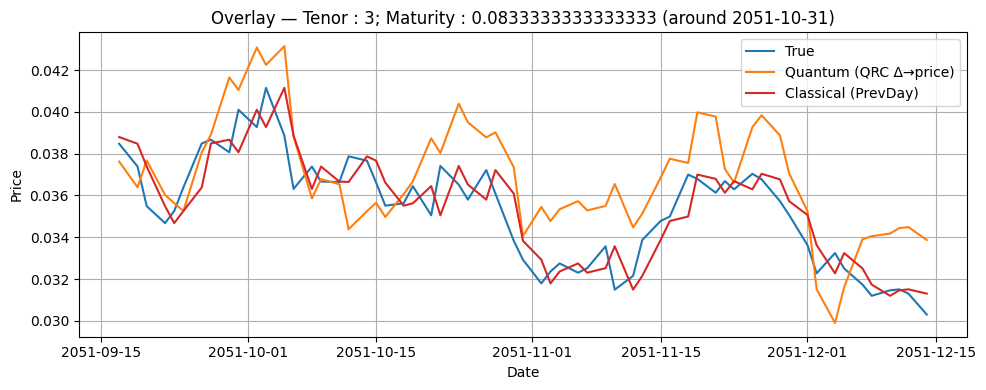

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_438.png


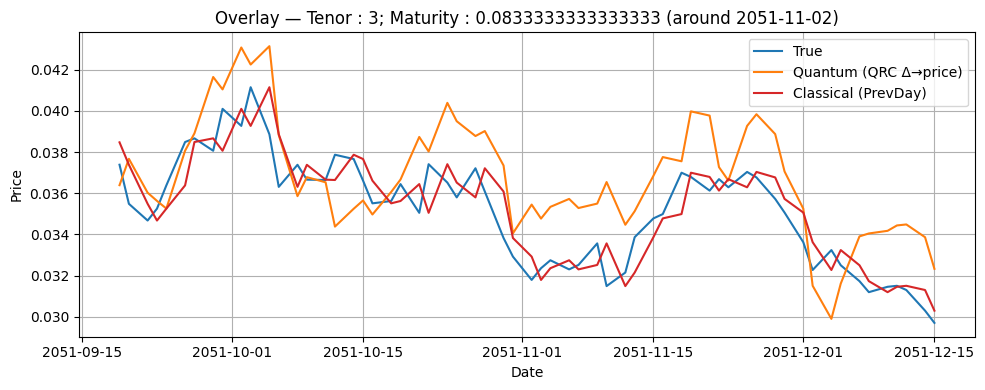

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_439.png


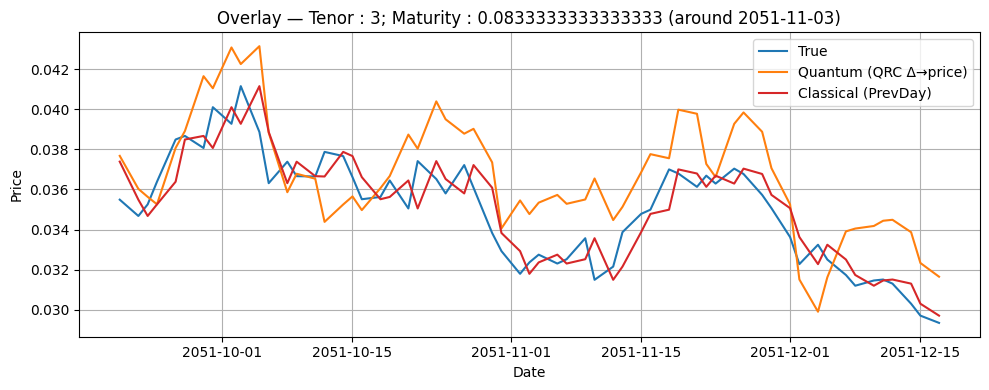

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_440.png


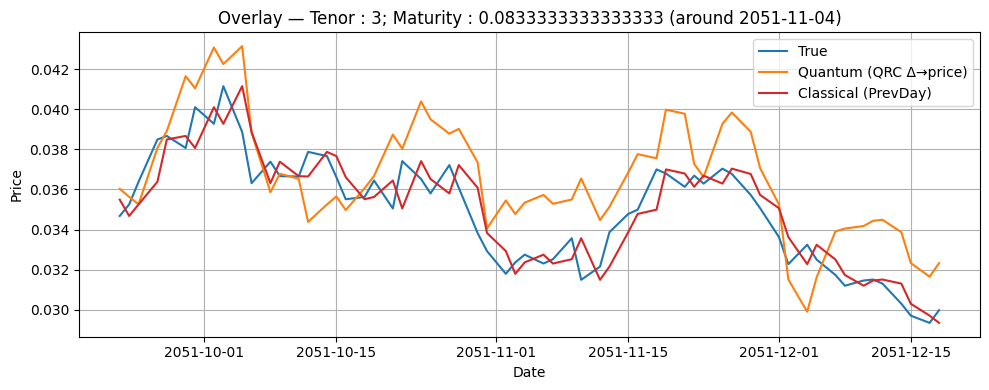

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_441.png


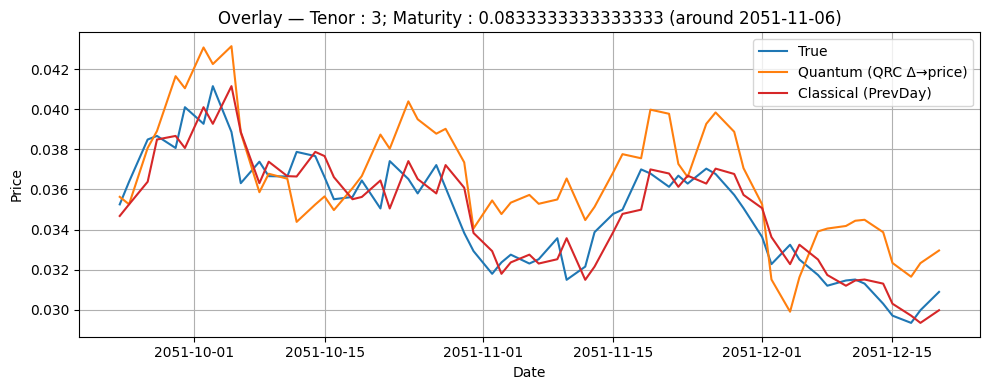

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_442.png


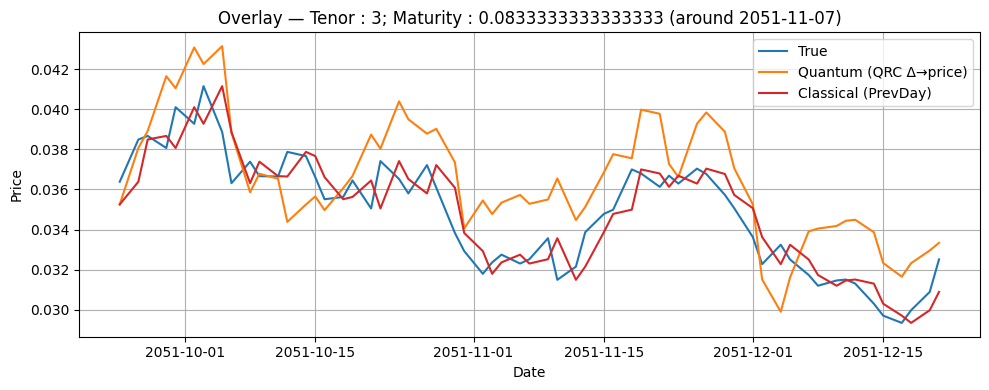

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_443.png


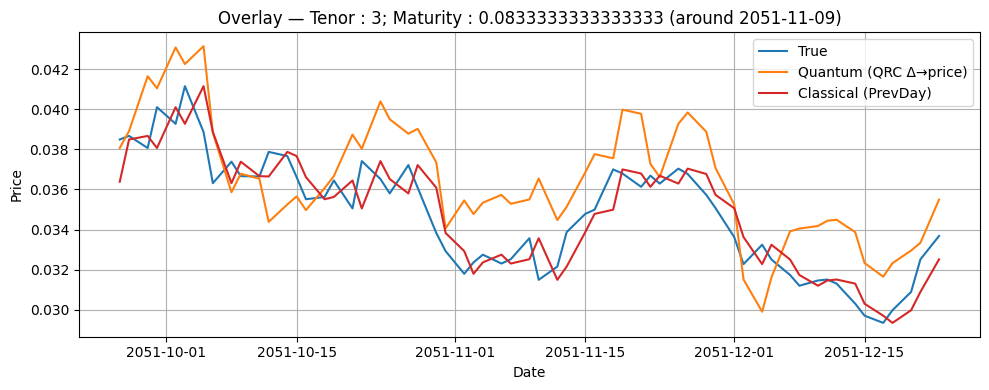

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_444.png


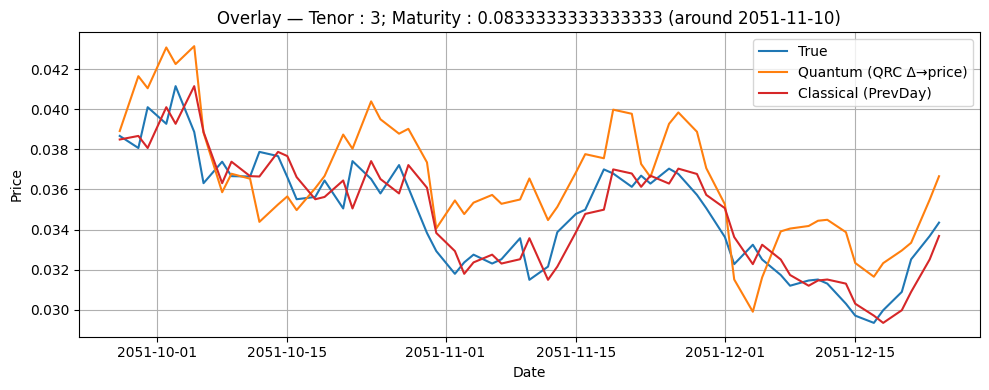

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_445.png


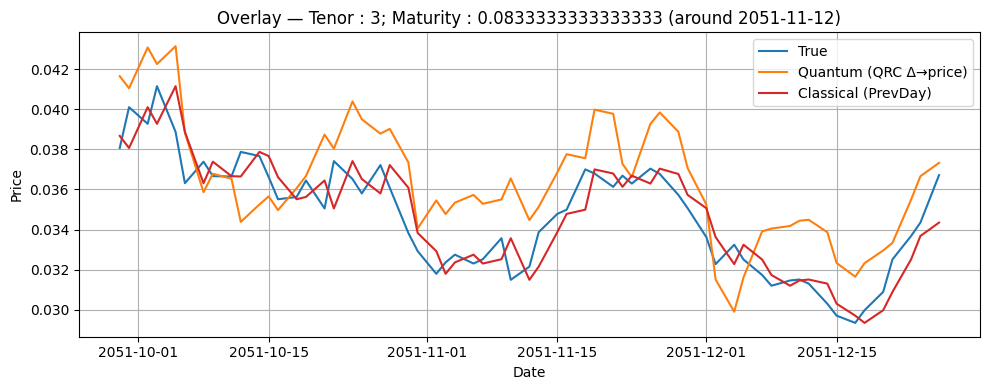

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_446.png


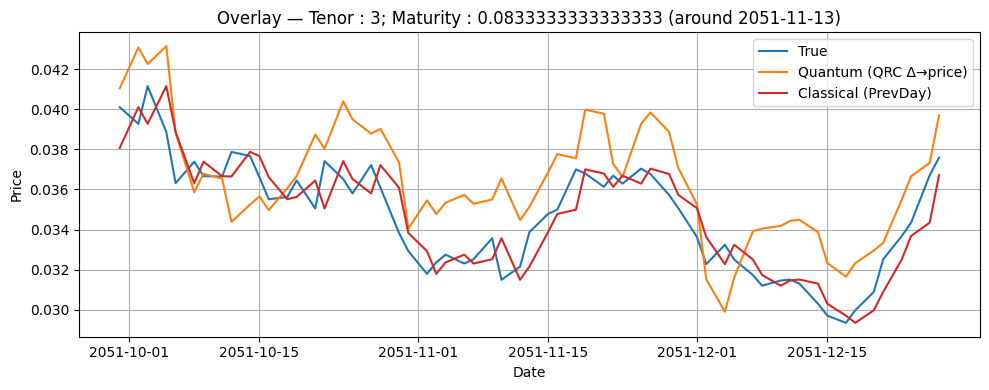

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_447.png


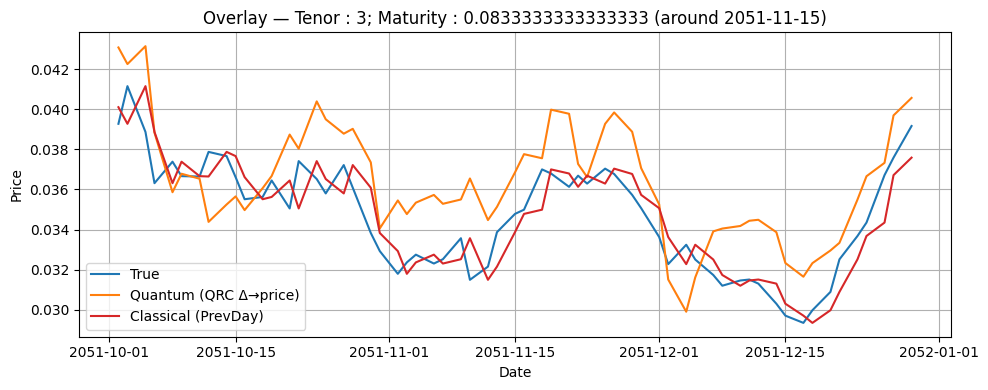

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_448.png


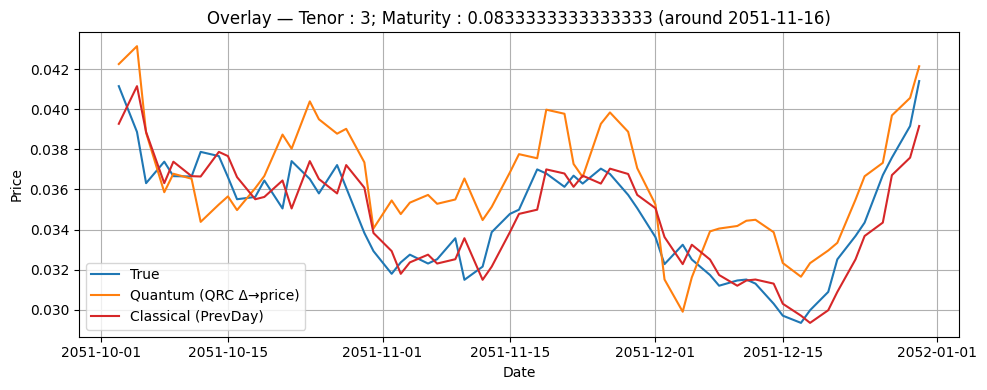

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_449.png


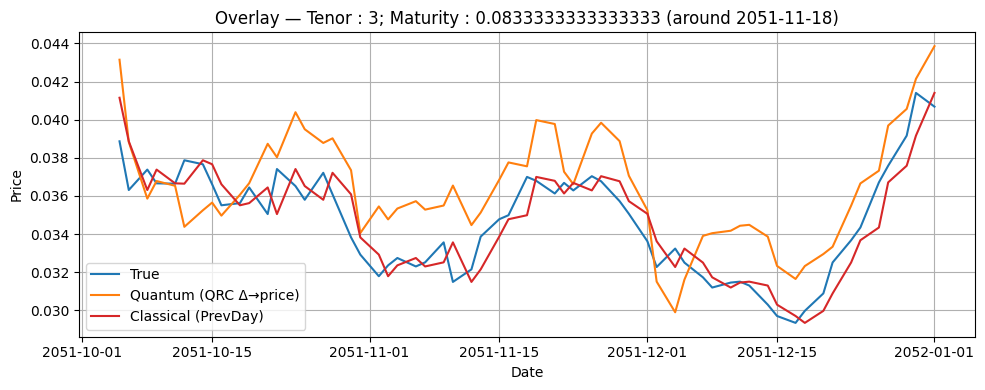

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_450.png


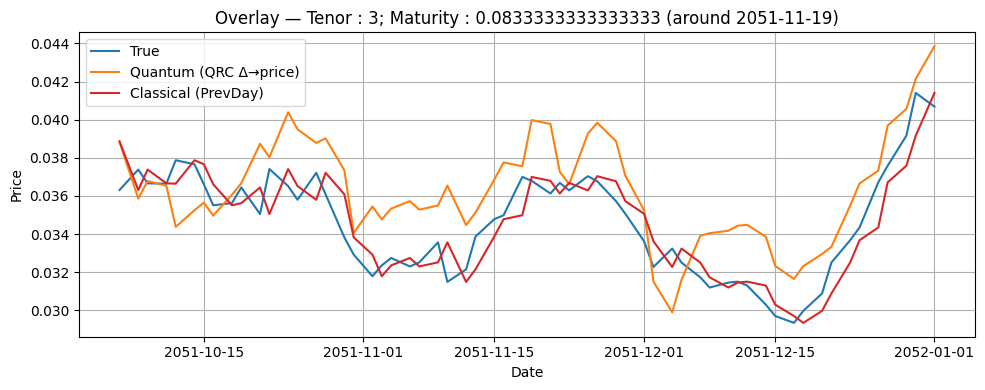

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_451.png


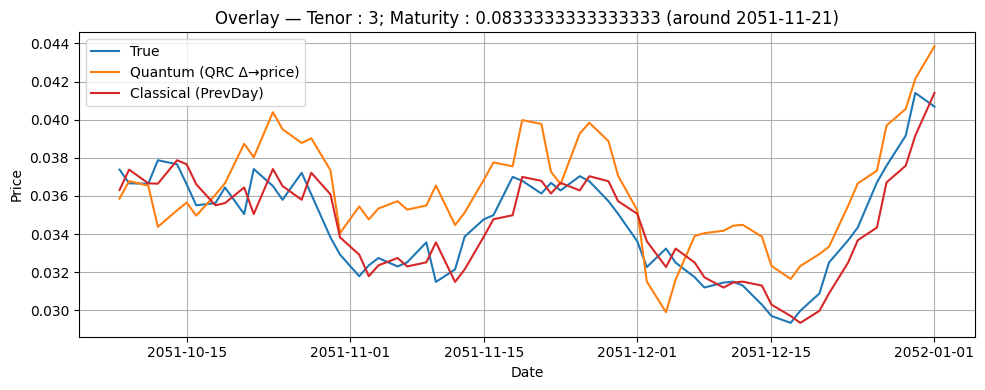

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_452.png


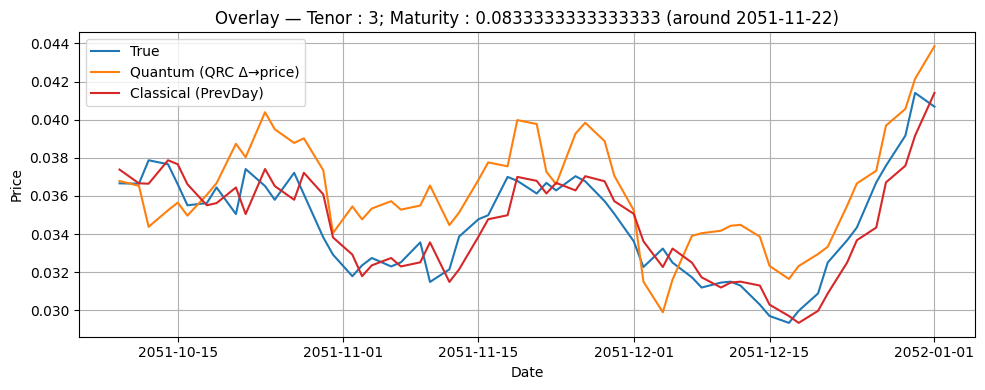

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_453.png


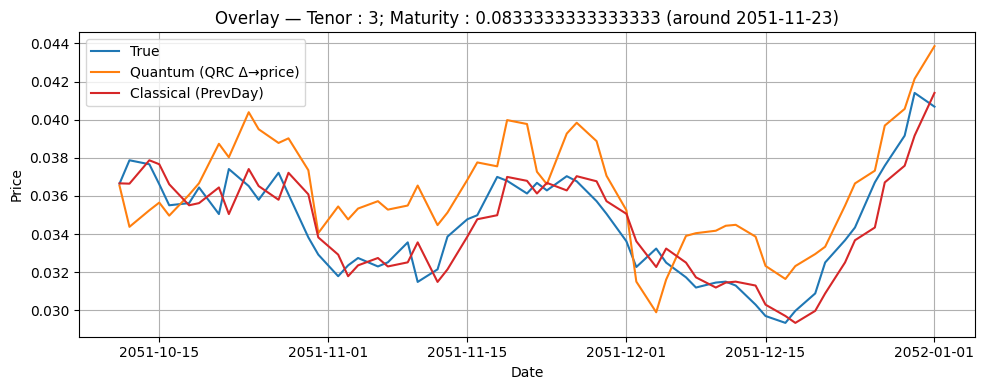

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_454.png


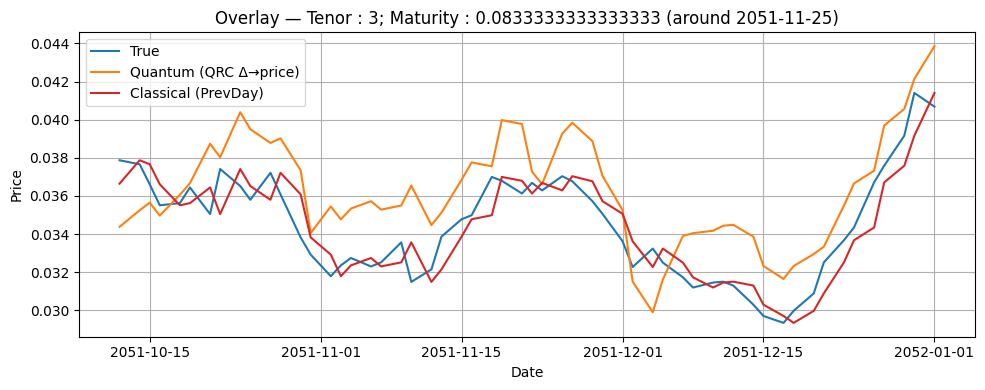

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_455.png


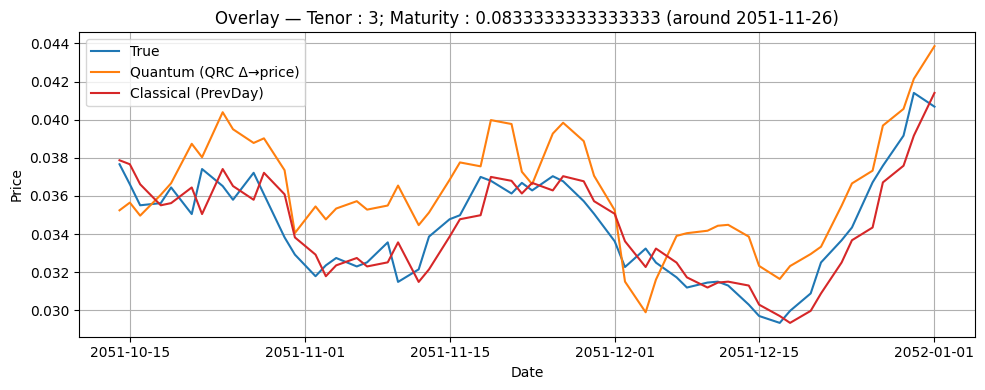

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_456.png


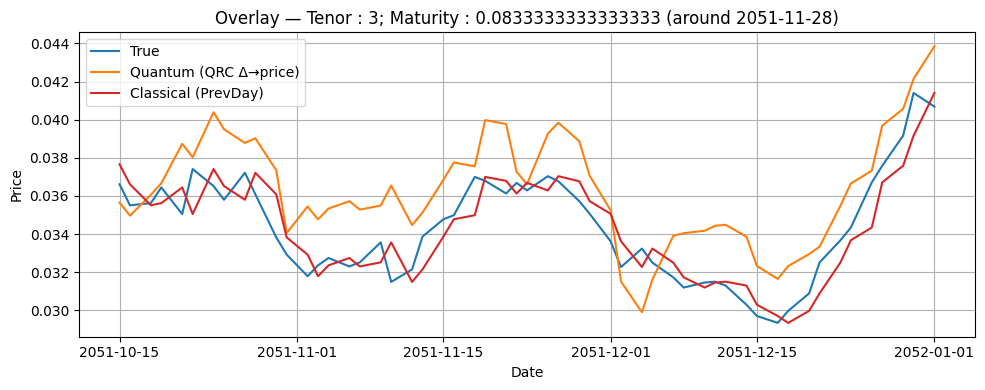

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_457.png


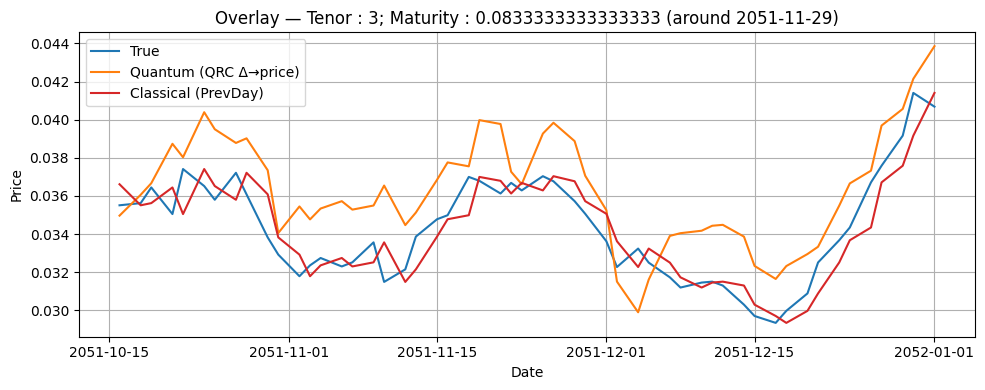

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_458.png


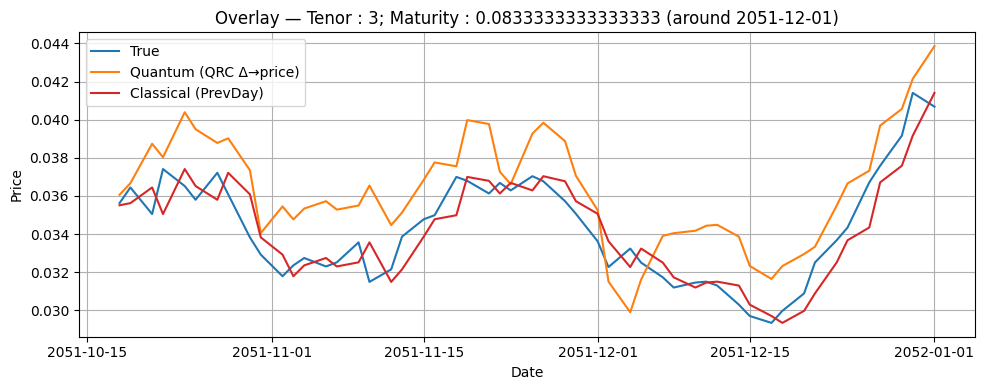

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_459.png


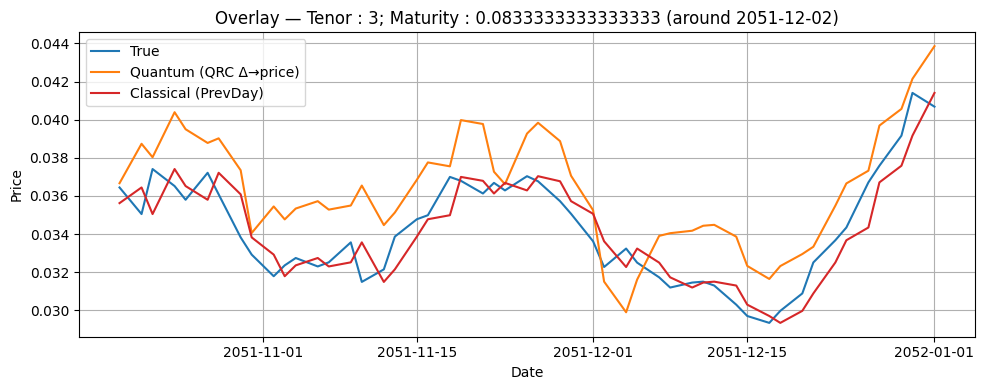

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_460.png


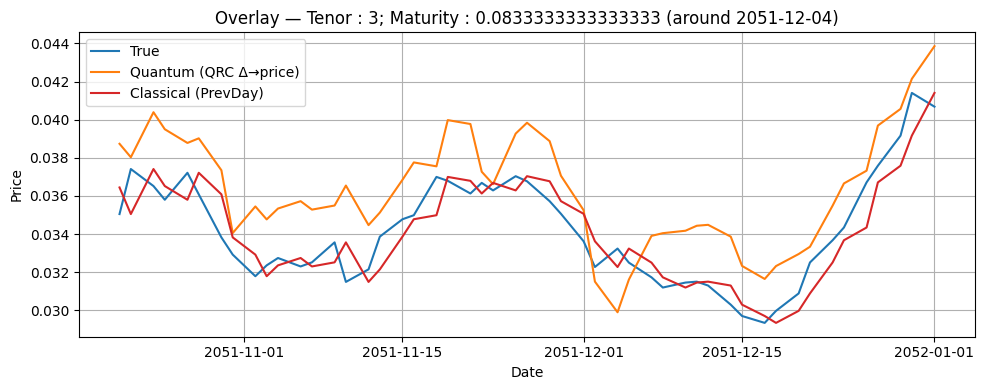

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_461.png


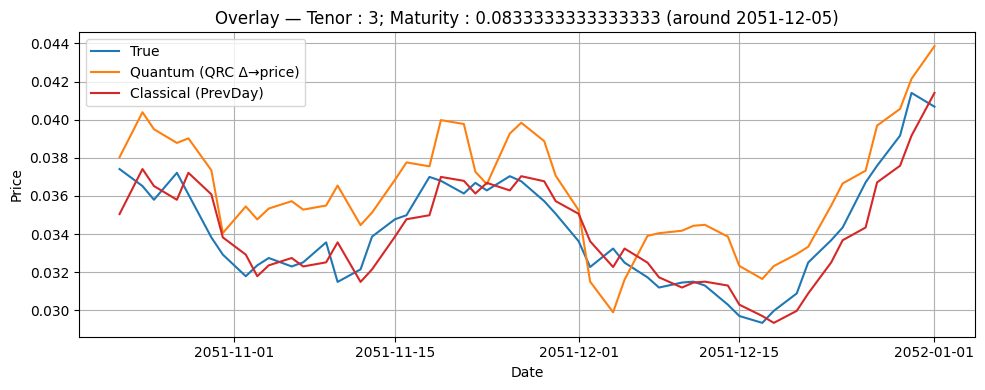

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_462.png


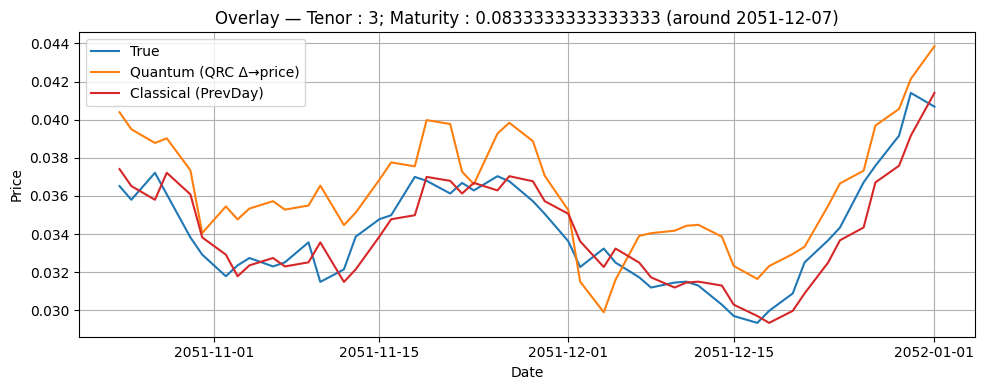

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_463.png


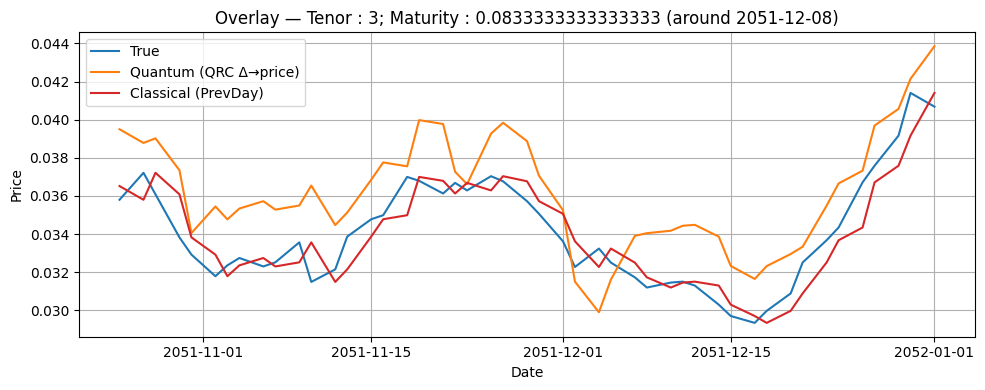

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_464.png


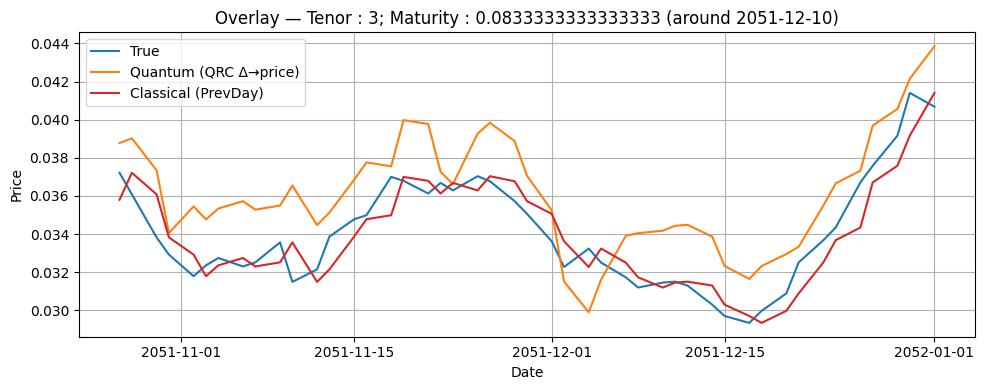

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_465.png


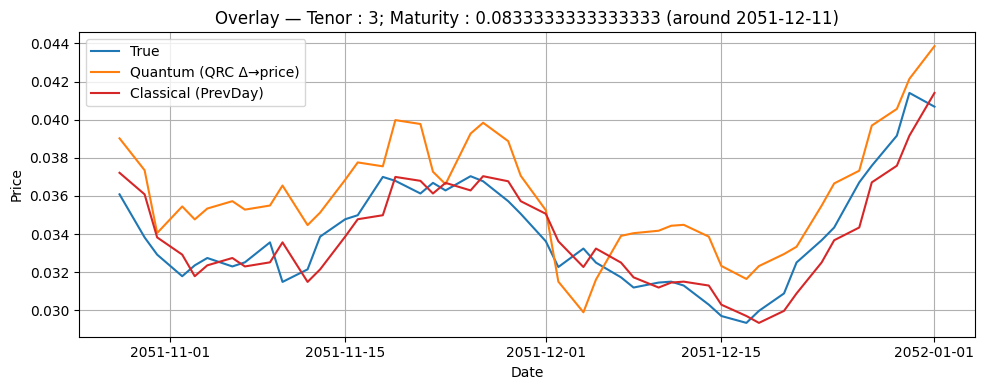

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_466.png


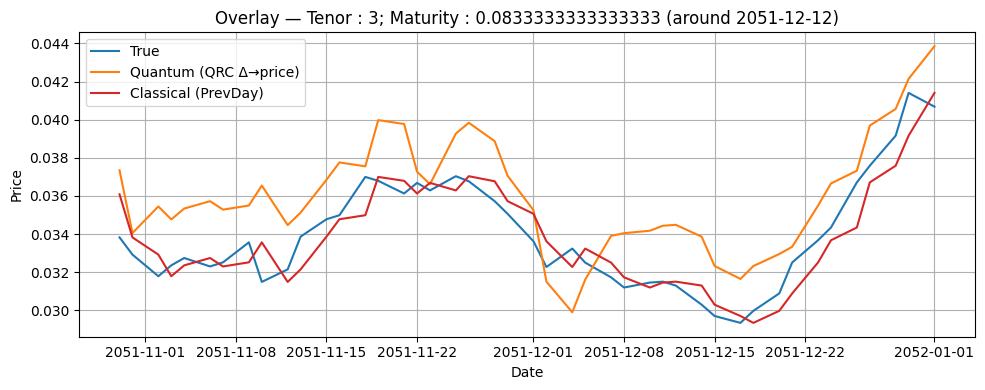

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_467.png


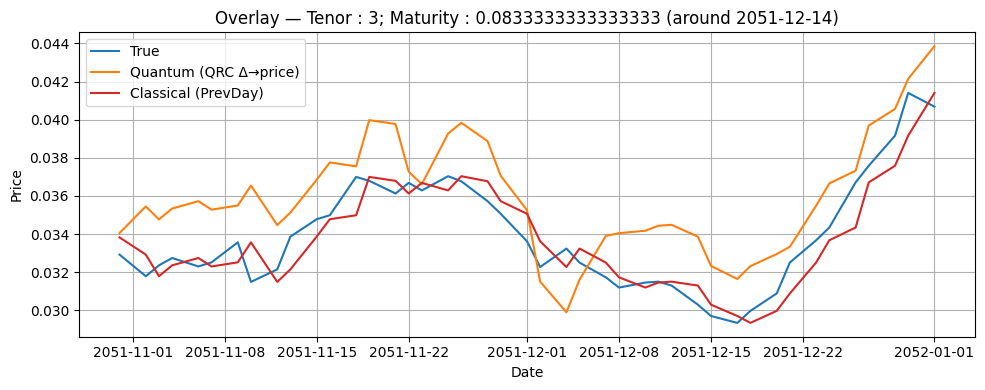

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_468.png


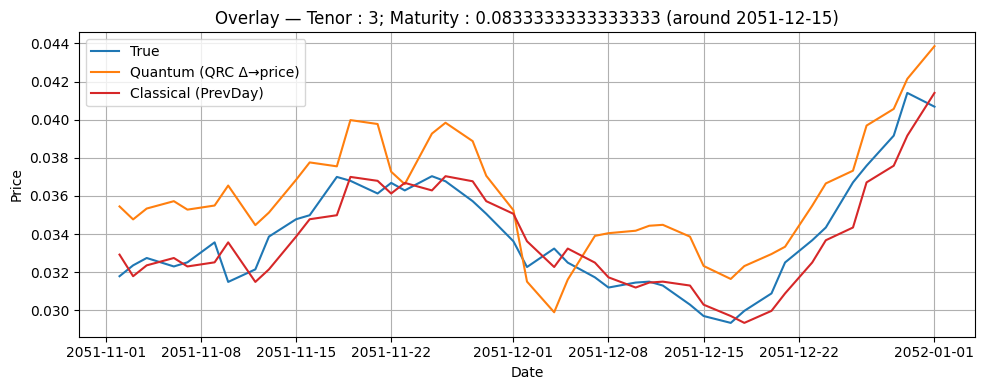

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_469.png


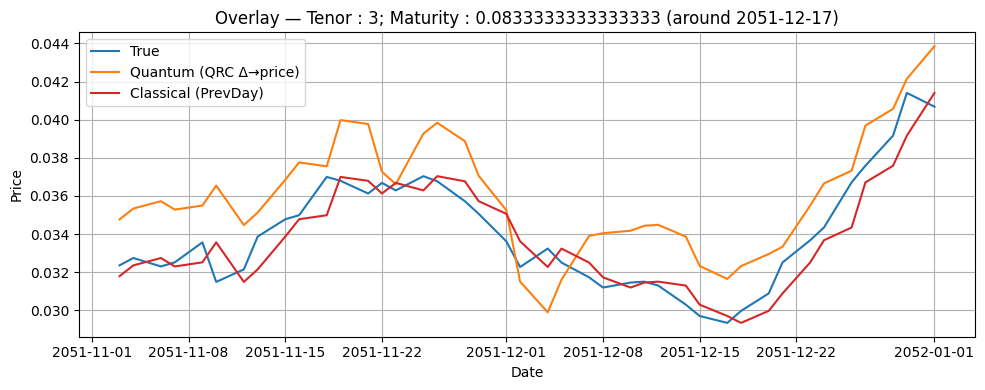

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_470.png


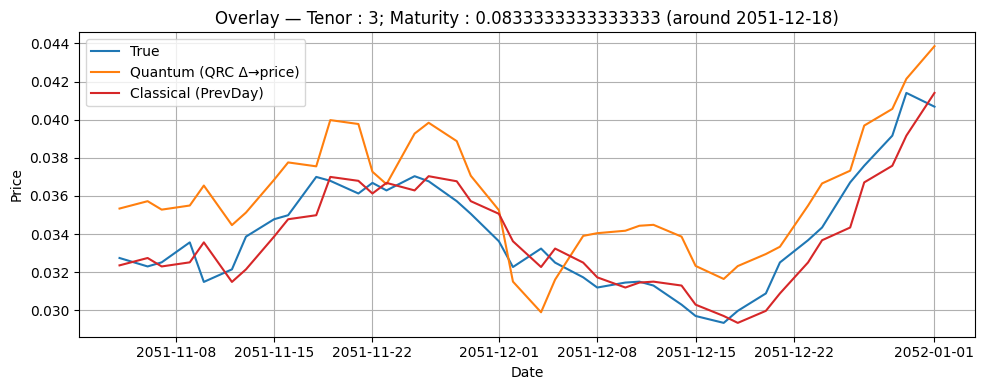

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_471.png


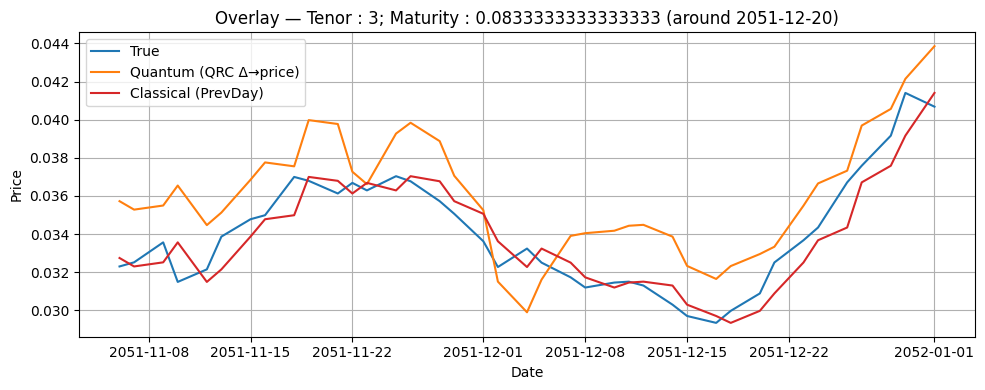

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_472.png


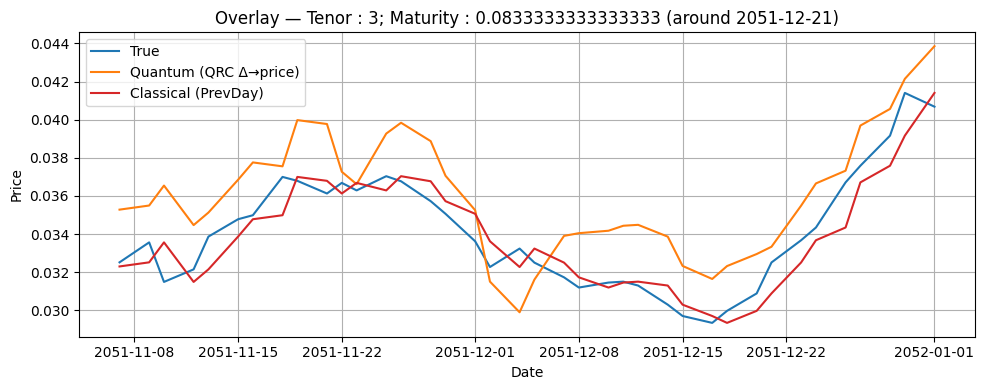

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_473.png


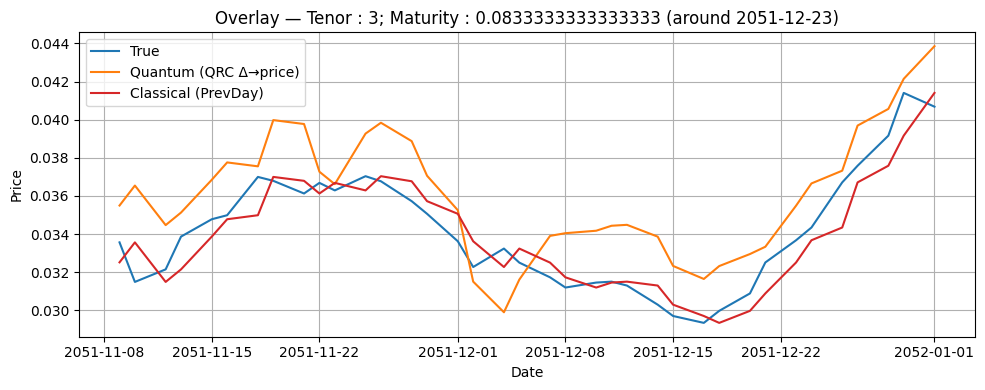

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_474.png


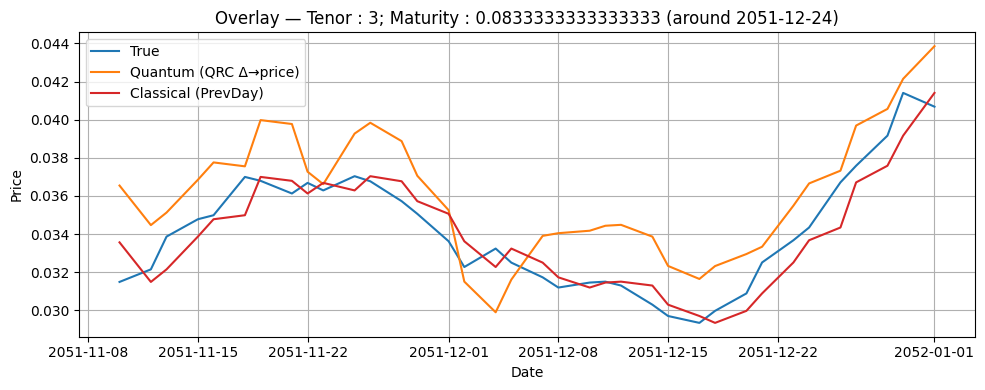

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_475.png


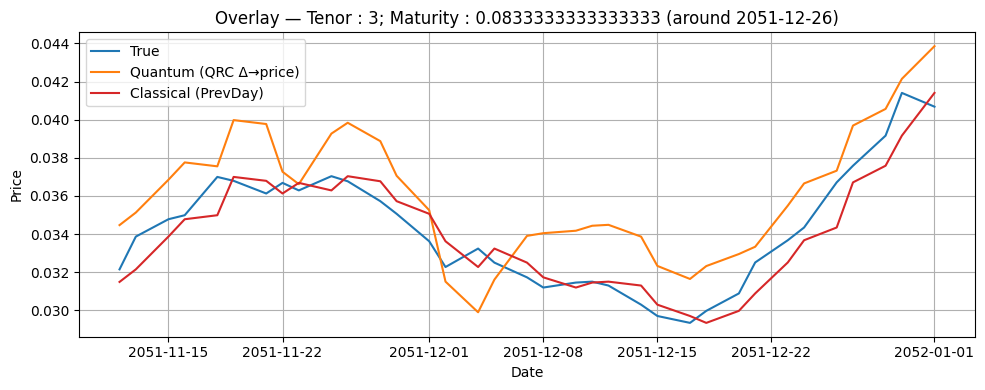

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_476.png


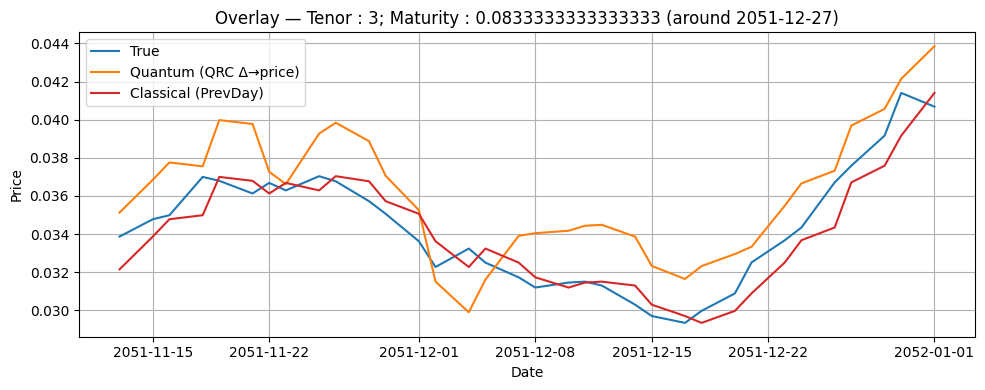

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_477.png


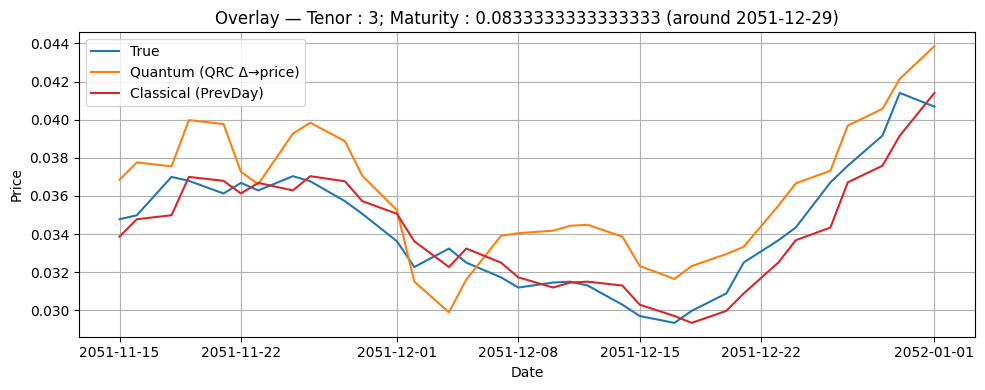

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_478.png


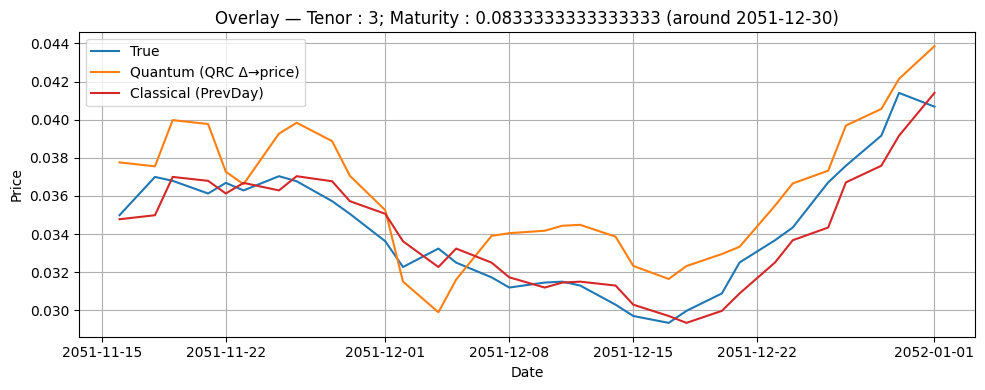

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_overlay_triple_Tenor _ 3; Maturity _ 0.0833333333333333_at_479.png


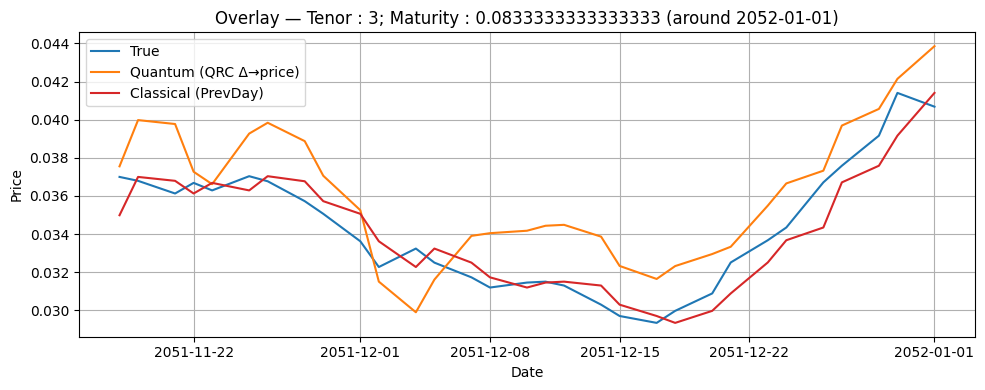

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-19.png


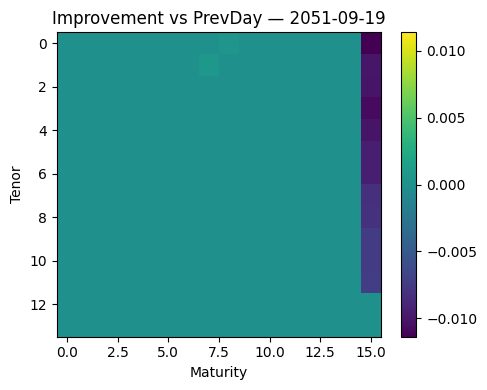

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-20.png


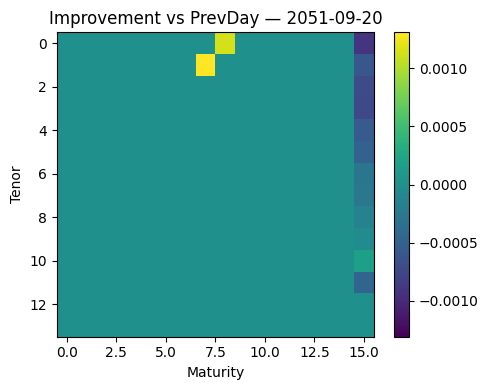

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-22.png


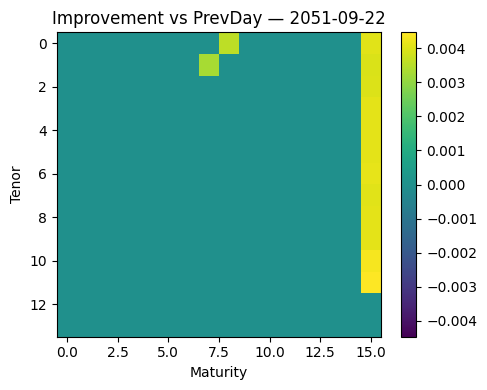

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-23.png


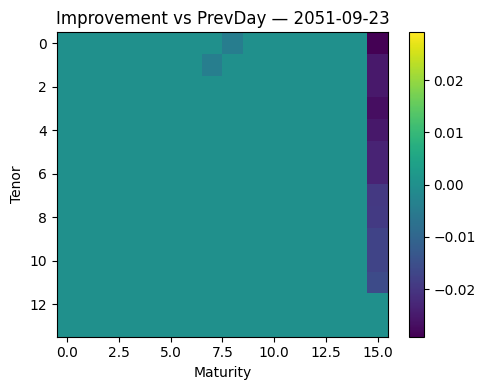

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-24.png


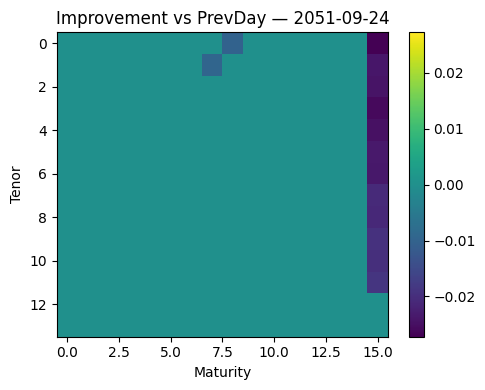

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-26.png


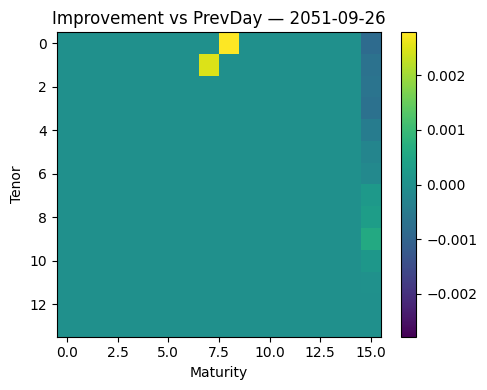

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-27.png


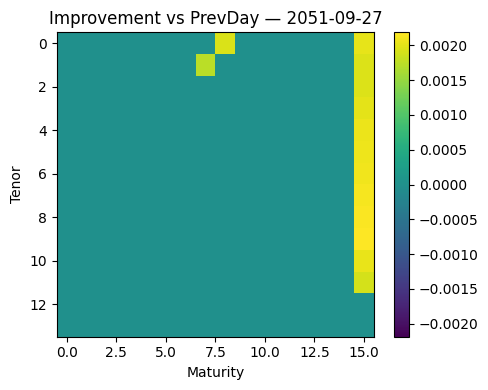

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-29.png


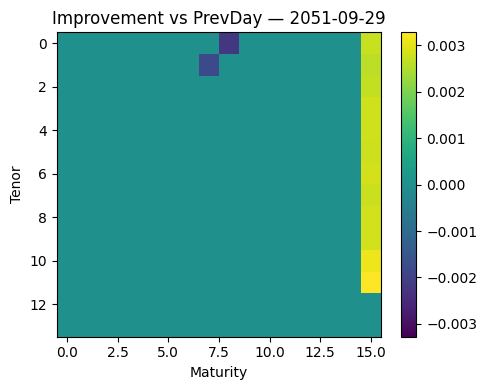

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-09-30.png


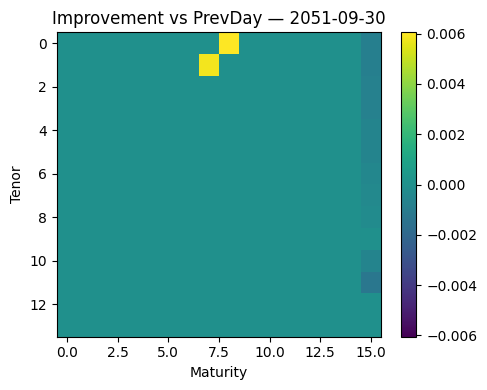

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-02.png


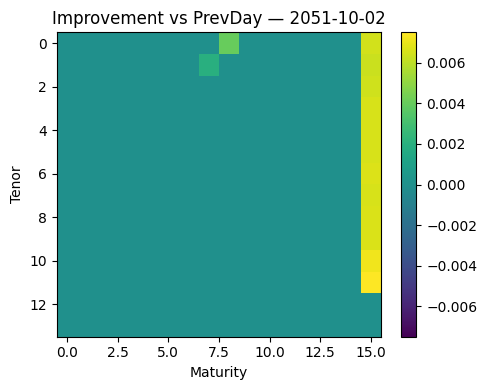

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-03.png


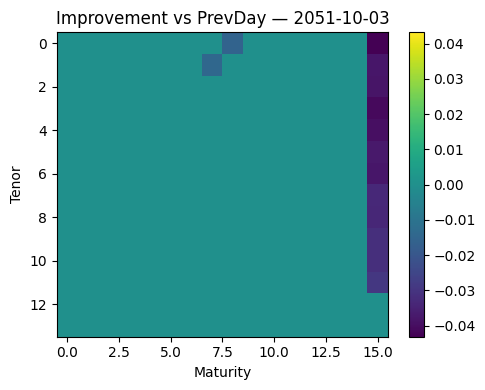

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-05.png


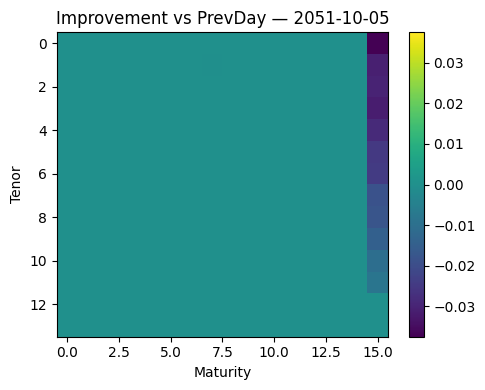

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-06.png


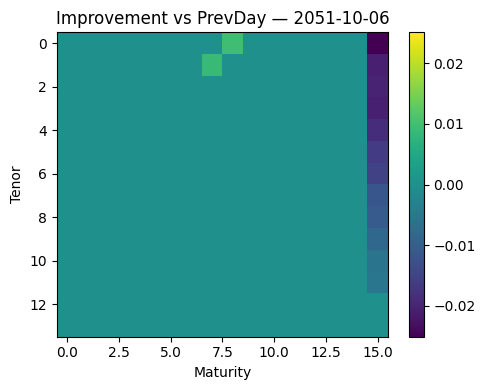

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-08.png


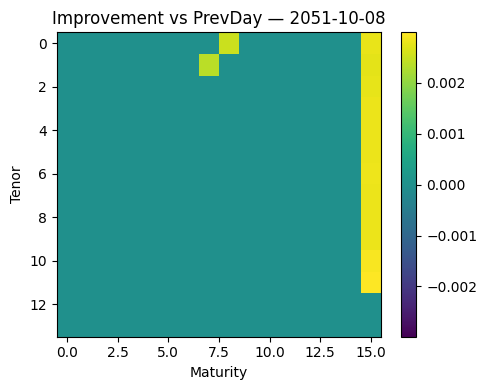

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-09.png


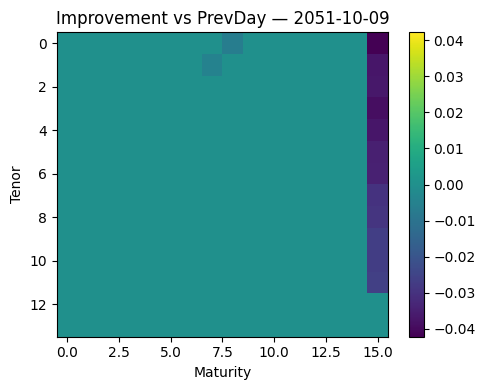

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-11.png


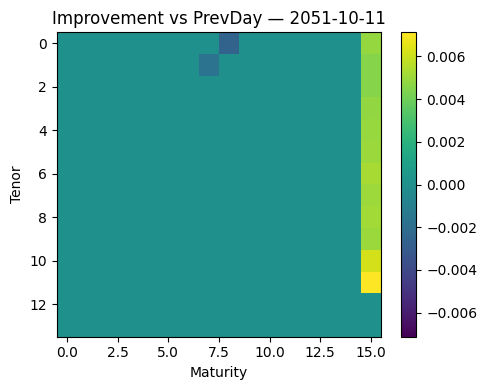

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-12.png


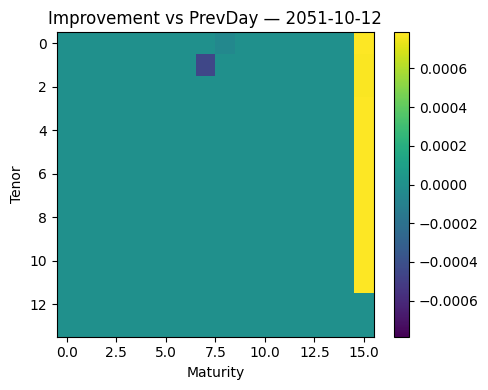

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-14.png


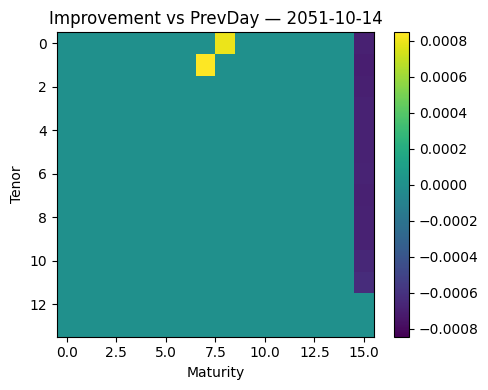

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-15.png


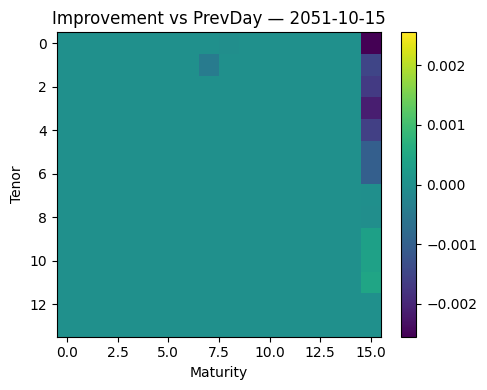

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-16.png


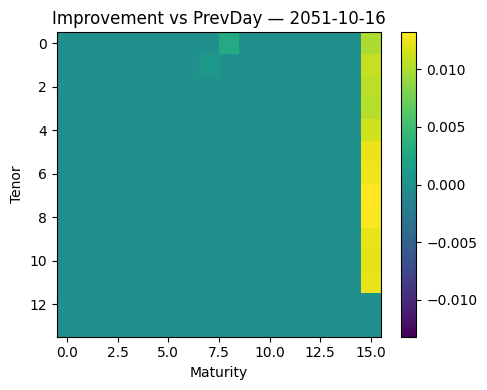

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-18.png


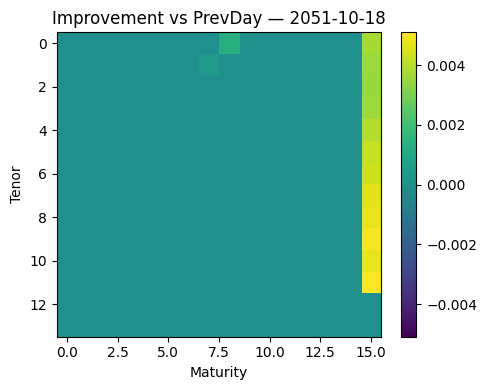

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-19.png


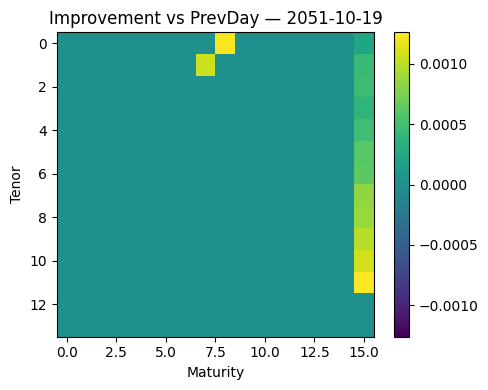

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-21.png


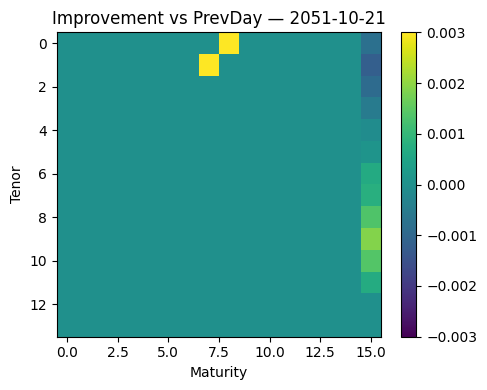

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-22.png


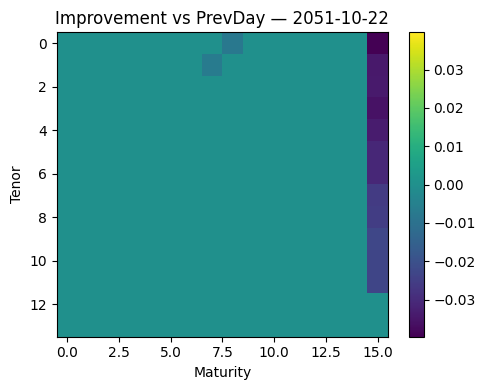

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-24.png


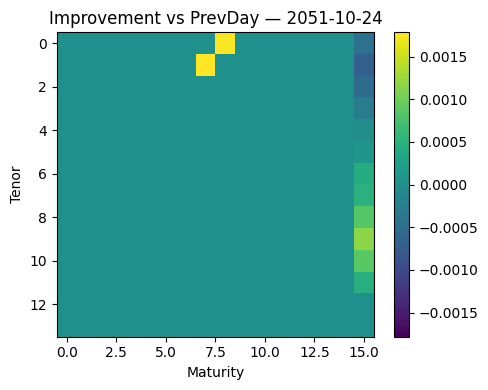

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-25.png


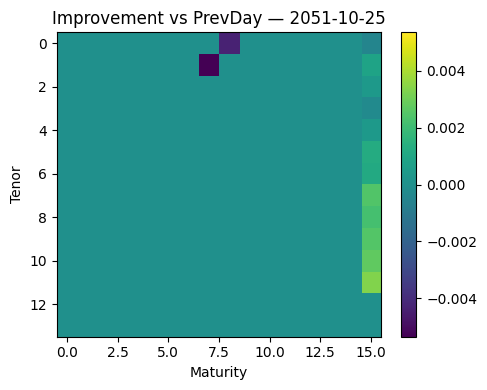

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-27.png


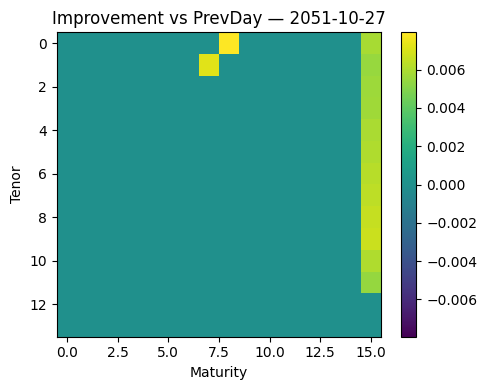

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-28.png


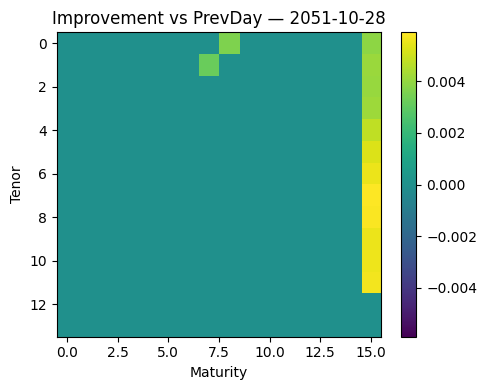

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-30.png


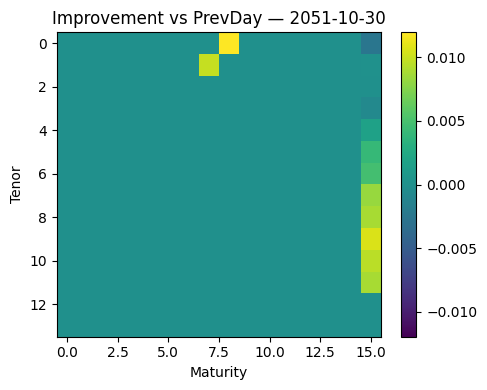

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-10-31.png


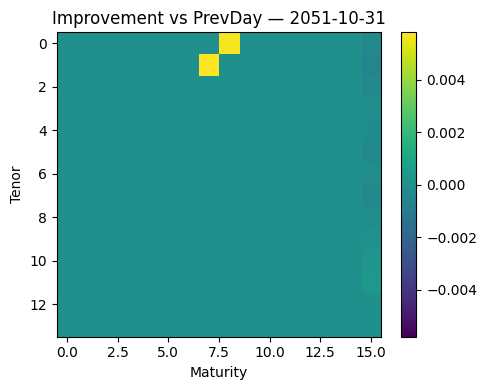

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-02.png


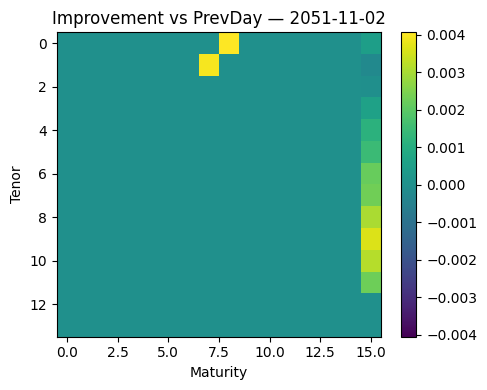

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-03.png


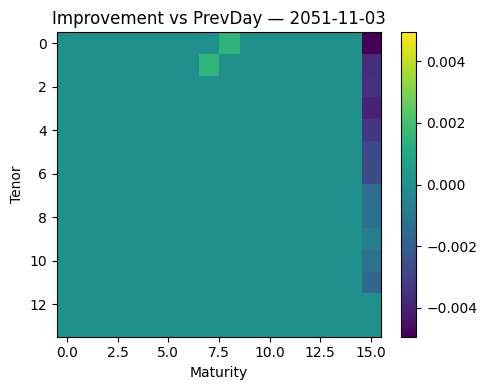

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-04.png


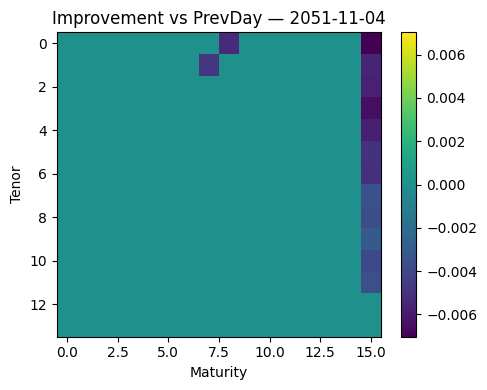

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-06.png


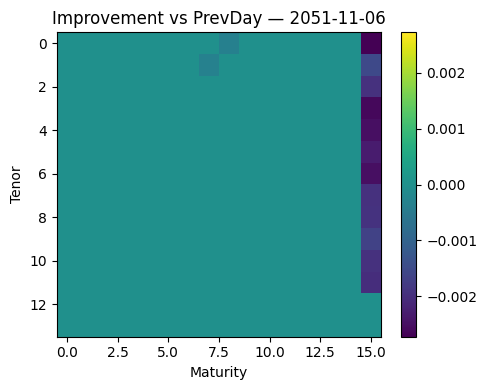

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-07.png


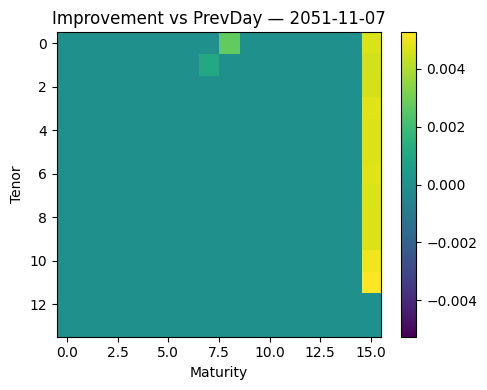

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-09.png


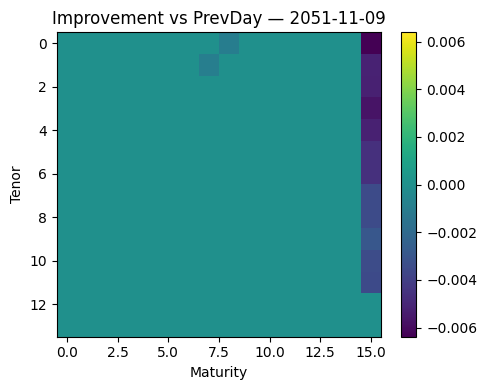

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-10.png


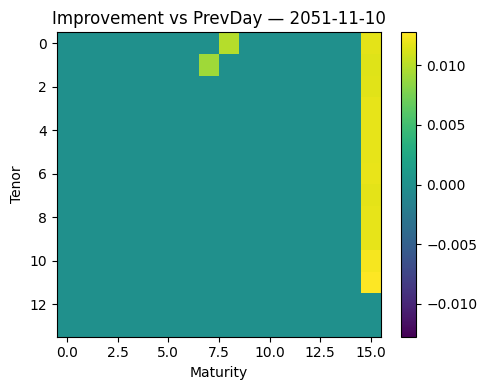

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-12.png


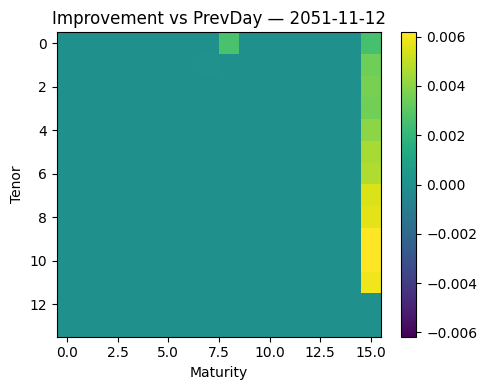

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-13.png


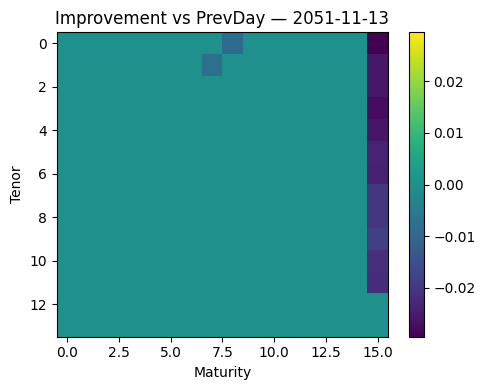

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-15.png


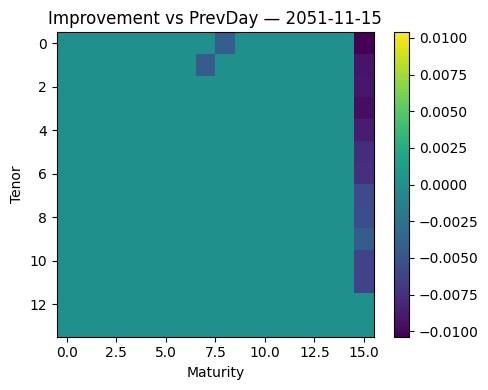

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-16.png


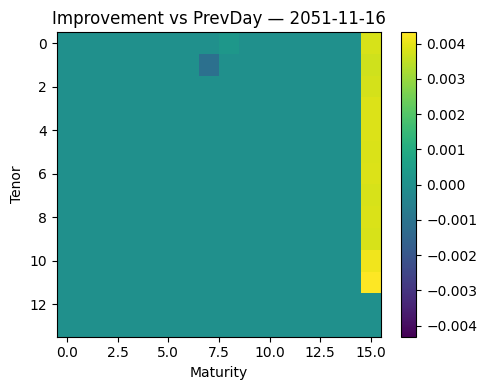

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-18.png


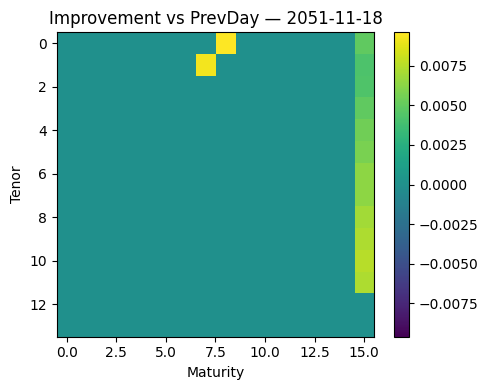

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-19.png


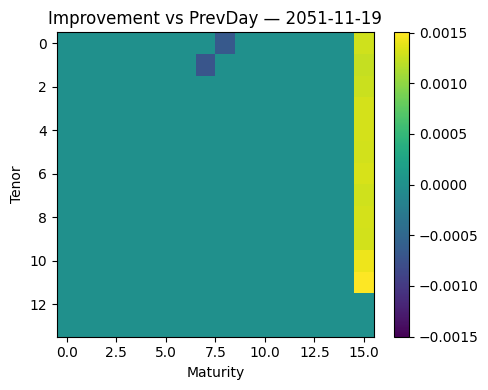

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-21.png


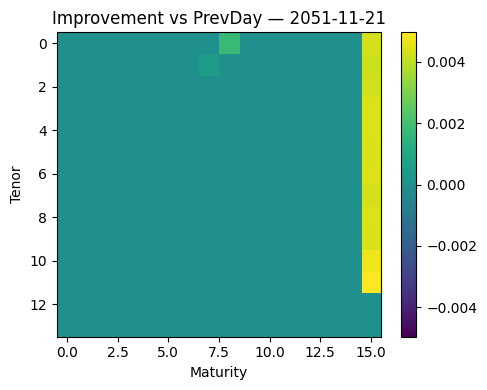

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-22.png


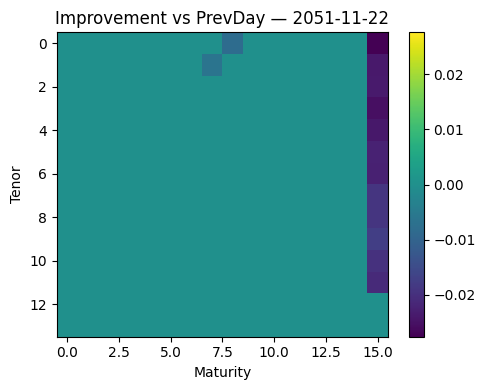

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-23.png


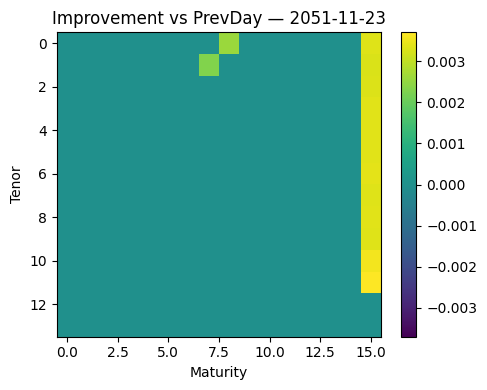

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-25.png


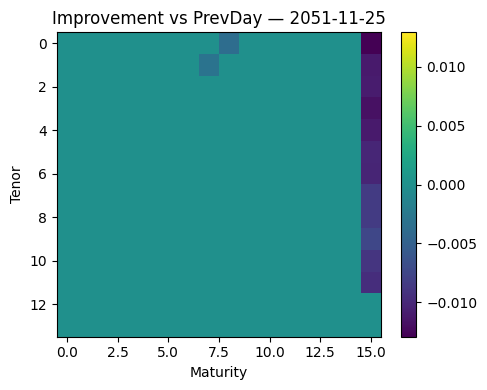

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-26.png


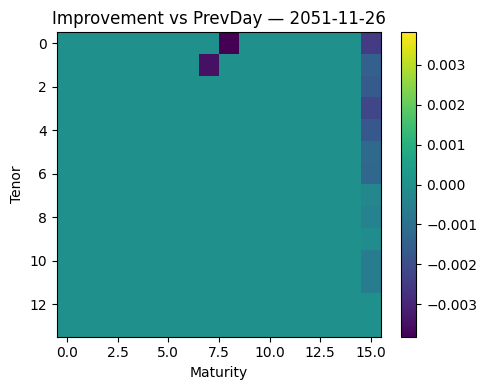

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-28.png


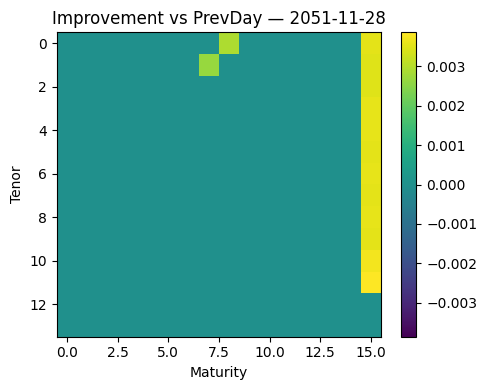

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-11-29.png


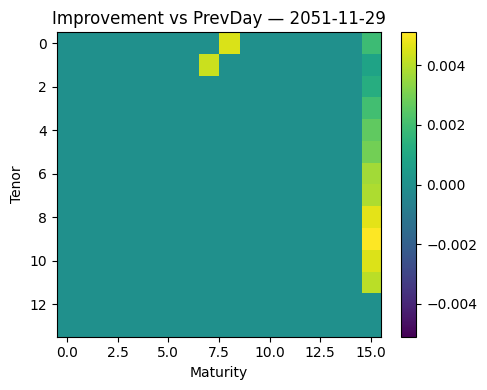

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-01.png


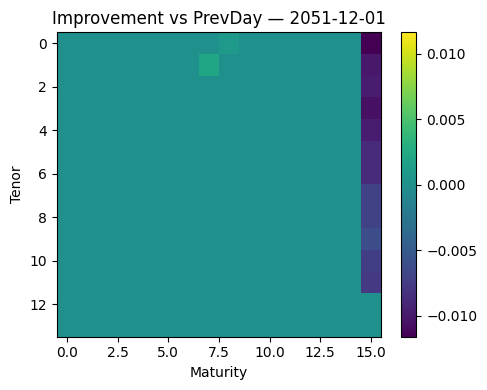

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-02.png


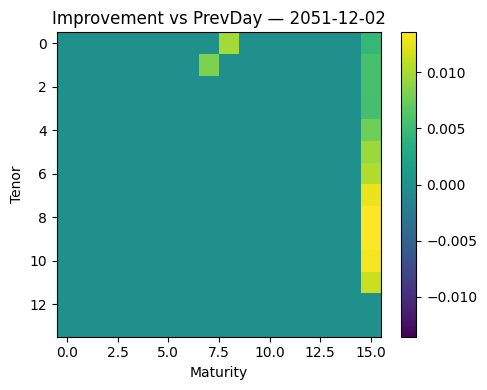

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-04.png


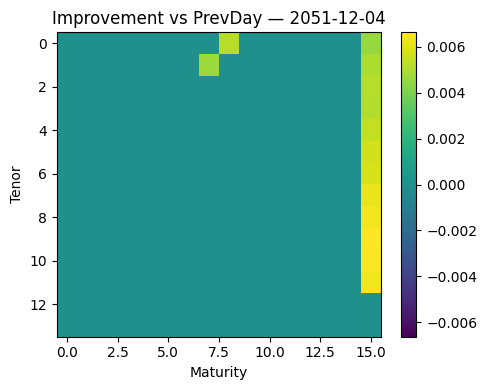

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-05.png


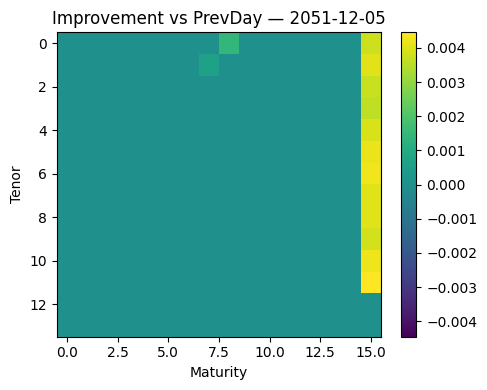

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-07.png


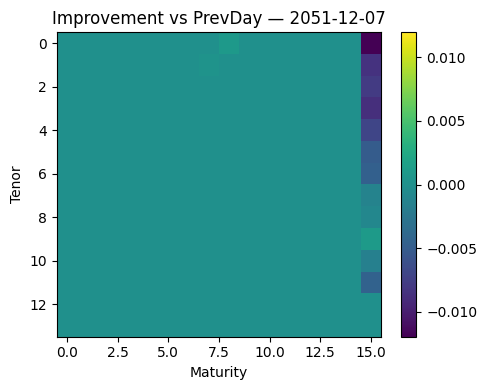

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-08.png


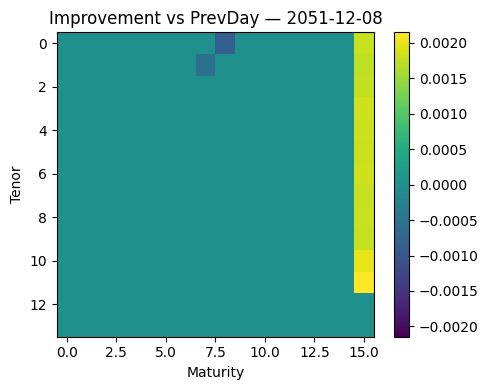

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-10.png


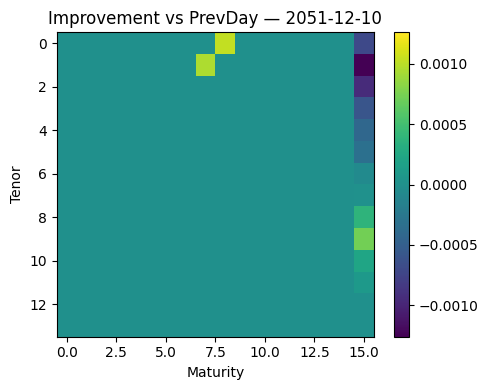

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-11.png


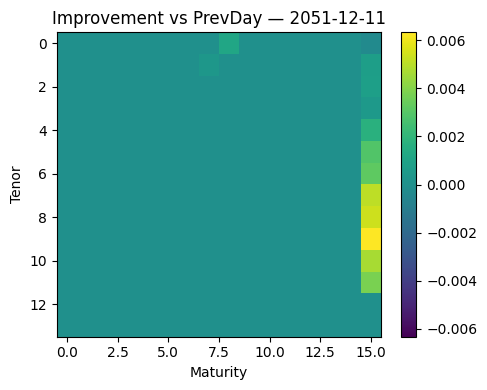

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-12.png


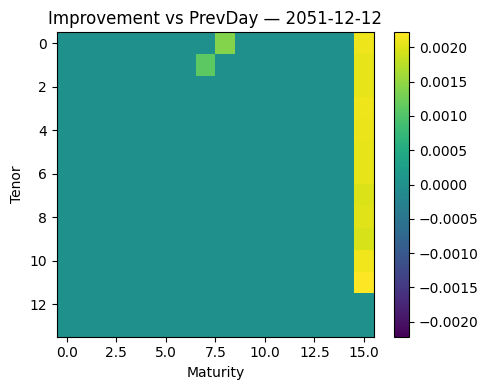

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-14.png


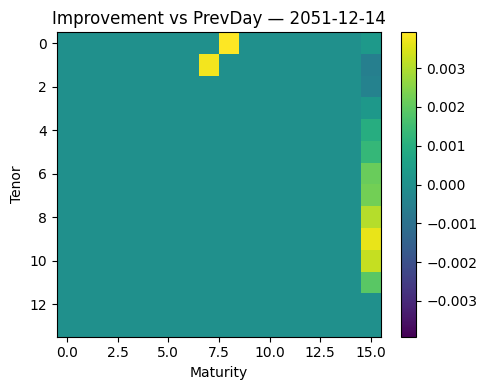

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-15.png


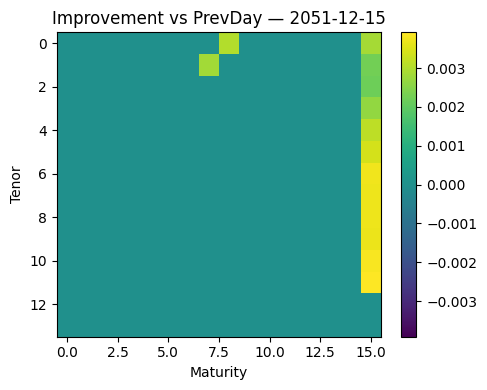

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-17.png


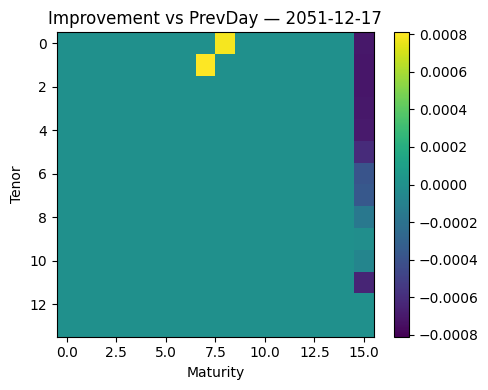

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-18.png


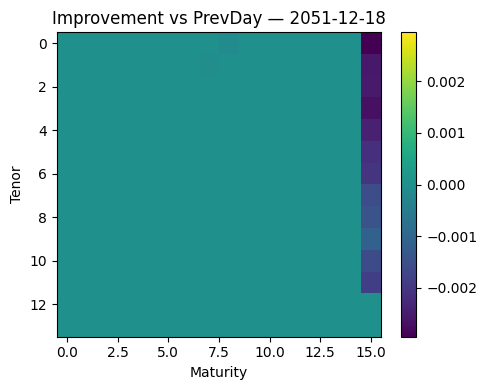

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-20.png


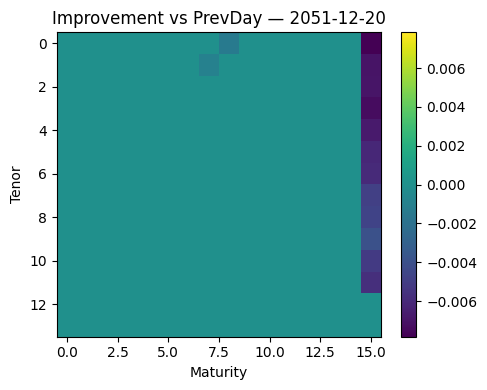

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-21.png


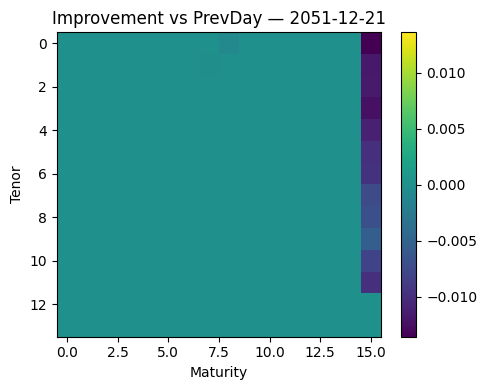

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-23.png


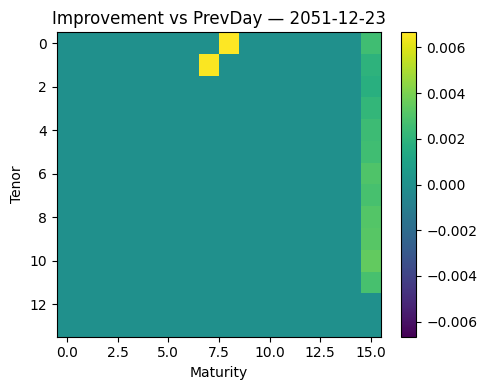

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-24.png


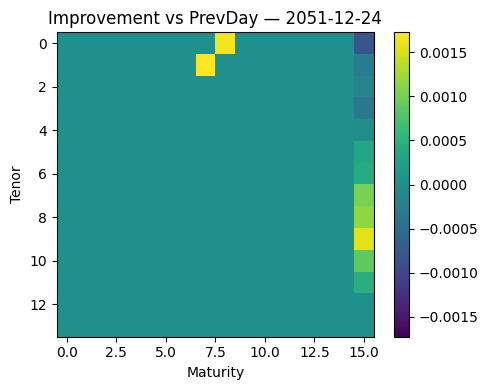

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-26.png


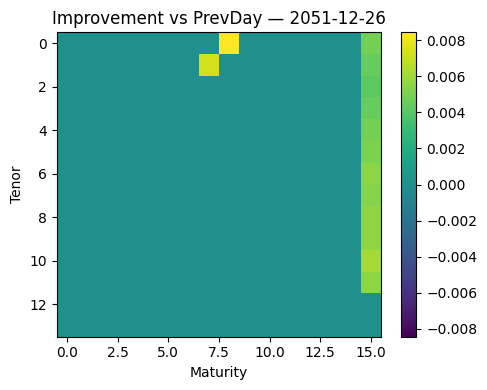

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-27.png


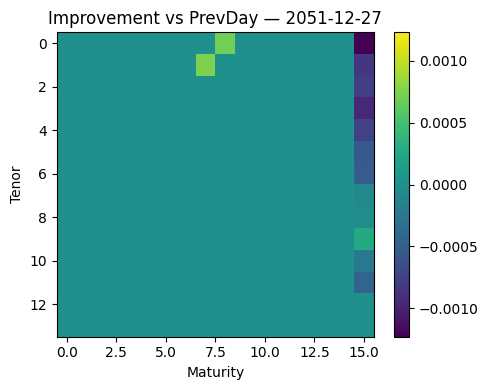

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-29.png


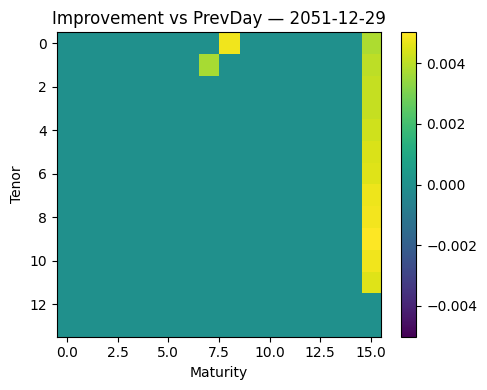

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2051-12-30.png


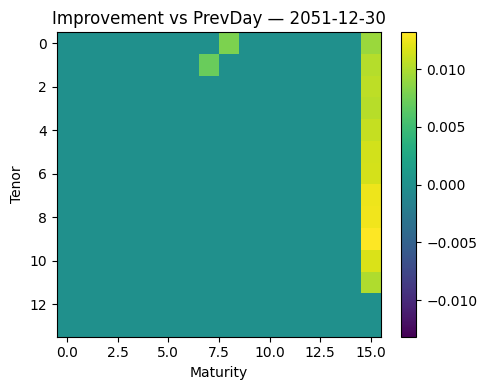

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_improve_heatmap_2052-01-01.png


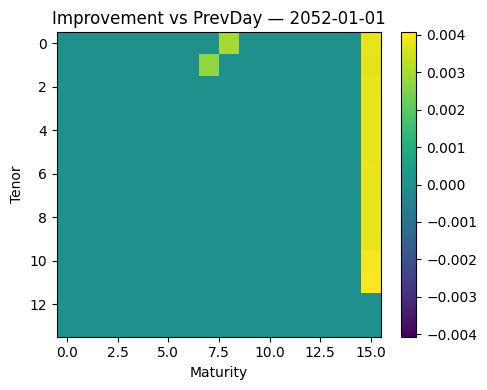

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_win_count_grid.png


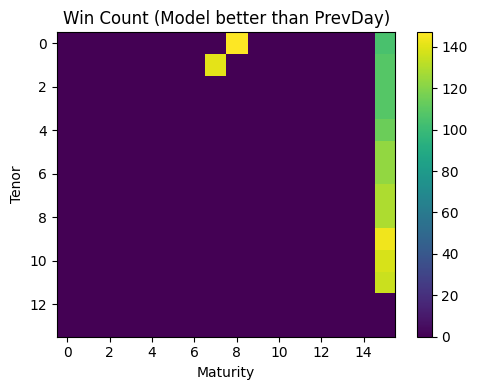


[Per-day average improvement]
      date  RMSE_prev  RMSE_model  improvement  improvement_pct
2051-09-19   0.001334    0.009193    -0.007859        -5.889236
2051-09-20   0.001725    0.001389     0.000336         0.194861
2051-09-22   0.005988    0.001978     0.004010         0.669661
2051-09-23   0.005127    0.025437    -0.020310        -3.961510
2051-09-24   0.000225    0.021663    -0.021438       -95.245701
2051-09-26   0.003599    0.003657    -0.000058        -0.015988
2051-09-27   0.002726    0.000741     0.001985         0.728072
2051-09-29   0.005324    0.002865     0.002459         0.461927
2051-09-30   0.002663    0.001206     0.001457         0.547163
2051-10-02   0.009587    0.003293     0.006295         0.656539
2051-10-03   0.001733    0.035142    -0.033410       -19.283605
2051-10-05   0.008599    0.030974    -0.022376        -2.602176
2051-10-06   0.005314    0.017557    -0.012243        -2.303731
2051-10-08   0.004096    0.001325     0.002771         0.676566
2051-10-0

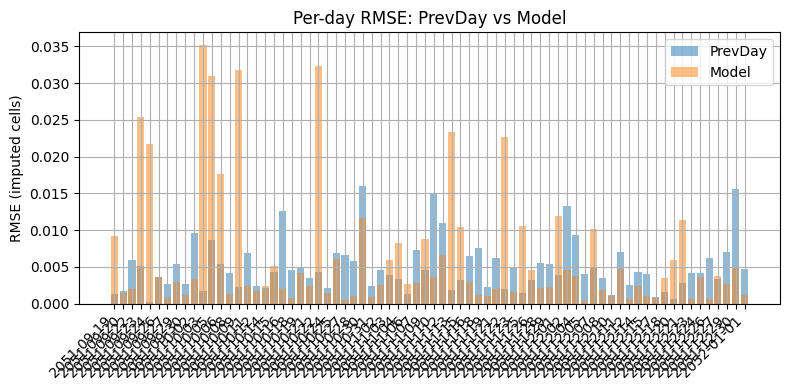

[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\fig_bar_improvement_pct.png


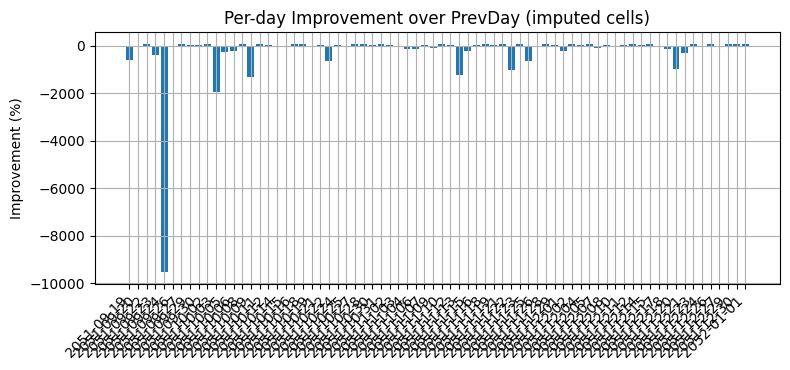


=== DONE (price-delta + (T,M) prior/peer + convex blend + demo mask) ===


In [23]:
# ================================
# Cell 3 — Results & Viz (blue=True, orange=Quantum, red=Classical)
# ================================
OUTDIR              = ART["OUTDIR"]
dates_feat          = ART["dates_feat"]
feature_cols        = ART["feature_cols"]
target_rows         = ART["target_rows"]
price_true_all      = ART["price_true_all"]
price_qrc_all       = ART["price_qrc_all"]
baseline_full_price = ART["baseline_full_price"]
df_eval             = ART["df_eval"]
per_day_improve     = ART["per_day_improvement_vectors"]
improve_grid_count  = ART["improve_grid_count"]
verdict             = ART["verdict"]
goal1_pass          = ART["goal1_pass"]

print("\n=== Goal 1 verdict ===")
print(f"PASS: {goal1_pass}")
print(f"Days improved fraction = {verdict['frac_days_improved']:.3f}")
print(f"Mean improvement pct   = {100*verdict['mean_impr_pct']:.2f}%")
print(f"Permutation p-value    = {verdict['p_value']:.4f}")

summary = pd.DataFrame({
    "Metric": ["Days improved fraction", "Mean improvement (%)", "Permutation p-value", "Goal 1 PASS?"],
    "Value":  [verdict['frac_days_improved'], 100*verdict['mean_impr_pct'], verdict['p_value'], goal1_pass]
})
print("\n[Goal 1 Summary]"); print(summary.to_string(index=False))
save_table(summary, os.path.join(OUTDIR, "table_goal1_summary.csv"))

# ---- 3本折れ線（±30営業日 × 上位3列）----
preview_span = 30
for jcol in range(min(3, len(feature_cols))):
    col = feature_cols[jcol]
    for r in target_rows:
        g_start = max(0, r - preview_span)
        g_end   = min(len(dates_feat)-1, r + preview_span)
        days = dates_feat[g_start:g_end+1]
        true_line      = price_true_all[g_start:g_end+1, jcol]
        quantum_line   = price_qrc_all[g_start:g_end+1, jcol]
        classical_line = baseline_full_price["PrevDay"][g_start:g_end+1, jcol]
        title = f"Overlay — {col} (around {str(dates_feat[r].date())})"
        out   = os.path.join(OUTDIR, f"fig_overlay_triple_{col.replace(':','_')}_at_{r}.png")
        line_overlay_triple(days, true_line, quantum_line, classical_line,
                            labels=("True","Quantum (QRC Δ→price)","Classical (PrevDay)"),
                            title=title, out_png=out)

# ---- 改善ヒートマップ（欠損セルのみの平均リフト）----
for day_str, lift_vec in per_day_improve.items():
    heatmap_by_grid(lift_vec, feature_cols, title=f"Improvement vs PrevDay — {day_str}", center_zero=True)
    savefig_show(os.path.join(OUTDIR, f"fig_improve_heatmap_{day_str}.png"))

# ---- 勝率グリッド（全日×全シード合算）----
heatmap_by_grid(improve_grid_count, feature_cols, title="Win Count (Model better than PrevDay)", center_zero=False)
savefig_show(os.path.join(OUTDIR, "fig_win_count_grid.png"))

# ---- 集計バー ----
agg = df_eval.groupby(["date"]).agg(
    RMSE_prev=("RMSE_PrevDay","mean"),
    RMSE_model=("RMSE_Model","mean"),
    improvement=("Improvement","mean"),
    improvement_pct=("Improvement_pct","mean")
).reset_index()
print("\n[Per-day average improvement]")
print(agg[["date","RMSE_prev","RMSE_model","improvement","improvement_pct"]].to_string(index=False))
save_table(agg, os.path.join(OUTDIR, "table_goal1_perday_agg.csv"))

plt.figure(figsize=(8,4))
plt.bar(agg["date"], agg["RMSE_prev"], alpha=0.5, label="PrevDay")
plt.bar(agg["date"], agg["RMSE_model"], alpha=0.5, label="Model")
plt.xticks(rotation=45, ha="right"); plt.ylabel("RMSE (imputed cells)")
plt.title("Per-day RMSE: PrevDay vs Model"); plt.legend(); plt.grid(True)
savefig_show(os.path.join(OUTDIR, "fig_bar_perday_rmse.png"))

plt.figure(figsize=(8,3.8))
plt.bar(agg["date"], 100*agg["improvement_pct"])
plt.xticks(rotation=45, ha="right"); plt.ylabel("Improvement (%)")
plt.title("Per-day Improvement over PrevDay (imputed cells)")
plt.grid(True)
savefig_show(os.path.join(OUTDIR, "fig_bar_improvement_pct.png"))

print("\n=== DONE (price-delta + (T,M) prior/peer + convex blend + demo mask) ===")


In [25]:
# ================================
# Cell 4 — Global MSE Statistics (median-based)
# ================================

import numpy as np

df_eval = ART["df_eval"]

# 各シード×日付のRMSEを2乗してMSEへ
df_eval["MSE_Model"] = df_eval["RMSE_Model"] ** 2
df_eval["MSE_Prev"]  = df_eval["RMSE_PrevDay"] ** 2

# 中央値とMAD（中央値絶対偏差）
median_mse_model = np.median(df_eval["MSE_Model"])
mad_mse_model    = np.median(np.abs(df_eval["MSE_Model"] - median_mse_model))
median_mse_prev  = np.median(df_eval["MSE_Prev"])
mad_mse_prev     = np.median(np.abs(df_eval["MSE_Prev"] - median_mse_prev))

# モデルがPrevDayよりMSEで優れた割合
win_rate = np.mean(df_eval["MSE_Model"] < df_eval["MSE_Prev"]) * 100

print("=== Global MSE Statistics (median-based) ===")
print(f"Model MSE  median = {median_mse_model:.6e}, MAD = {mad_mse_model:.6e}")
print(f"PrevDay MSE median = {median_mse_prev:.6e}, MAD = {mad_mse_prev:.6e}")
print(f"→ Model beats PrevDay in {win_rate:.1f}% of (day×seed) cases")

# 保存
stats_df = pd.DataFrame({
    "Metric": ["MSE_median", "MSE_MAD", "Win_rate(%)"],
    "Model": [median_mse_model, mad_mse_model, win_rate],
    "PrevDay": [median_mse_prev, mad_mse_prev, np.nan]
})
save_table(stats_df, os.path.join(OUTDIR, "table_global_mse_stats_median.csv"))


=== Global MSE Statistics (median-based) ===
Model MSE  median = 8.519950e-06, MAD = 7.857374e-06
PrevDay MSE median = 1.785003e-05, MAD = 1.287775e-05
→ Model beats PrevDay in 63.9% of (day×seed) cases
[SAVE] C:\qiskit-python\QFF2025\outputs\Missing_QRC\table_global_mse_stats_median.csv
